# Data Ingest for FeMo1
This notebook illustrates ingest of raw data from the FeMo 1 clinical trial for use in ML experiments.

This dataset represents the raw sensor data recorded during the FeMo1 trial of a fetal movement monitor.

All data is owned by University College Dublin, and should not be shared or distributed without express permission.

- For information on the clinical trial and how it was performed, see [Participant Information Leaflet](/05.%20Participant%20Information%20Leaflet_V2.0%20240124_clean.pdf).

- For information on how raw data is generated, see [Data Flow Architecture](/Femo%20Data%20Flow%20Architecture_rev0.docx) and [Measurement file format](/Measurement%20log%20data%20format.docx).

For any queries, please contact [colin.boyle@ucd.ie](colin.boyle@ucd.ie).


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
import sys
import os

path = "/content/drive/MyDrive/YEAR_4/Treasa_FYP/femo1data/"
sys.path.append(path)  # Add the path to the system path
# Verify the path is added
print(sys.path)
! ls /content/drive/MyDrive/YEAR_4/Treasa_FYP/femo1data

['/content', '/env/python', '/usr/lib/python311.zip', '/usr/lib/python3.11', '/usr/lib/python3.11/lib-dynload', '', '/usr/local/lib/python3.11/dist-packages', '/usr/lib/python3/dist-packages', '/usr/local/lib/python3.11/dist-packages/IPython/extensions', '/root/.ipython', '/content/drive/MyDrive/YEAR_4/Project/femo1data/', '/content/drive/MyDrive/YEAR_4/Project/femo1data/', '/content/drive/MyDrive/YEAR_4/Treasa_FYP/femo1data/', '/content/drive/MyDrive/YEAR_4/Treasa_FYP/femo1data/']
'05. Participant Information Leaflet_V2.0 240124_clean.pdf'
'16. Instructions for Use V2 090224_clean.pdf'
 all_logfiles.csv
 all_logfiles.parquet
'Copy of data_ingest (2).ipynb'
 data_ingest.ipynb
'Femo Data Flow Architecture_rev0.docx'
 femo_utils.py
 Georgiana_extract_data_ingest.ipynb
 hosp_logfiles
'Measurement log data format.docx'
 raw_logfiles
 README.md
 test_set
 training_set
 Treasa_data_ingest.ipynb


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from femo_utils import extract_sensor_data, plot_sensor_data

In [ ]:
# Extract two piezos, one accelerometer (three channels) and the button-press channel from an example subset of the data
data_subset = df_logfiles.iloc[0:2] # just take the first two logfile entries for demonstration

sensor_data = extract_sensor_data(data_subset, root=path + "/raw_logfiles", columns={'piezos':['p1','p4'],
                                                                                  'accelerometers': ['x1', 'y1', 'z1'],
                                                                                  'button': ['button']} )

# The full set of data available in a logfile is given in this dict (you can omit columns in the above function to retrieve all):
# columns = {
#                 "accelerometers":['x1','y1','z1','x2','y2','z2'],
#                 "piezos": ["p1","p2","p3","p4"],
#                 "imu": ['rotation_r','rotation_i','rotation_j', 'rotation_k',
#                                                             'magnet_x','magnet_y','magnet_z',
#                                                             'accel_x','accel_y','accel_z'],
#                 "force": ['force'],
#                 "button": ['button']
#             }

#The following code would extract all sensor data:
#sensor_data = extract_sensor_data(data_subset, root="./raw_logfiles")


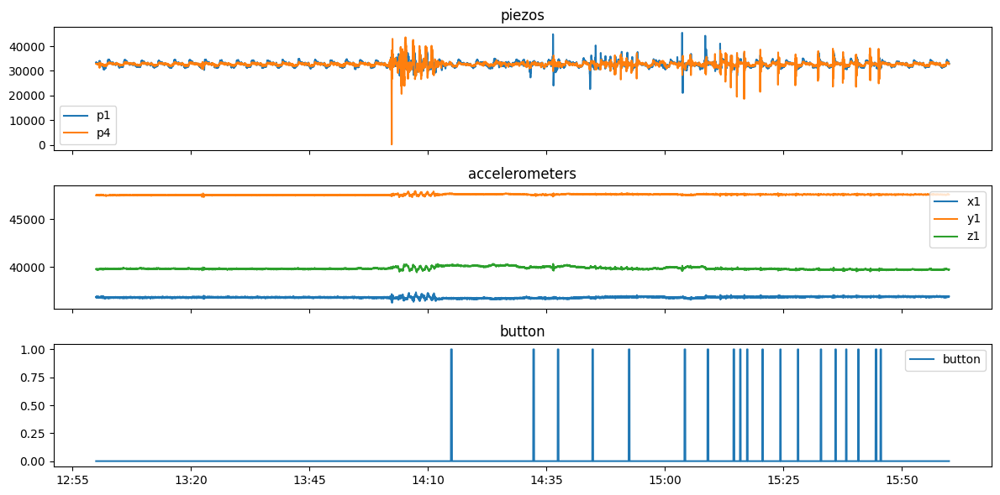

In [ ]:
# Example of plotting sensor data
fig  = plot_sensor_data(sensor_data.loc["DC:54:75:C0:E8:30/log_2024_04_25_10_22_12"],xlim = (13,16),hop_size=10)

In [ ]:
# Extract all maternal button-press sessions, defined as < 40 minute sessions

all_supervised_sessions = df_logfiles[df_logfiles["duration"]<pd.Timedelta(minutes=40)]

# Extract only maternal button-press sessions performed under controlled conditions (in hospital)

hospital_sessions  = all_supervised_sessions[all_supervised_sessions["hospital_session"]]

print(f"No. maternal button-press sessions (total): {all_supervised_sessions.shape[0]}")
print(f"No. hospital-based maternal button-press sessions (total): {hospital_sessions.shape[0]}")

No. maternal button-press sessions (total): 350
No. hospital-based maternal button-press sessions (total): 70


The FeMo1 trial tested three variants of fevices, labelled A, B, C. Each variant had a different combination of piezo sensors as follows:

| Variant | p1 | p2 | p3 | p4 |
|---|---|---|---|---|
|A| Large Piezo| Small Piezo| Small Piezo| Large Piezo|
|B| Small Piezo| Contact Mic| Contact Mic| Small Piezo|
|C| Large Piezo| Contact Mic| Contact Mic| Large Piezo|

To restrict the analysis to just Large piezos (likely the best performing), filter out only 'p1' and 'p4' channels from logfiles from variants A and C.

In [ ]:
df_hospital_logfiles_batch_1 = pd.read_parquet("/content/drive/MyDrive/YEAR_4/Project/femo1data/hosp_logfiles/hosp_p1p4acc1_sensor_data_batch_1.parquet")
df_hospital_logfiles_batch_1.head()

piezos         \
                                                                p1     p4   
s3key                                     measurement_index                 
DC:54:75:C0:E8:30/log_2024_05_08_12_38_16 0                  31342  23865   
                                          1                  31278  23836   
                                          2                  31066  23879   
                                          3                  31272  23978   
                                          4                  31749  24234   

                                                            accelerometers  \
                                                                        x1   
s3key                                     measurement_index                  
DC:54:75:C0:E8:30/log_2024_05_08_12_38_16 0                        35349.0   
                                          1                            NaN   
                                          2                            NaN   
                                          3                            NaN   
                                          4                        35319.0   

                                                                               \
                                                                  y1       z1   
s3key                                     measurement_index                     
DC:54:75:C0:E8:30/log_2024_05_08_12_38_16 0                  46124.0  39336.0   
                                          1                      NaN      NaN   
                                          2                      NaN      NaN   
                                          3                      NaN      NaN   
                                          4                  46196.0  39306.0   

                                                            button  
                                                            button  
s3key                                     measurement_index         
DC:54:75:C0:E8:30/log_2024_05_08_12_38_16 0                      0  
                                          1                      0  
                                          2                      0  
                                          3                      0  
                                          4                      0

In [ ]:
df_hospital_logfiles_batch_2 = pd.read_parquet("/content/drive/MyDrive/YEAR_4/Project/femo1data/hosp_logfiles/hosp_p1p4acc1_sensor_data_batch_2.parquet")
df_hospital_logfiles_batch_2.head()

piezos         \
                                                                p1     p4   
s3key                                     measurement_index                 
F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48 0                    122  31152   
                                          1                    112  30800   
                                          2                    150  30928   
                                          3                     40  31236   
                                          4                    109  30647   

                                                            accelerometers  \
                                                                        x1   
s3key                                     measurement_index                  
F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48 0                        39664.0   
                                          1                            NaN   
                                          2                            NaN   
                                          3                            NaN   
                                          4                        39548.0   

                                                                               \
                                                                  y1       z1   
s3key                                     measurement_index                     
F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48 0                  47557.0  37952.0   
                                          1                      NaN      NaN   
                                          2                      NaN      NaN   
                                          3                      NaN      NaN   
                                          4                  47561.0  37897.0   

                                                            button  
                                                            button  
s3key                                     measurement_index         
F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48 0                      0  
                                          1                      0  
                                          2                      0  
                                          3                      0  
                                          4                      0

In [ ]:
df_hospital_logfiles_batch_3 = pd.read_parquet("/content/drive/MyDrive/YEAR_4/Project/femo1data/hosp_logfiles/hosp_p1p4acc1_sensor_data_batch_3.parquet")
df_hospital_logfiles_batch_3.head()

piezos         \
                                                                p1     p4   
s3key                                     measurement_index                 
F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45 0                  19370  33899   
                                          1                  19836  34350   
                                          2                  20756  34551   
                                          3                  21503  35410   
                                          4                  21174  34437   

                                                            accelerometers  \
                                                                        x1   
s3key                                     measurement_index                  
F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45 0                        40930.0   
                                          1                            NaN   
                                          2                            NaN   
                                          3                            NaN   
                                          4                        40996.0   

                                                                               \
                                                                  y1       z1   
s3key                                     measurement_index                     
F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45 0                  47531.0  38447.0   
                                          1                      NaN      NaN   
                                          2                      NaN      NaN   
                                          3                      NaN      NaN   
                                          4                  47525.0  38447.0   

                                                            button  
                                                            button  
s3key                                     measurement_index         
F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45 0                      0  
                                          1                      0  
                                          2                      0  
                                          3                      0  
                                          4                      0

In [ ]:
df_hospital_logfiles_batch_4 = pd.read_parquet("/content/drive/MyDrive/YEAR_4/Project/femo1data/hosp_logfiles/hosp_p1p4acc1_sensor_data_batch_4.parquet")
df_hospital_logfiles_batch_4.head()

piezos         \
                                                                p1     p4   
s3key                                     measurement_index                 
F4:12:FA:8D:06:14/log_2024_05_09_14_47_25 0                  30143  32256   
                                          1                  30318  32679   
                                          2                  30503  33375   
                                          3                  30612  33421   
                                          4                  30676  33576   

                                                            accelerometers  \
                                                                        x1   
s3key                                     measurement_index                  
F4:12:FA:8D:06:14/log_2024_05_09_14_47_25 0                        41616.0   
                                          1                            NaN   
                                          2                            NaN   
                                          3                            NaN   
                                          4                        41608.0   

                                                                               \
                                                                  y1       z1   
s3key                                     measurement_index                     
F4:12:FA:8D:06:14/log_2024_05_09_14_47_25 0                  46807.0  37005.0   
                                          1                      NaN      NaN   
                                          2                      NaN      NaN   
                                          3                      NaN      NaN   
                                          4                  46869.0  36989.0   

                                                            button  
                                                            button  
s3key                                     measurement_index         
F4:12:FA:8D:06:14/log_2024_05_09_14_47_25 0                      0  
                                          1                      0  
                                          2                      0  
                                          3                      0  
                                          4                      0

In [ ]:
df_hospital_logfiles_batch_5 = pd.read_parquet("/content/drive/MyDrive/YEAR_4/Project/femo1data/hosp_logfiles/hosp_p1p4acc1_sensor_data_batch_5.parquet")
df_hospital_logfiles_batch_5.head()

piezos         \
                                                                p1     p4   
s3key                                     measurement_index                 
F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50 0                  30031  30432   
                                          1                  30025  30292   
                                          2                  30105  30174   
                                          3                  30227  30150   
                                          4                  30432  29866   

                                                            accelerometers  \
                                                                        x1   
s3key                                     measurement_index                  
F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50 0                        39842.0   
                                          1                            NaN   
                                          2                            NaN   
                                          3                            NaN   
                                          4                        39789.0   

                                                                               \
                                                                  y1       z1   
s3key                                     measurement_index                     
F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50 0                  44820.0  36081.0   
                                          1                      NaN      NaN   
                                          2                      NaN      NaN   
                                          3                      NaN      NaN   
                                          4                  44835.0  36128.0   

                                                            button  
                                                            button  
s3key                                     measurement_index         
F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50 0                      0  
                                          1                      0  
                                          2                      0  
                                          3                      0  
                                          4                      0

In [ ]:
from IPython.display import display, HTML

# ... (rest of your existing code) ...

display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 1&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 12-15 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_1.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_1.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(12, 15), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot

    # Save the plot to a PNG file
    plt.savefig(f"{s3key.replace('/', '_')}_batch_1_12-15min.png")

    plt.show()  # Display the plot

# ... (similar modifications for other batches and time periods) ...



Session ID: DC:54:75:C0:E8:30/log_2024_05_08_12_38_16


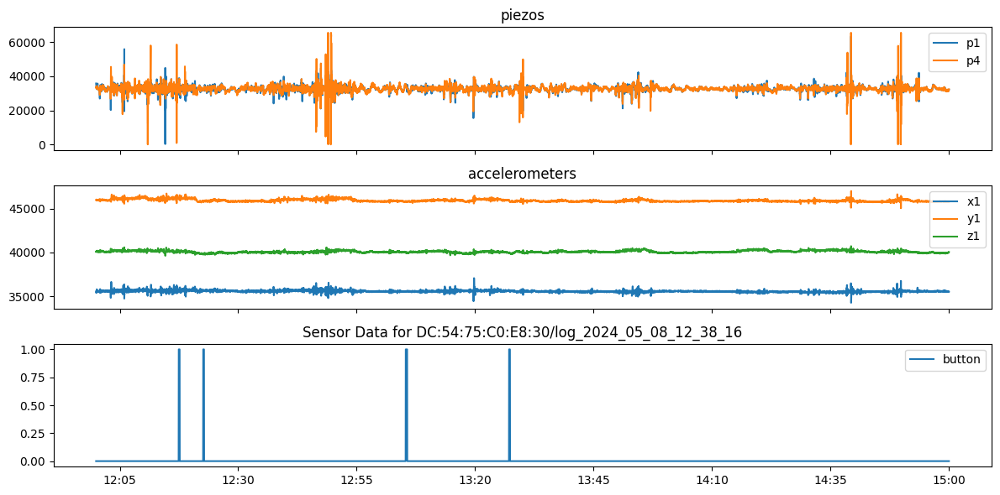



Session ID: DC:54:75:C2:21:6C/log_2024_05_20_10_38_15.dat


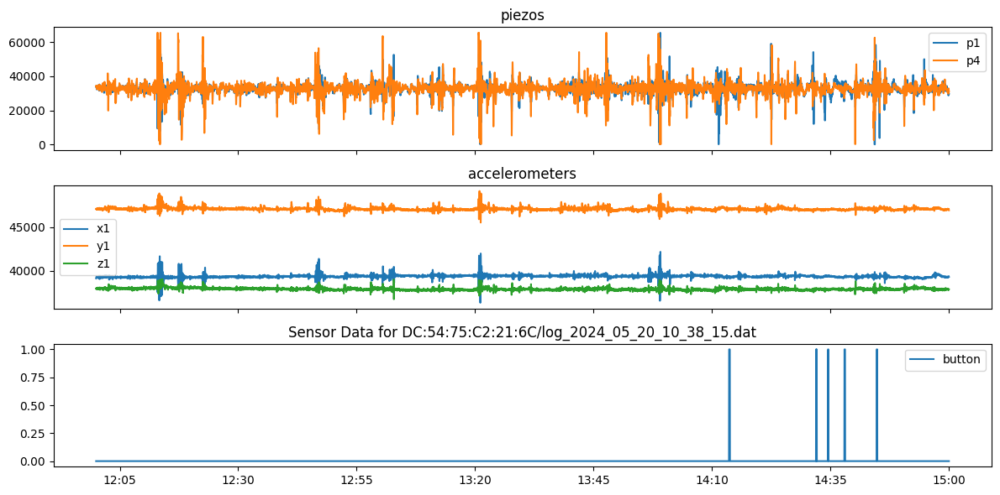



Session ID: DC:54:75:C2:21:6C/log_2024_06_11_11_49_40.dat


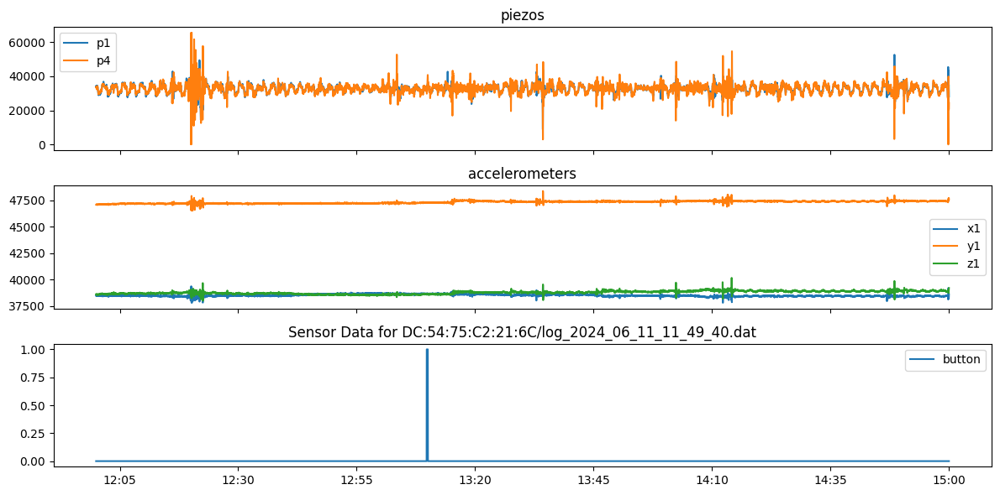



Session ID: DC:54:75:C2:21:A0/log_2024_04_24_14_14_07.dat


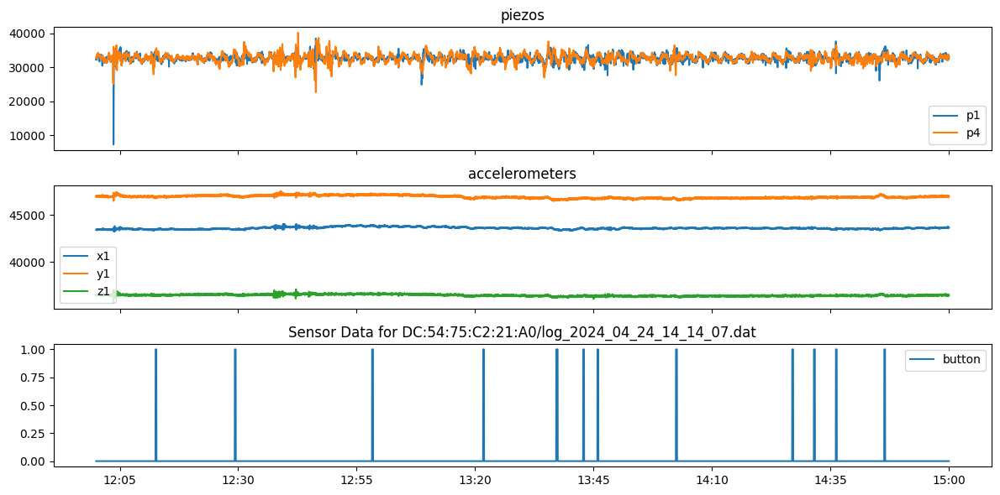



Session ID: DC:54:75:C2:21:D8/log_2024_04_10_12_56_10


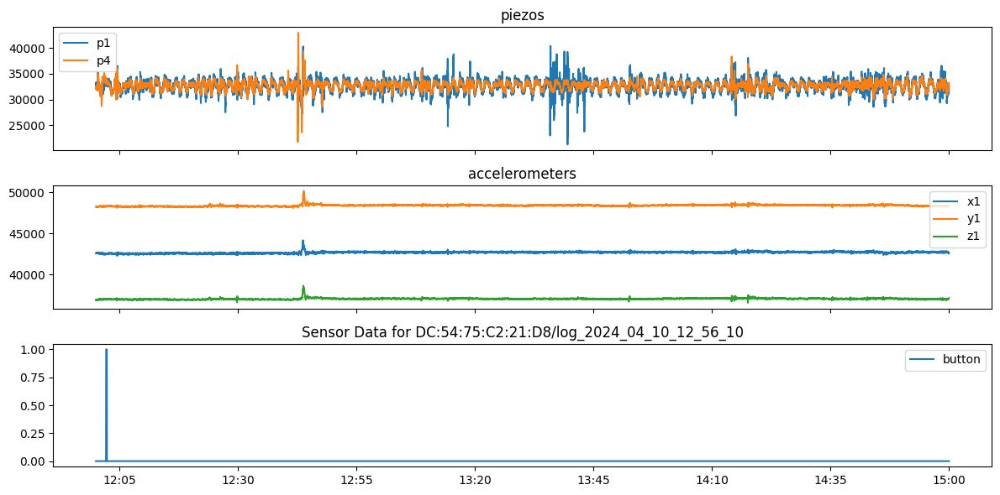



Session ID: DC:54:75:C2:21:D8/log_2024_04_24_11_37_15.dat


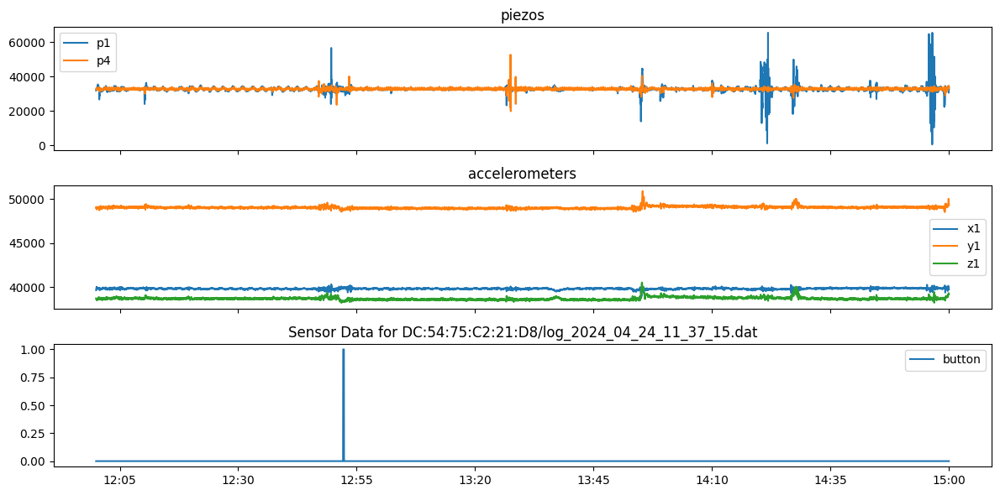



Session ID: DC:54:75:C2:22:4C/log_2024_04_25_14_15_27


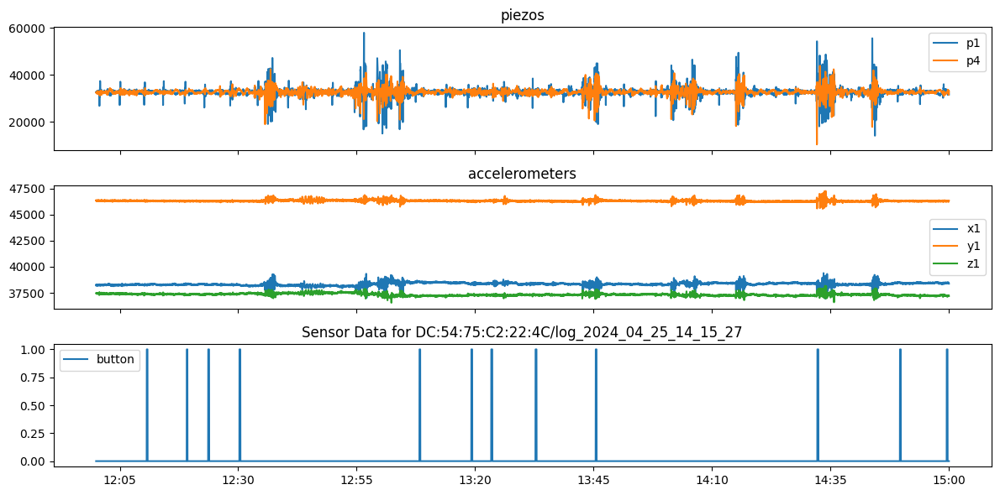



Session ID: DC:54:75:C2:22:4C/log_2024_05_09_14_08_26


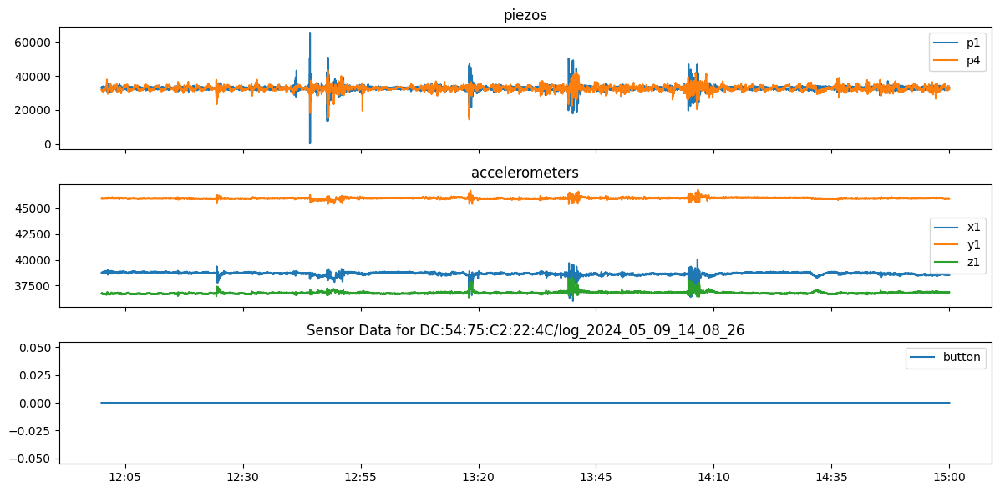



Session ID: DC:54:75:C2:23:28/log_2024_04_11_10_10_34


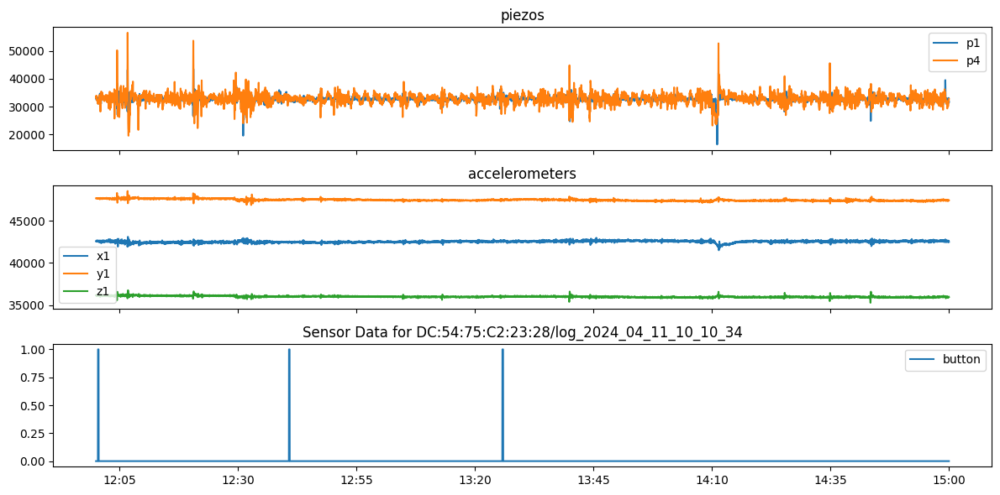



Session ID: DC:54:75:C2:23:28/log_2024_04_22_09_28_42


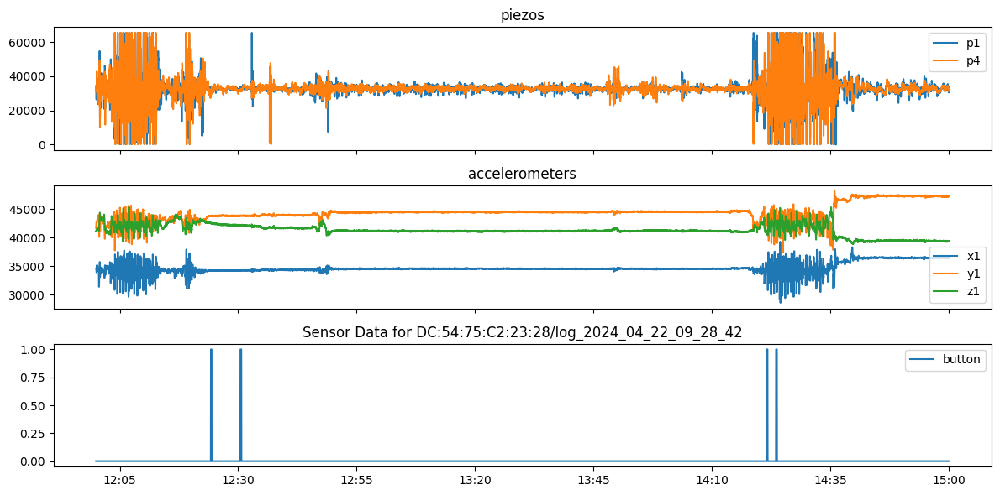

In [ ]:
from IPython.display import display, HTML

display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 1&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 12-15 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_1.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_1.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(12, 15), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: DC:54:75:C0:E8:30/log_2024_05_08_12_38_16


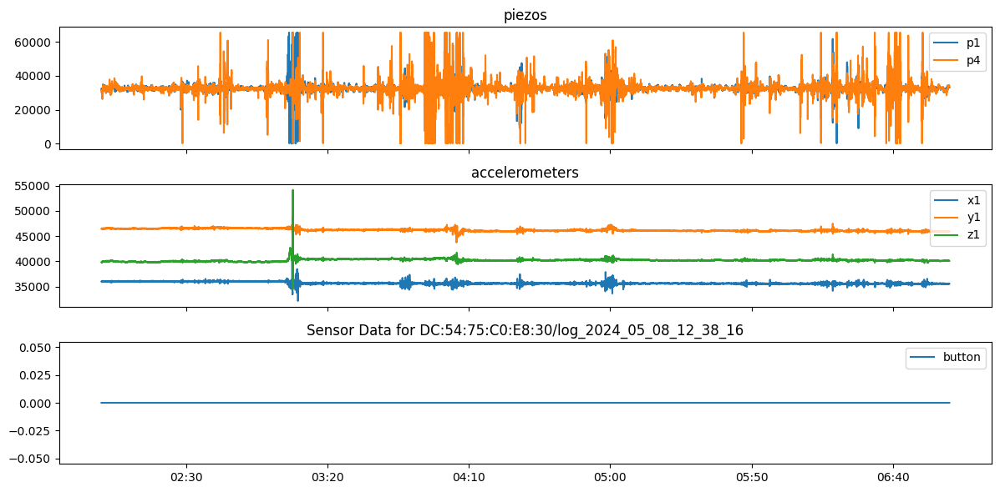



Session ID: DC:54:75:C2:21:6C/log_2024_05_20_10_38_15.dat


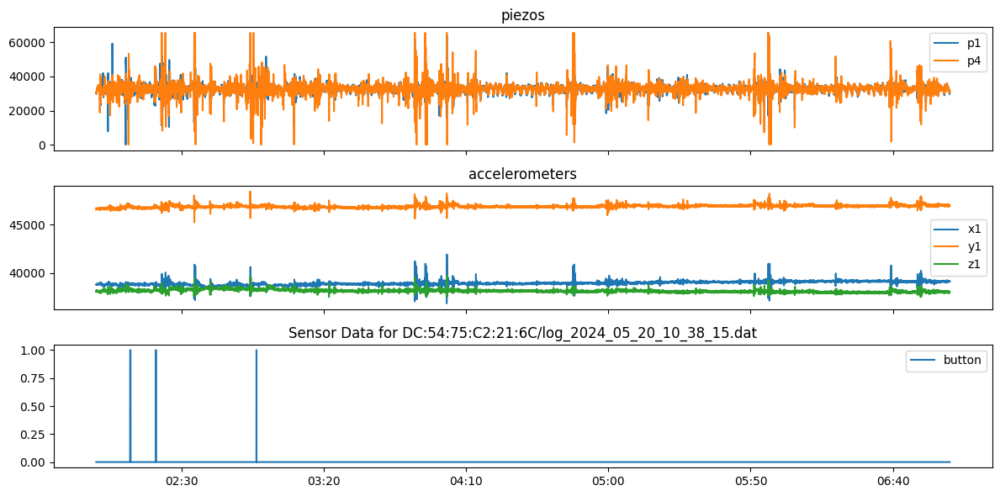



Session ID: DC:54:75:C2:21:6C/log_2024_06_11_11_49_40.dat


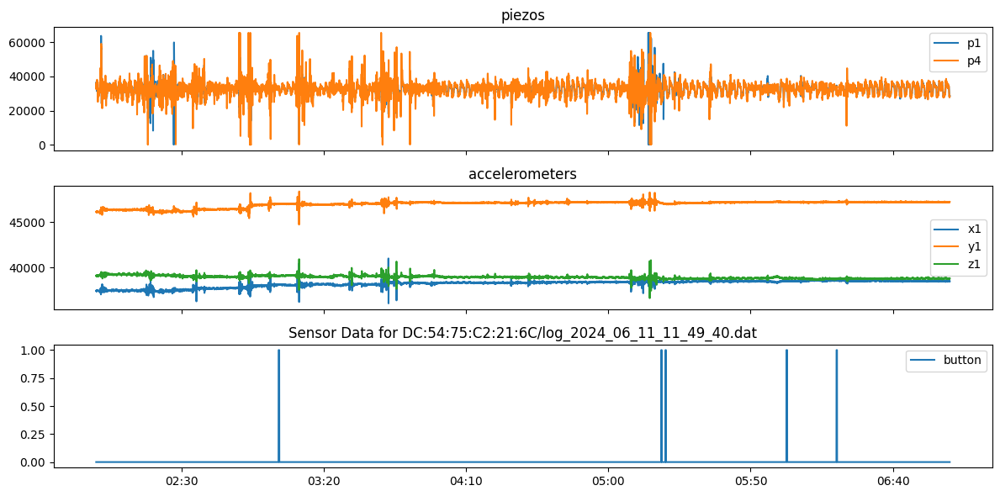



Session ID: DC:54:75:C2:21:A0/log_2024_04_24_14_14_07.dat


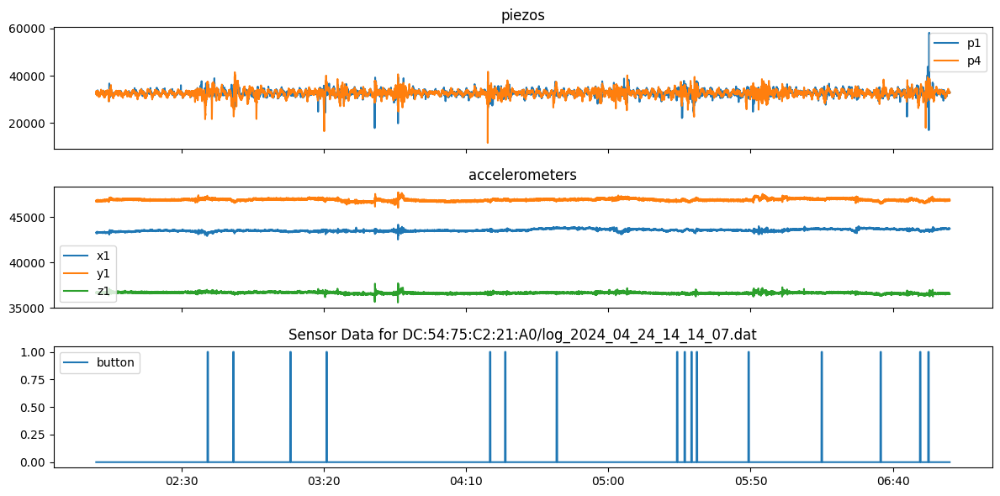



Session ID: DC:54:75:C2:21:D8/log_2024_04_10_12_56_10


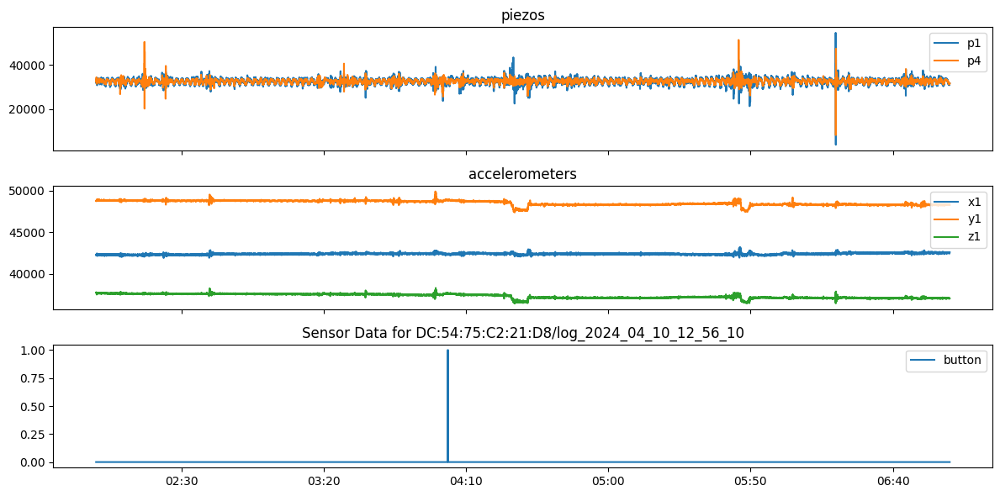



Session ID: DC:54:75:C2:21:D8/log_2024_04_24_11_37_15.dat


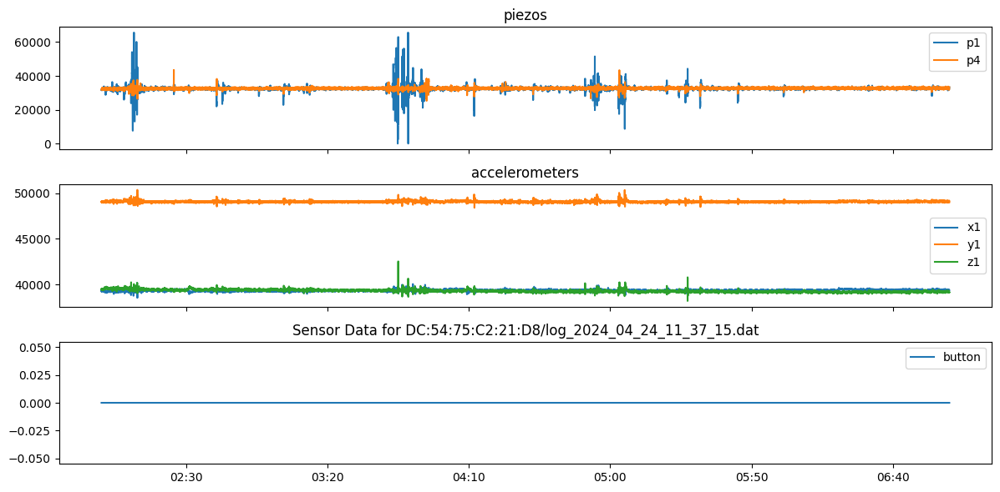



Session ID: DC:54:75:C2:22:4C/log_2024_04_25_14_15_27


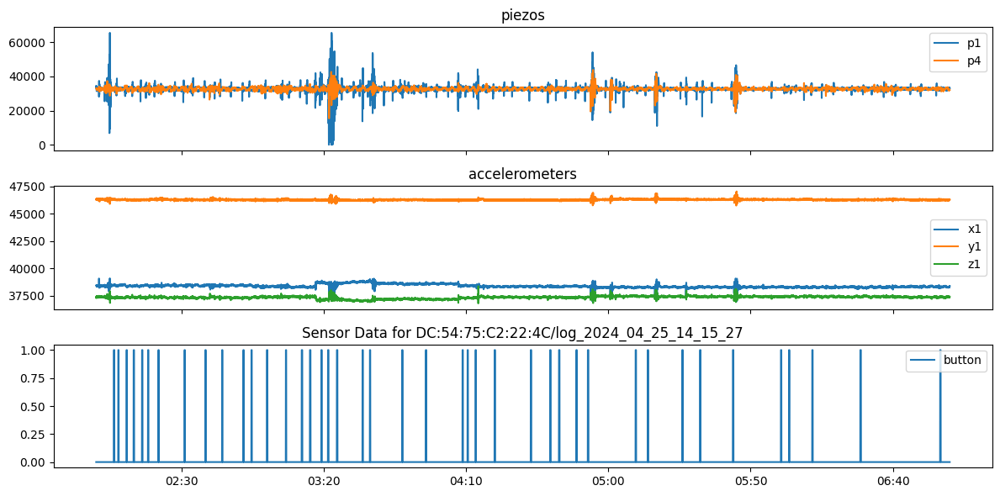



Session ID: DC:54:75:C2:22:4C/log_2024_05_09_14_08_26


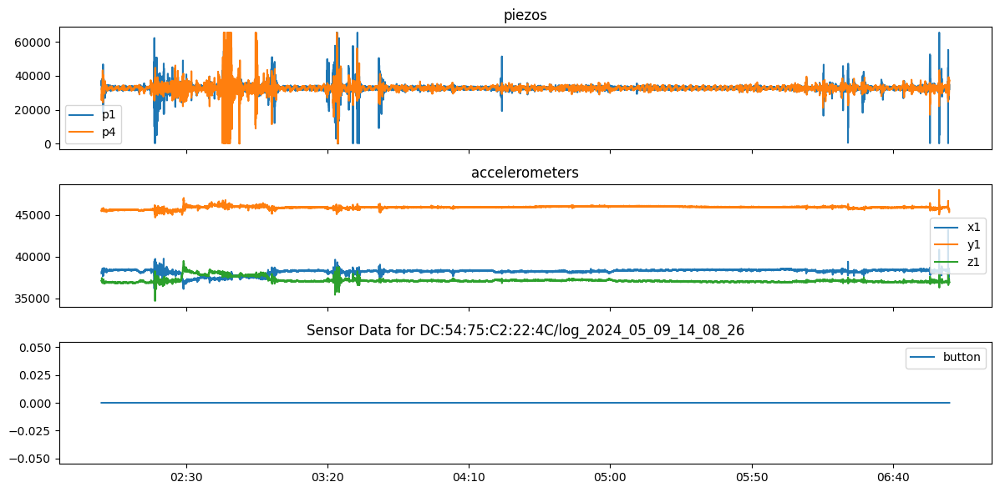



Session ID: DC:54:75:C2:23:28/log_2024_04_11_10_10_34


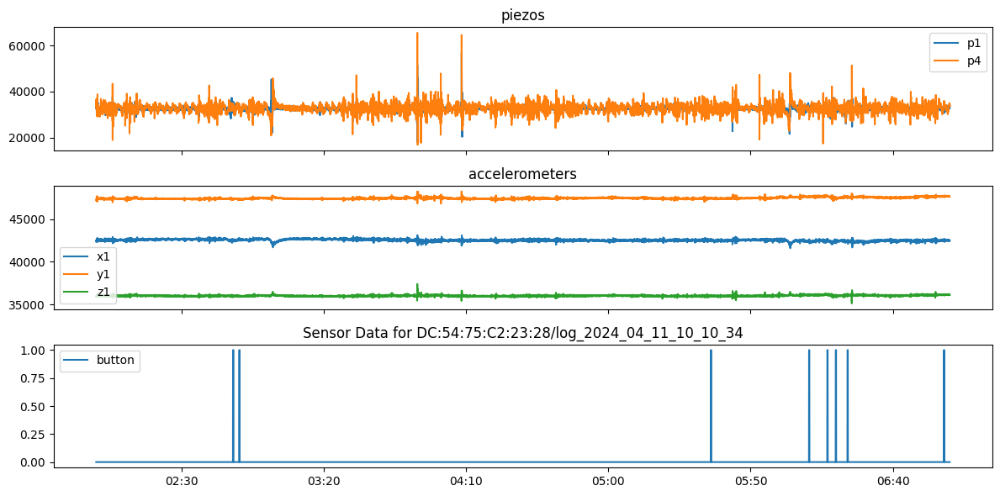



Session ID: DC:54:75:C2:23:28/log_2024_04_22_09_28_42


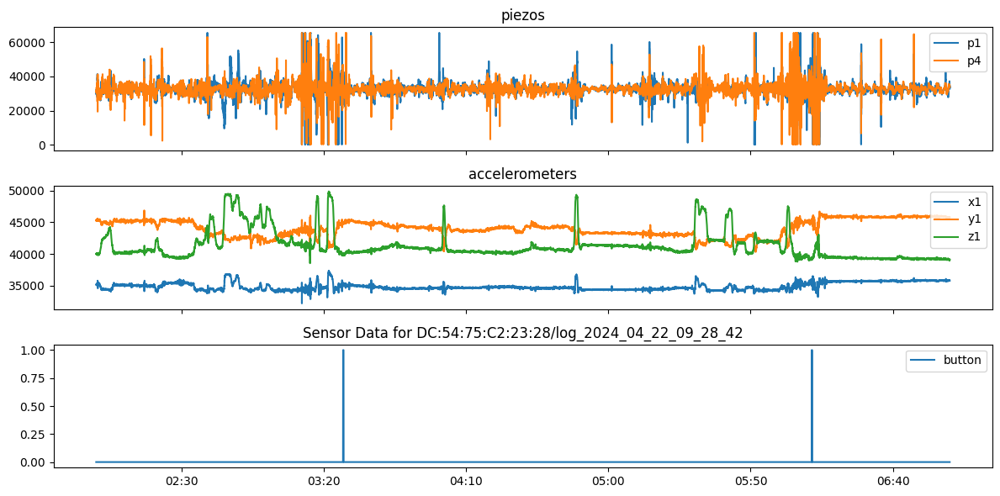

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 1&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-7 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_1.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_1.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 7), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: DC:54:75:C0:E8:30/log_2024_05_08_12_38_16


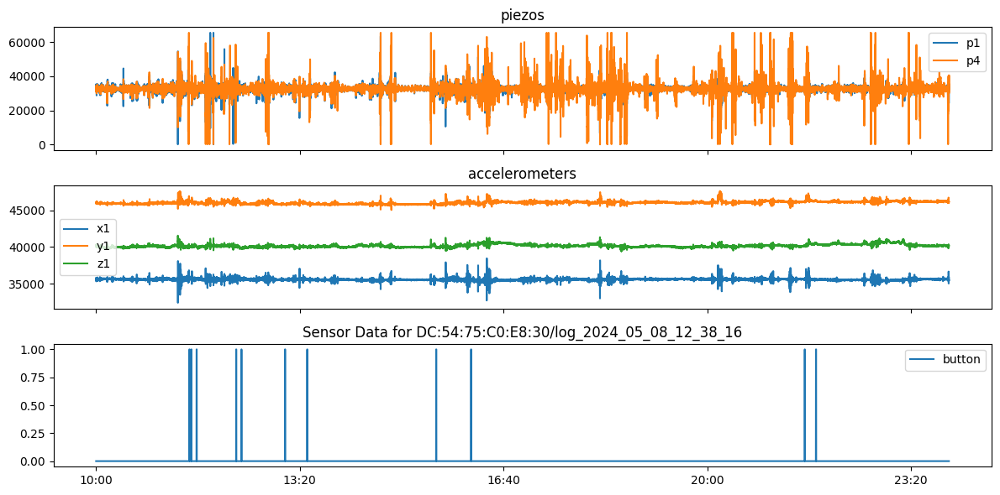



Session ID: DC:54:75:C2:21:6C/log_2024_05_20_10_38_15.dat


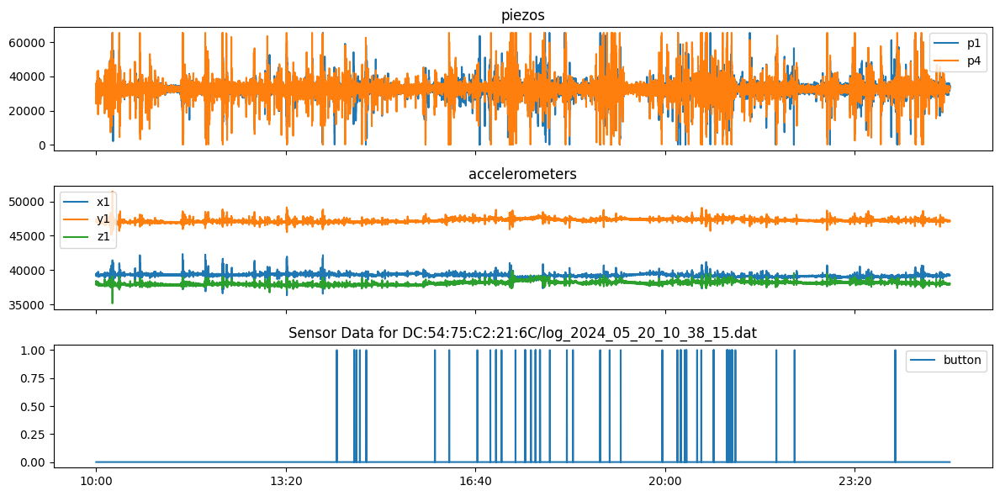



Session ID: DC:54:75:C2:21:6C/log_2024_06_11_11_49_40.dat


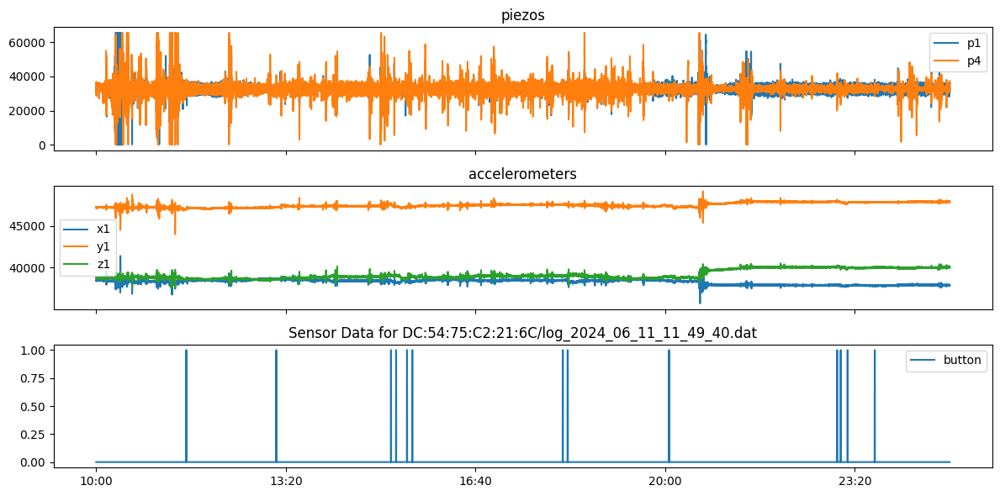



Session ID: DC:54:75:C2:21:A0/log_2024_04_24_14_14_07.dat


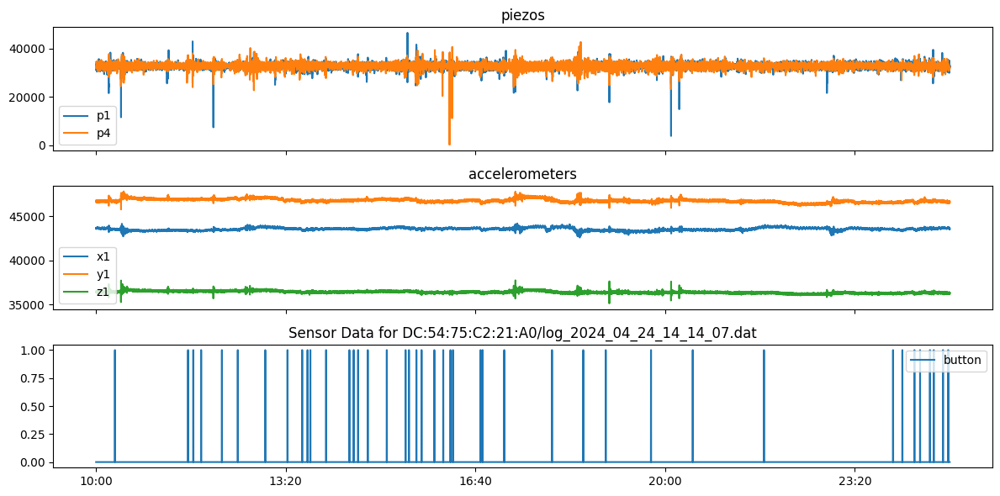



Session ID: DC:54:75:C2:21:D8/log_2024_04_10_12_56_10


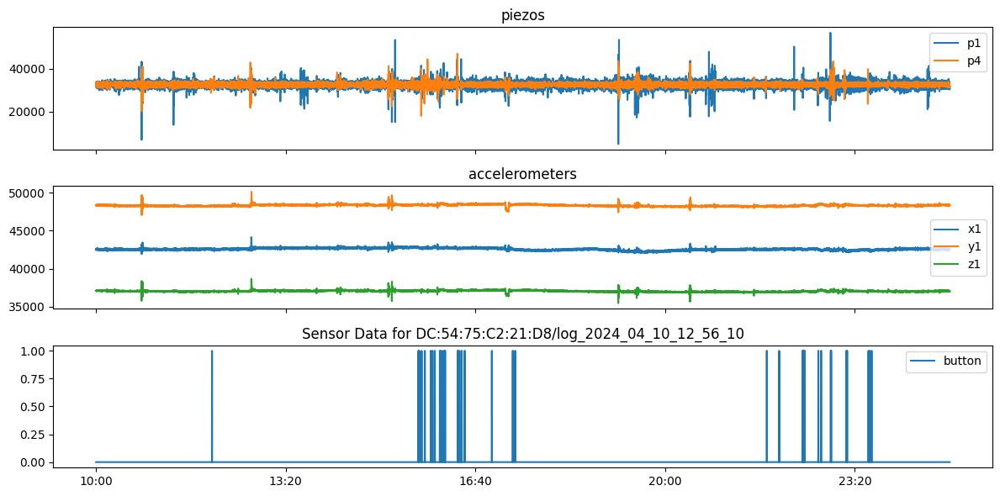



Session ID: DC:54:75:C2:21:D8/log_2024_04_24_11_37_15.dat


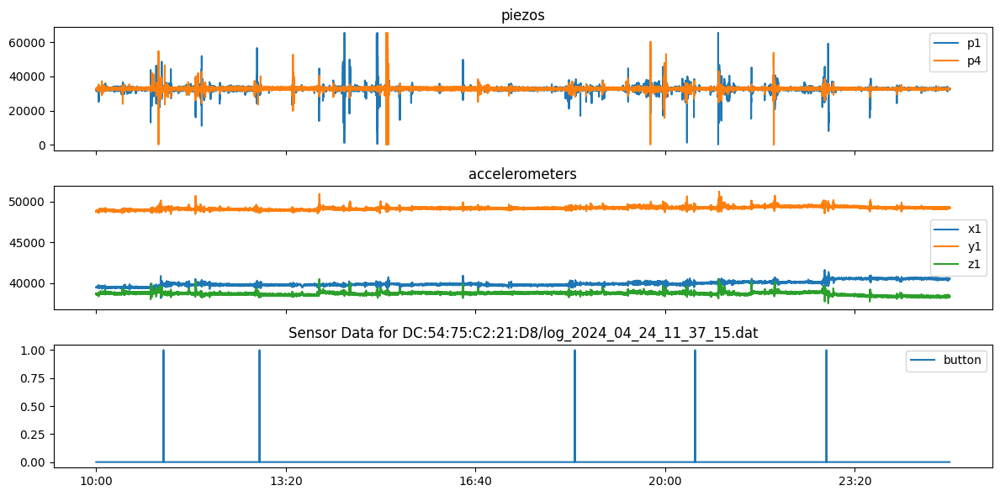



Session ID: DC:54:75:C2:22:4C/log_2024_04_25_14_15_27


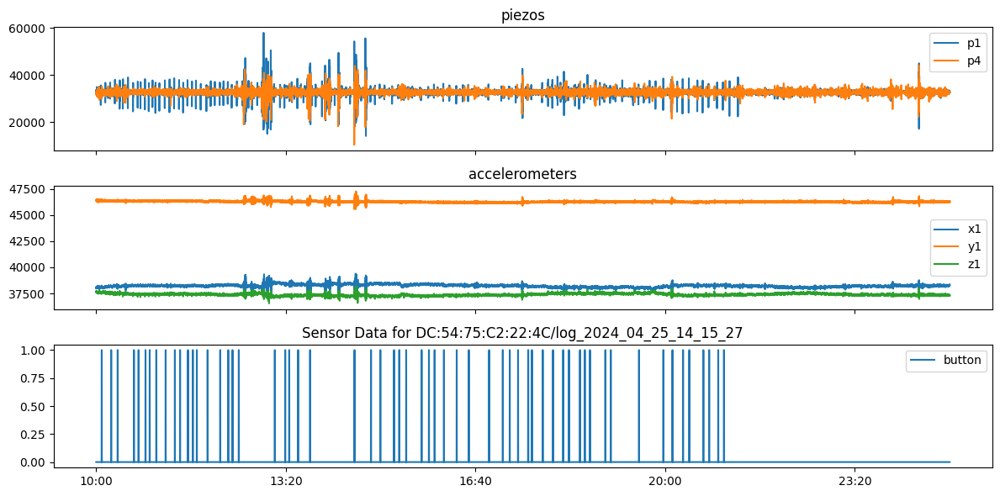



Session ID: DC:54:75:C2:22:4C/log_2024_05_09_14_08_26


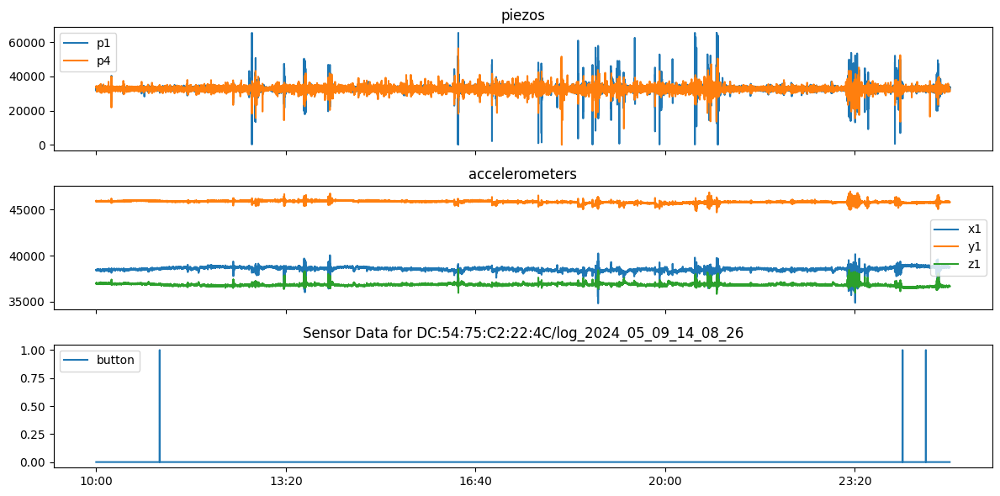



Session ID: DC:54:75:C2:23:28/log_2024_04_11_10_10_34


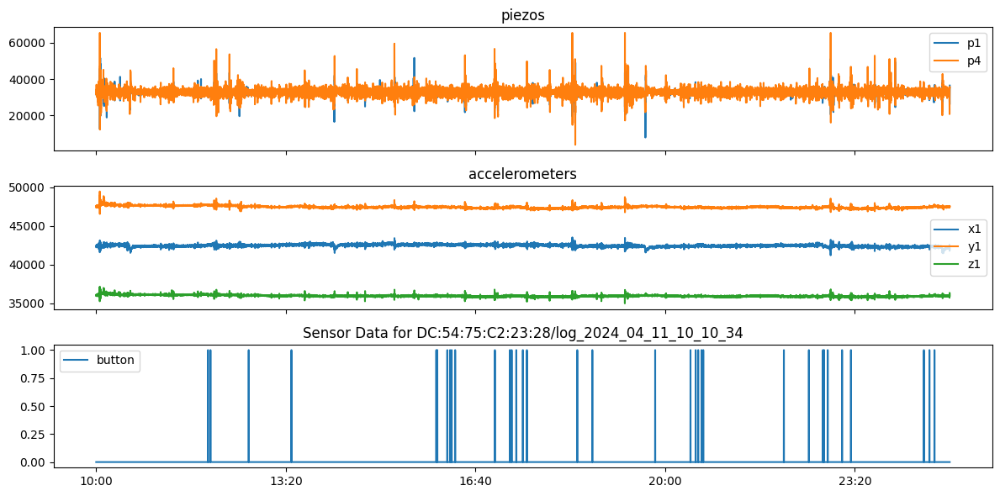



Session ID: DC:54:75:C2:23:28/log_2024_04_22_09_28_42


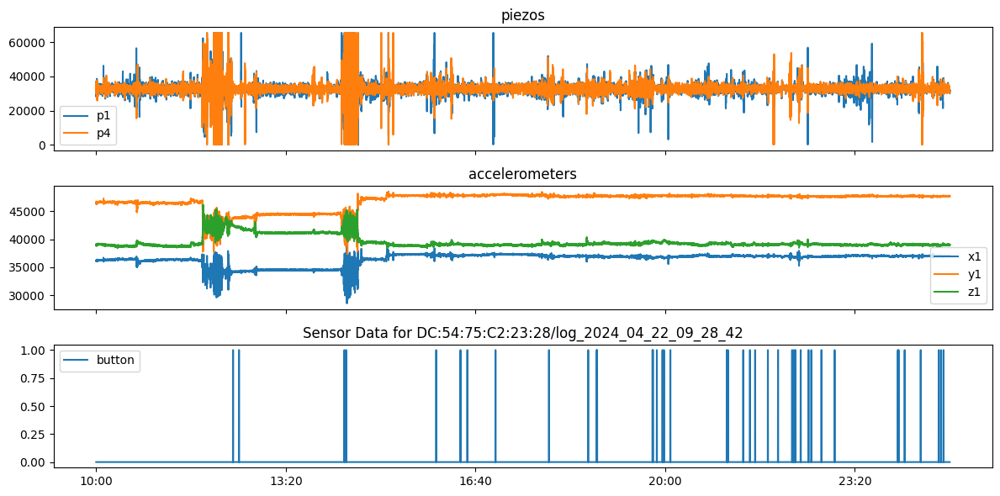

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 1&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 10-25 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_1.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_1.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(10, 25), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: DC:54:75:C0:E8:30/log_2024_05_08_12_38_16


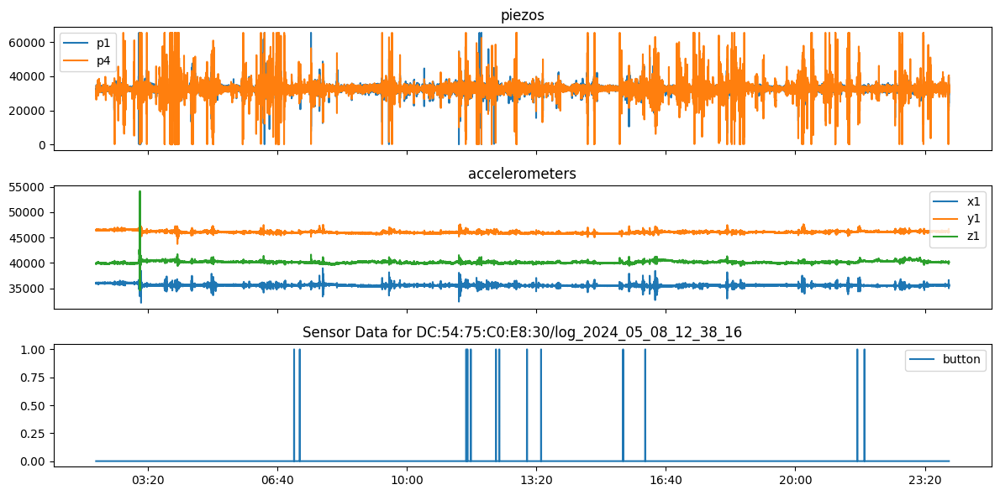



Session ID: DC:54:75:C2:21:6C/log_2024_05_20_10_38_15.dat


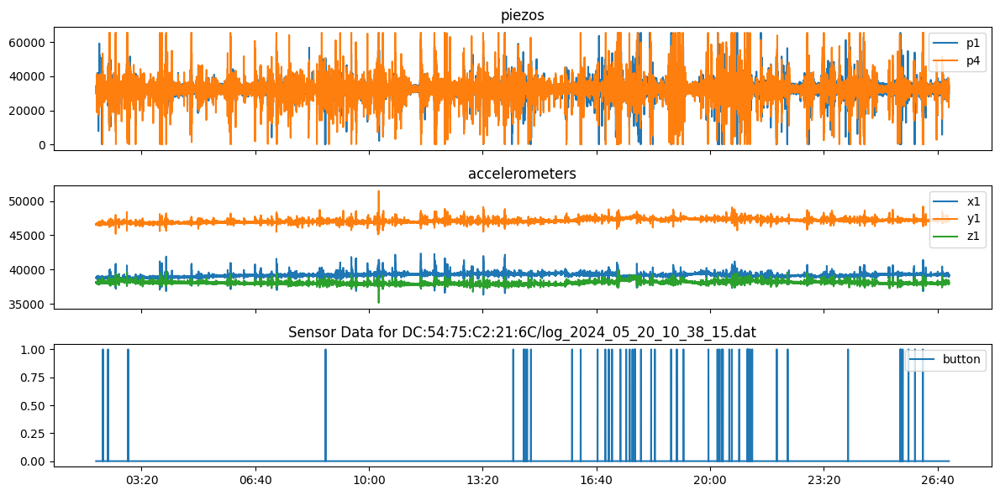



Session ID: DC:54:75:C2:21:6C/log_2024_06_11_11_49_40.dat


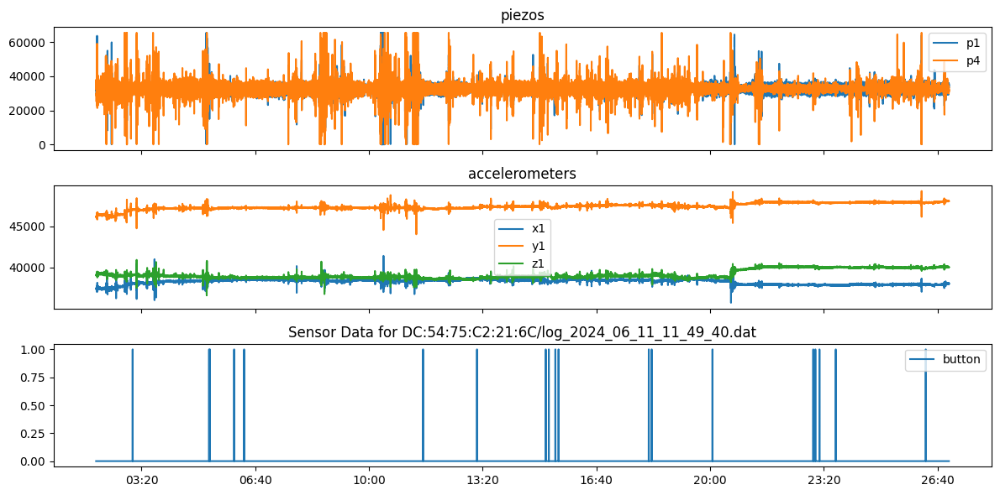



Session ID: DC:54:75:C2:21:A0/log_2024_04_24_14_14_07.dat


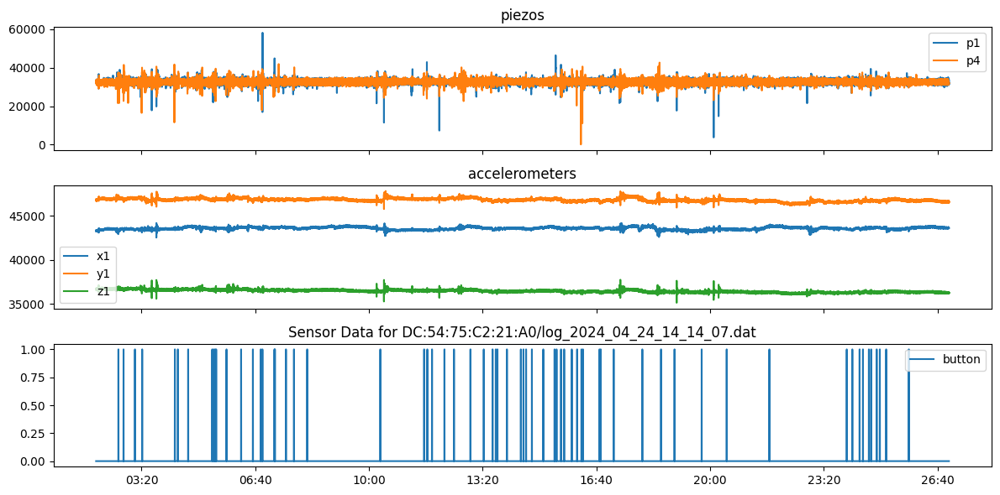



Session ID: DC:54:75:C2:21:D8/log_2024_04_10_12_56_10


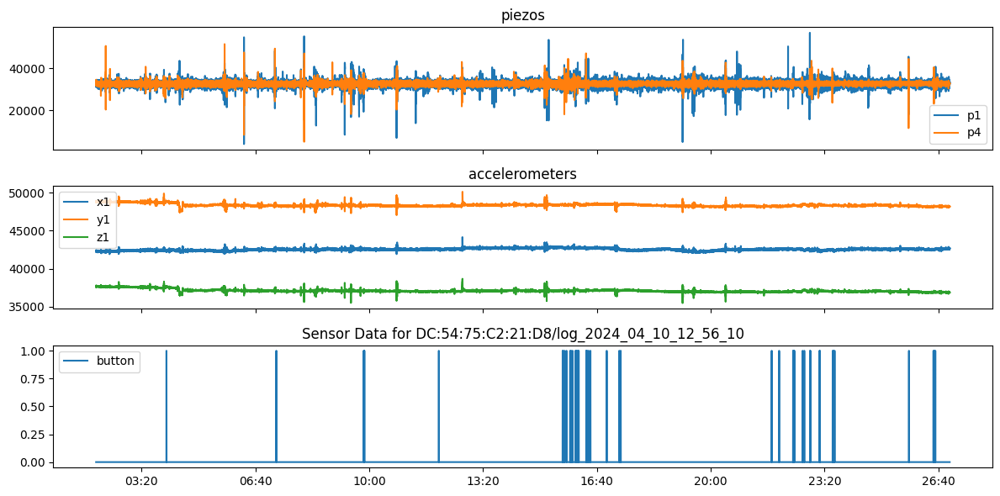



Session ID: DC:54:75:C2:21:D8/log_2024_04_24_11_37_15.dat


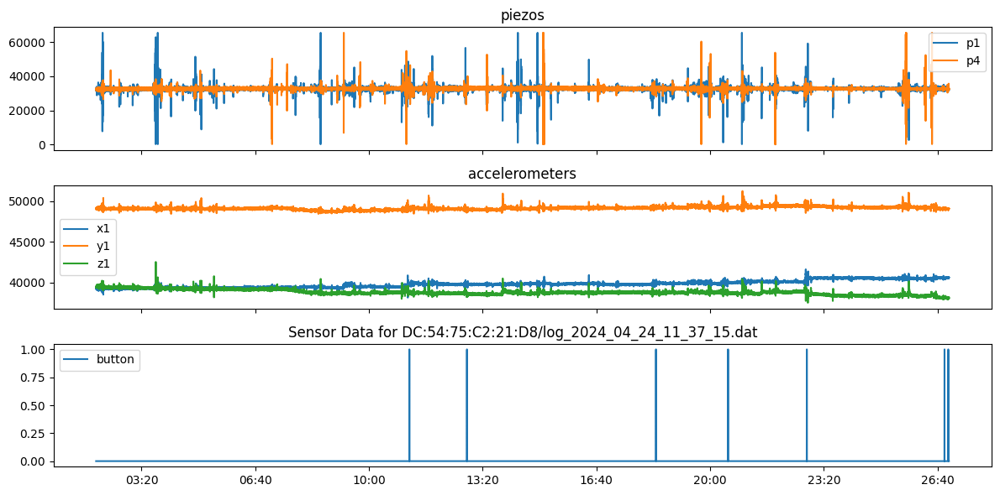



Session ID: DC:54:75:C2:22:4C/log_2024_04_25_14_15_27


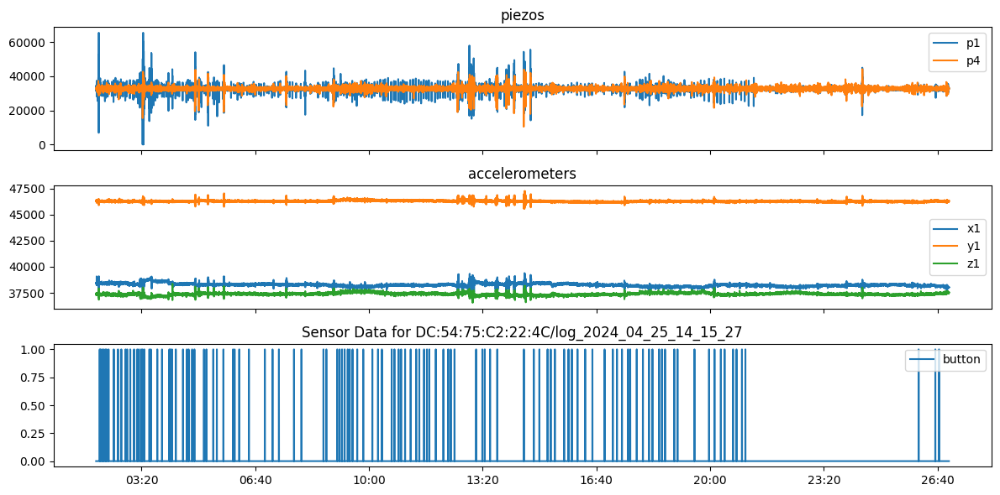



Session ID: DC:54:75:C2:22:4C/log_2024_05_09_14_08_26


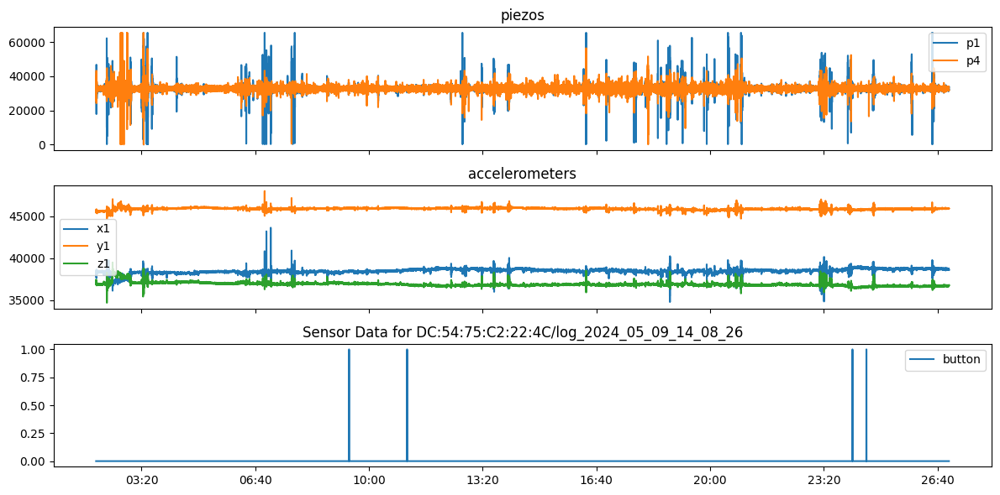



Session ID: DC:54:75:C2:23:28/log_2024_04_11_10_10_34


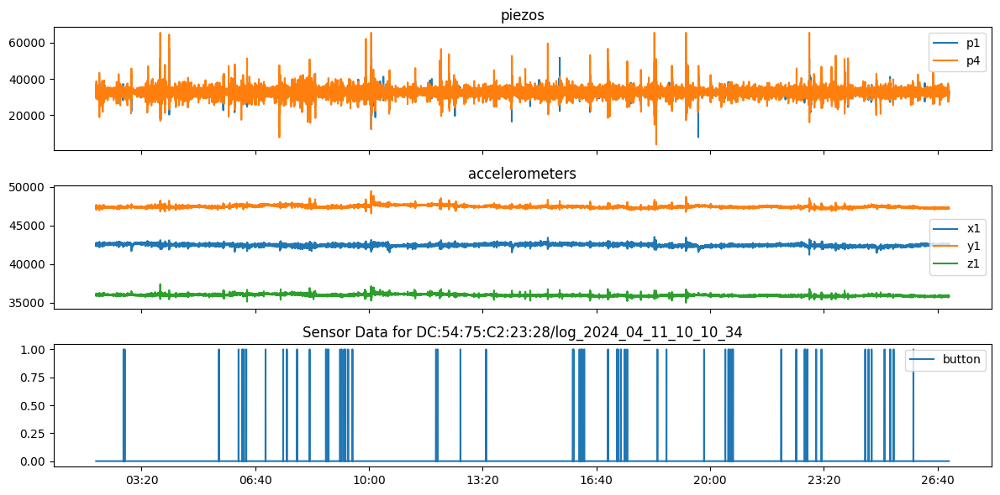



Session ID: DC:54:75:C2:23:28/log_2024_04_22_09_28_42


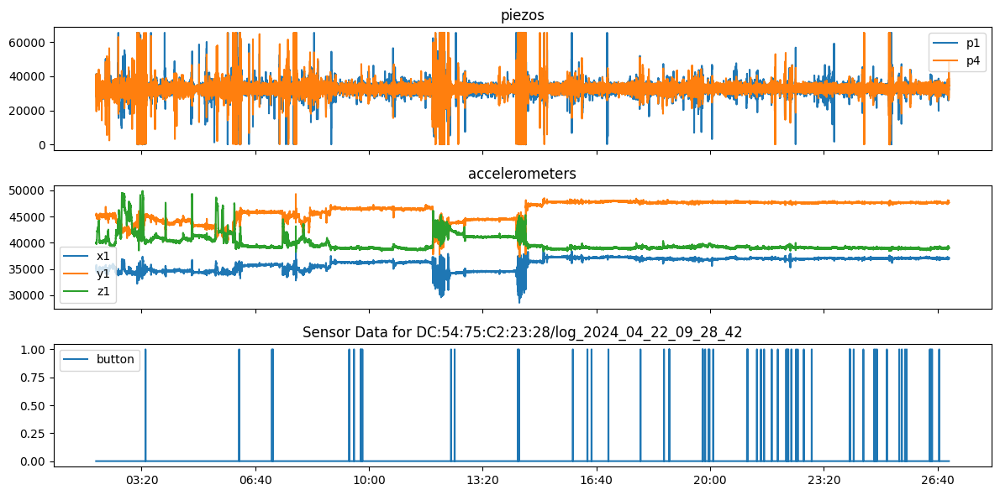

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 1&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-27 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_1.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_1.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 27), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48


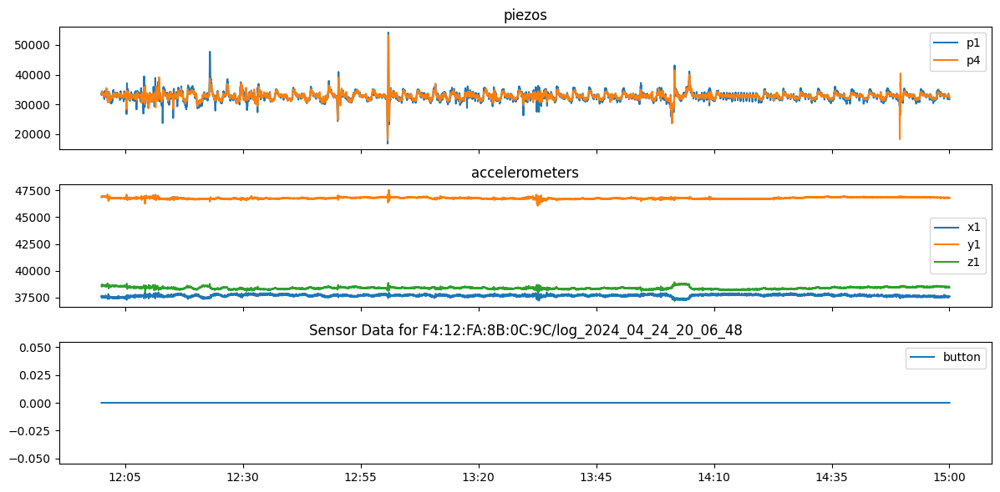



Session ID: F4:12:FA:8B:0D:08/log_2024_05_15_14_04_17


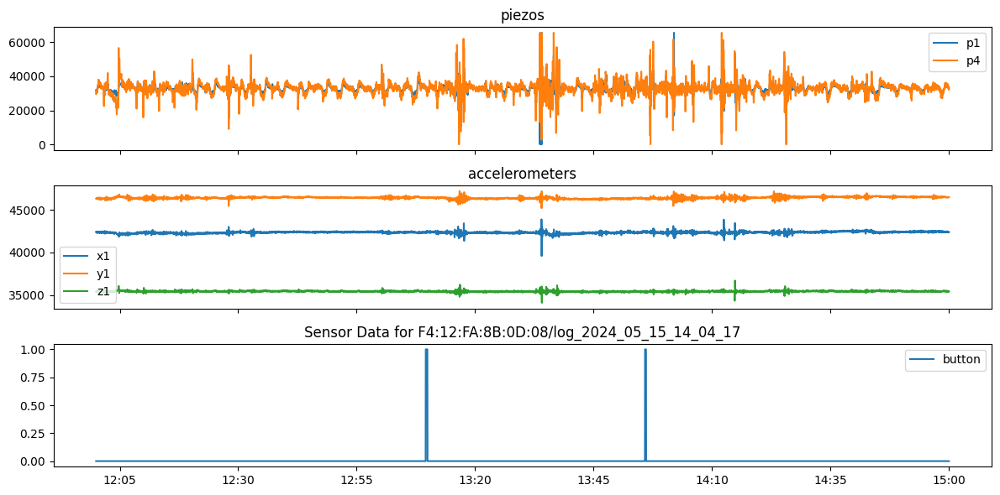



Session ID: F4:12:FA:8B:0D:08/log_2024_05_29_12_54_11.dat


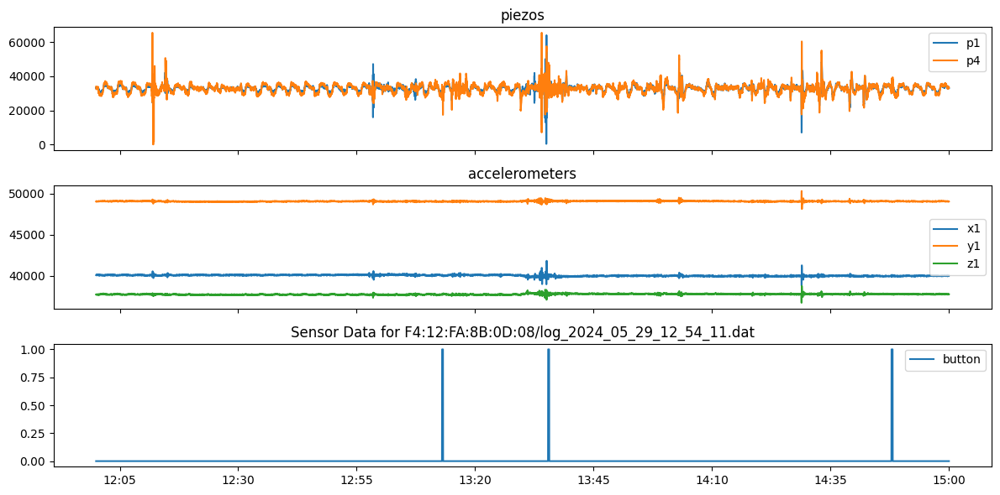



Session ID: F4:12:FA:8B:1A:18/log_2024_06_05_10_34_09


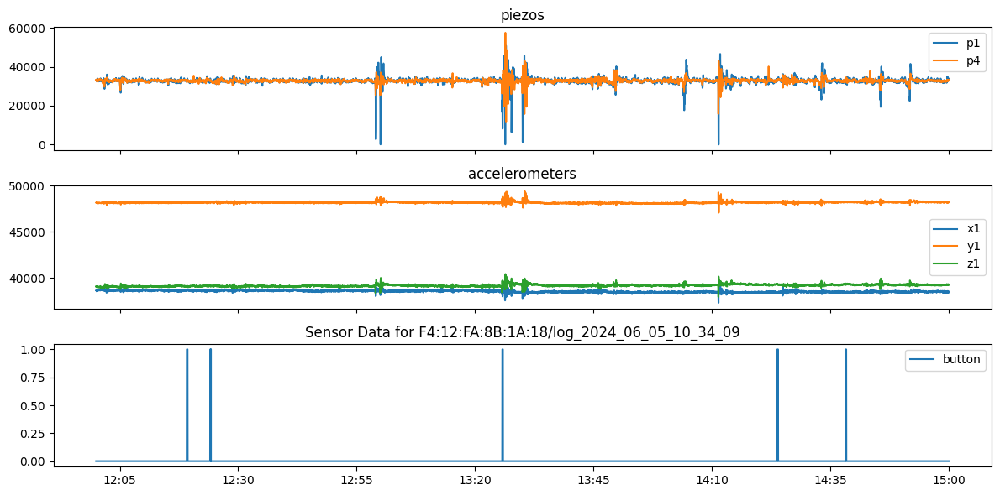



Session ID: F4:12:FA:8B:1A:18/log_2024_06_18_11_36_44.dat


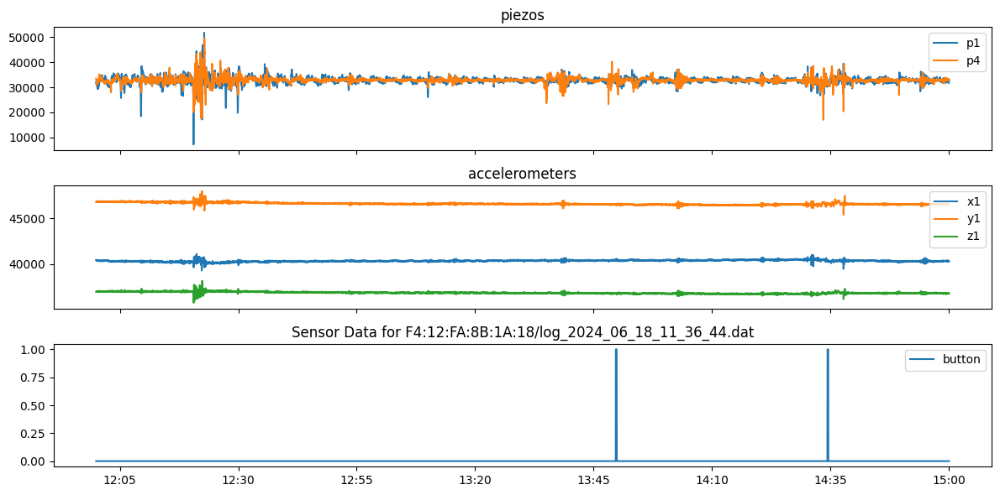



Session ID: F4:12:FA:8B:1B:C0/log_2024_04_25_12_48_51


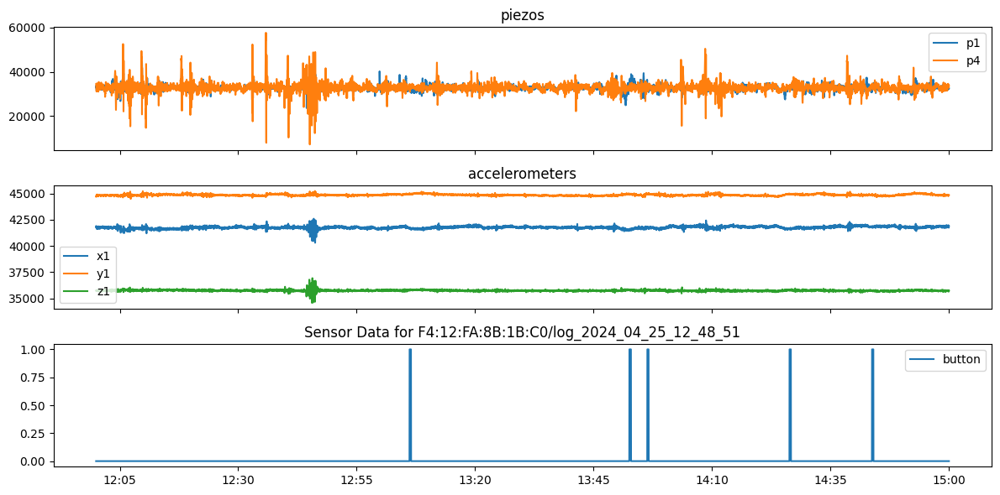



Session ID: F4:12:FA:8B:1B:C0/log_2024_05_09_13_31_59.dat


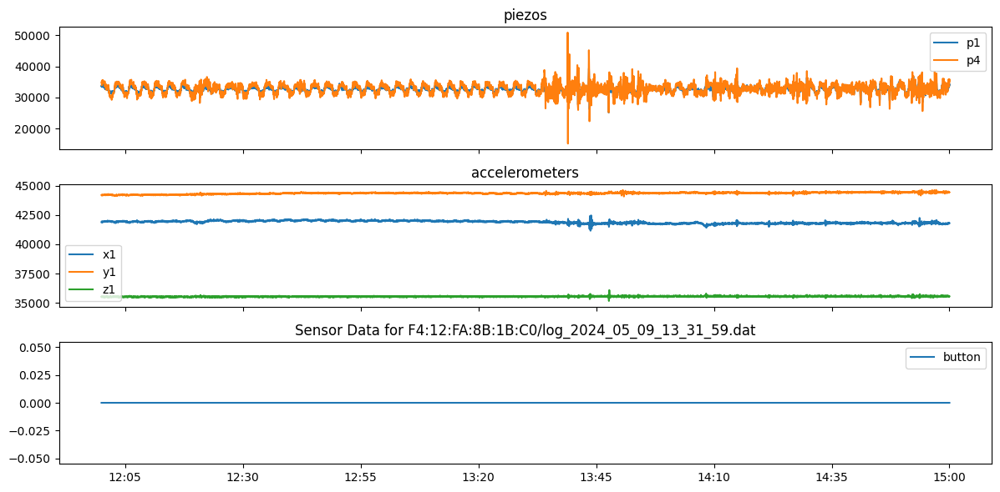



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_03_10_15_43


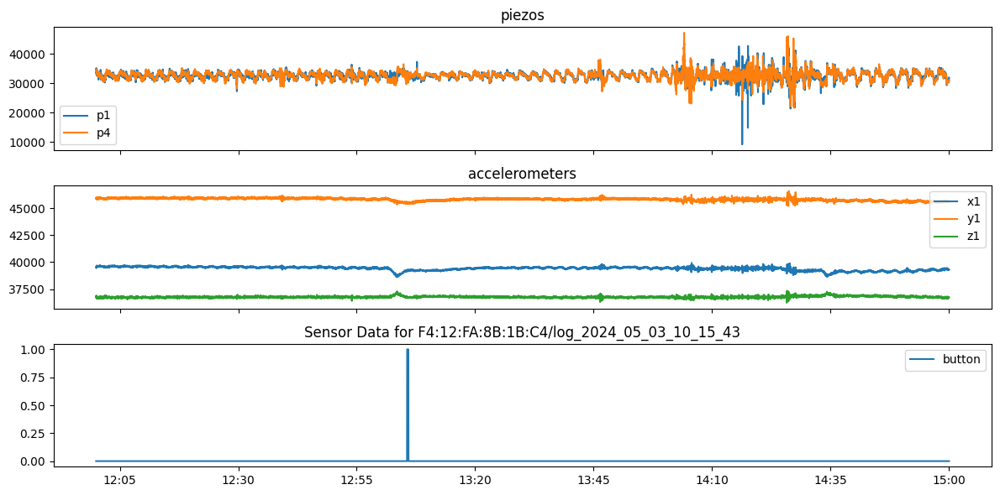



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_13_12_15_22


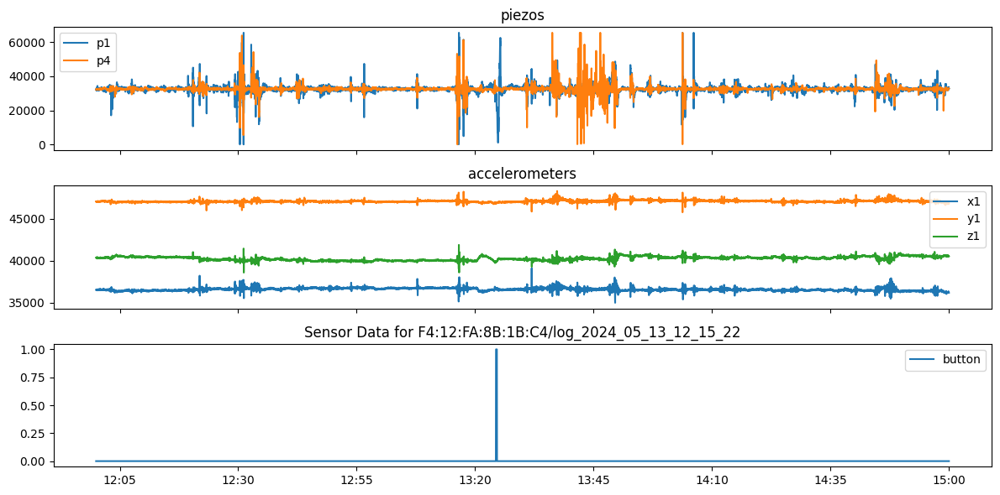



Session ID: F4:12:FA:8B:1B:CC/log_2024_05_02_13_06_56.dat


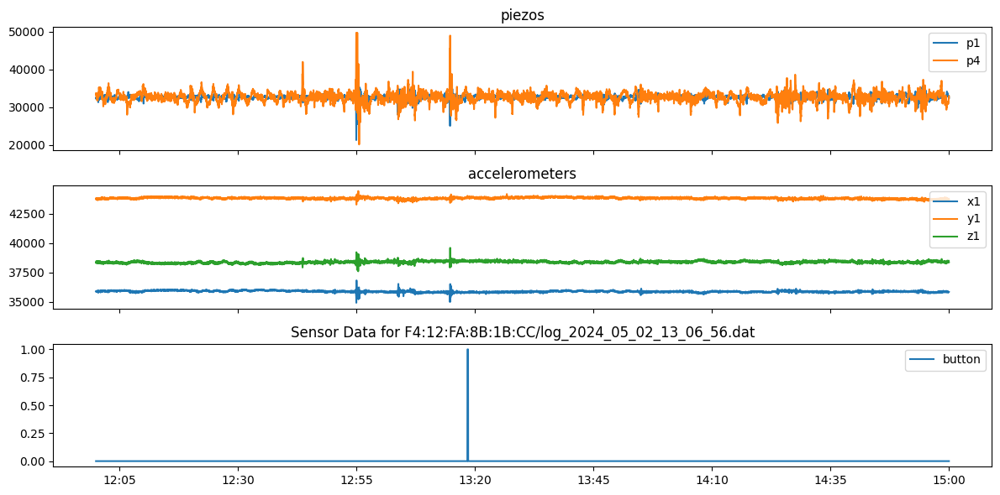

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 2&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 12-15 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_2.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_2.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(12, 15), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48


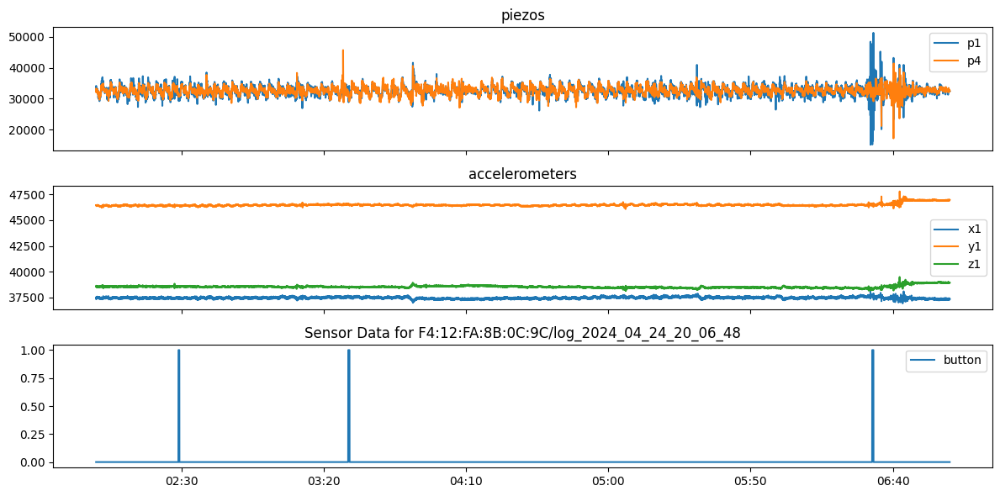



Session ID: F4:12:FA:8B:0D:08/log_2024_05_15_14_04_17


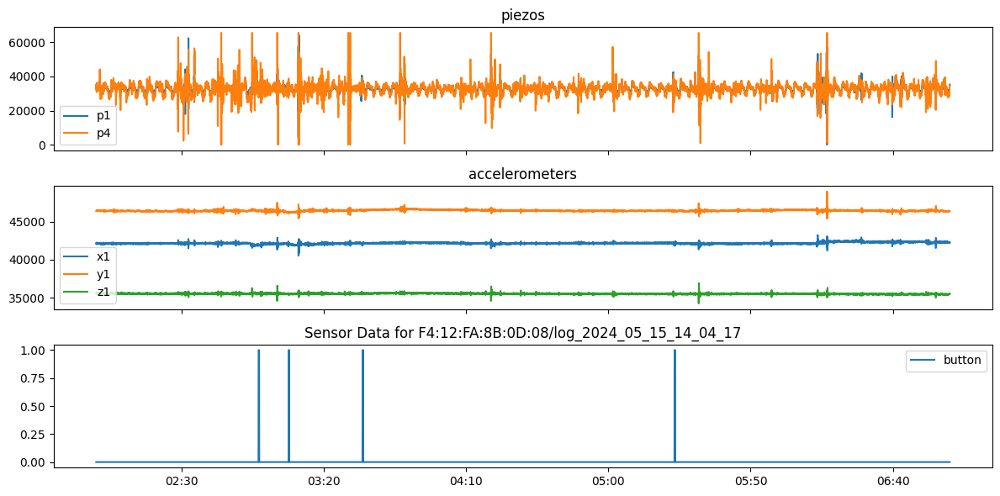



Session ID: F4:12:FA:8B:0D:08/log_2024_05_29_12_54_11.dat


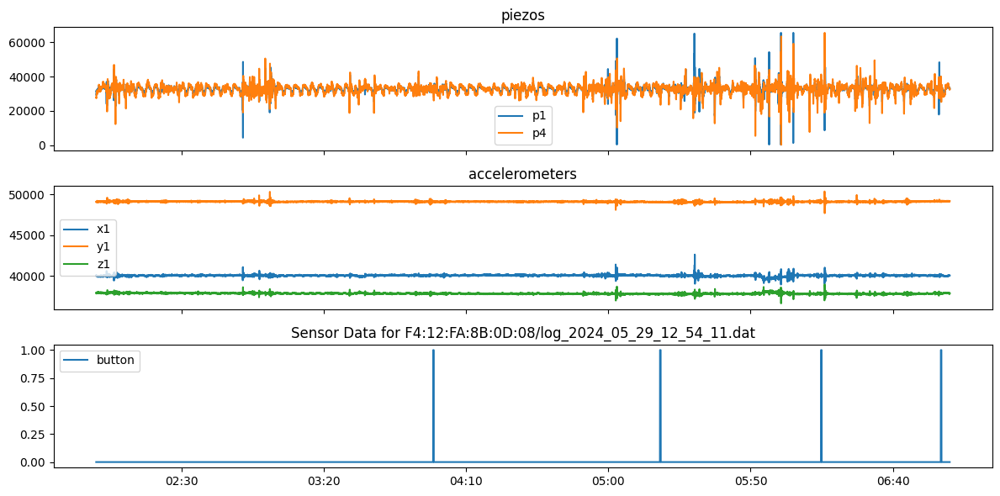



Session ID: F4:12:FA:8B:1A:18/log_2024_06_05_10_34_09


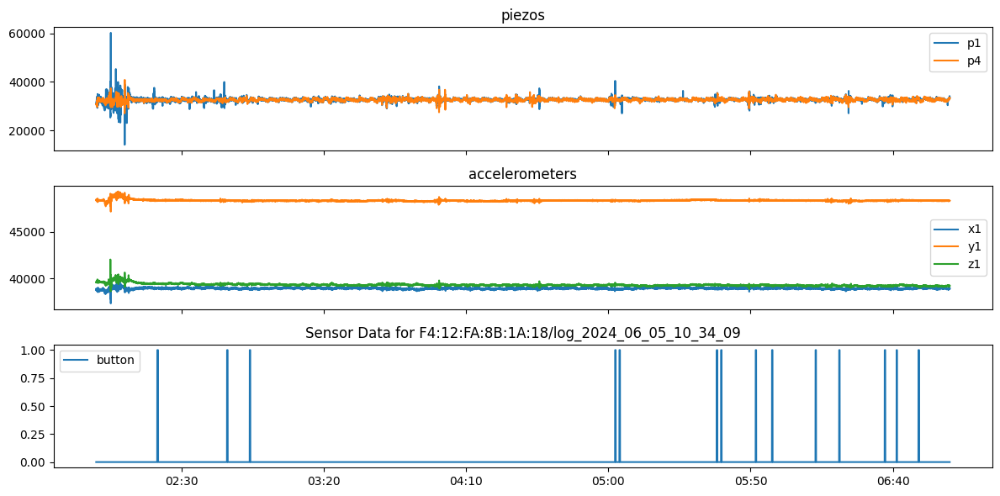



Session ID: F4:12:FA:8B:1A:18/log_2024_06_18_11_36_44.dat


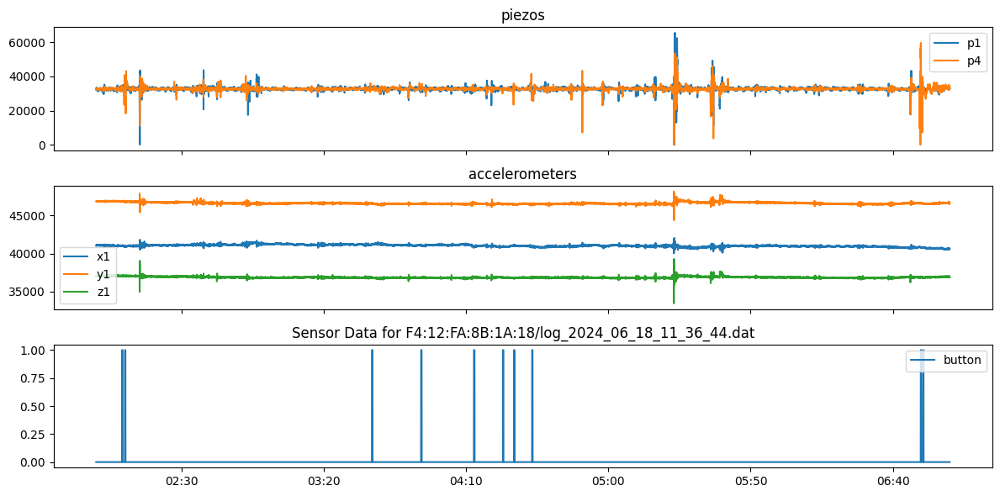



Session ID: F4:12:FA:8B:1B:C0/log_2024_04_25_12_48_51


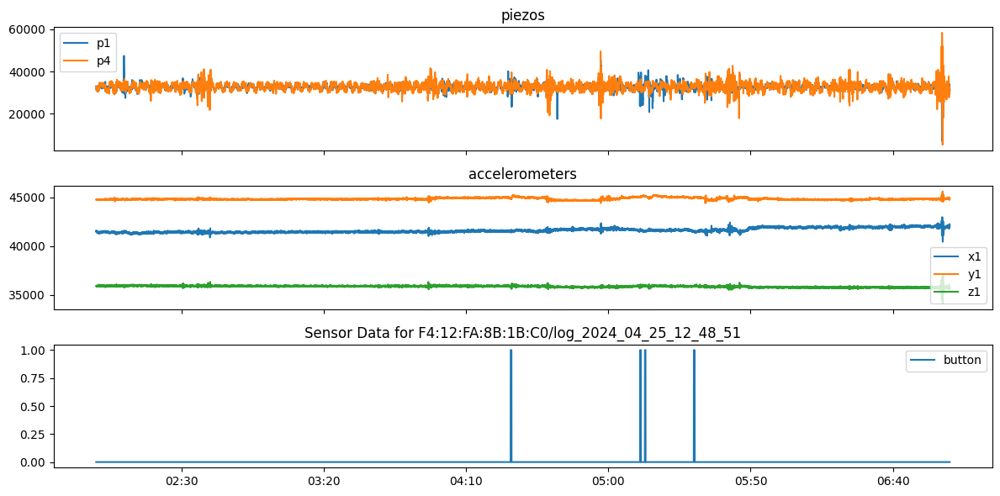



Session ID: F4:12:FA:8B:1B:C0/log_2024_05_09_13_31_59.dat


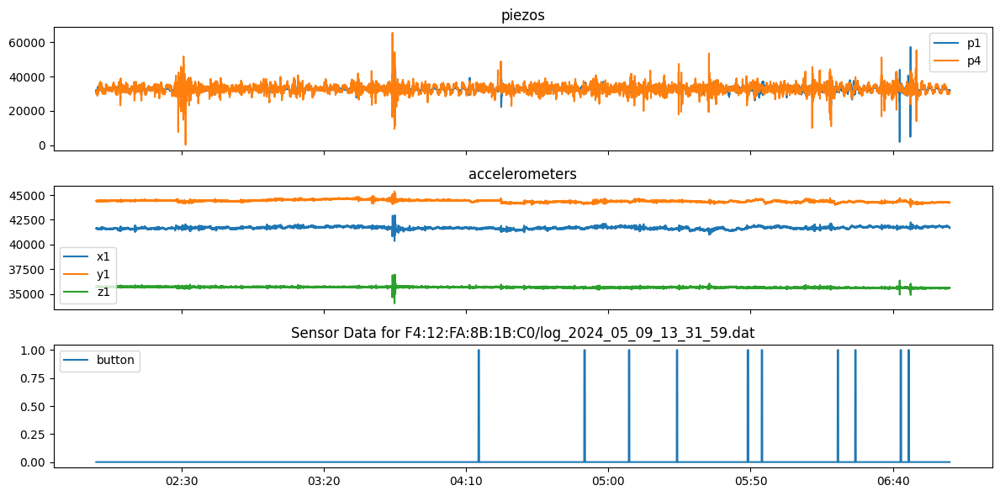



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_03_10_15_43


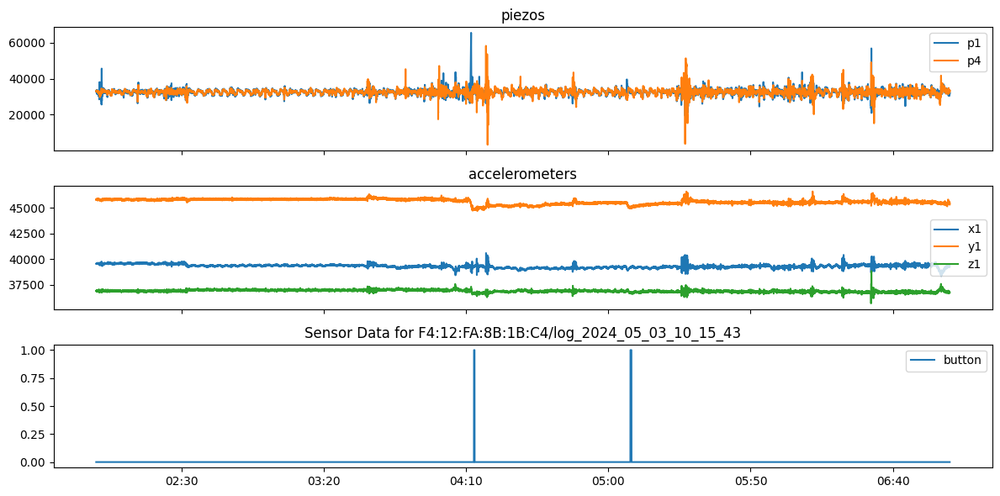



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_13_12_15_22


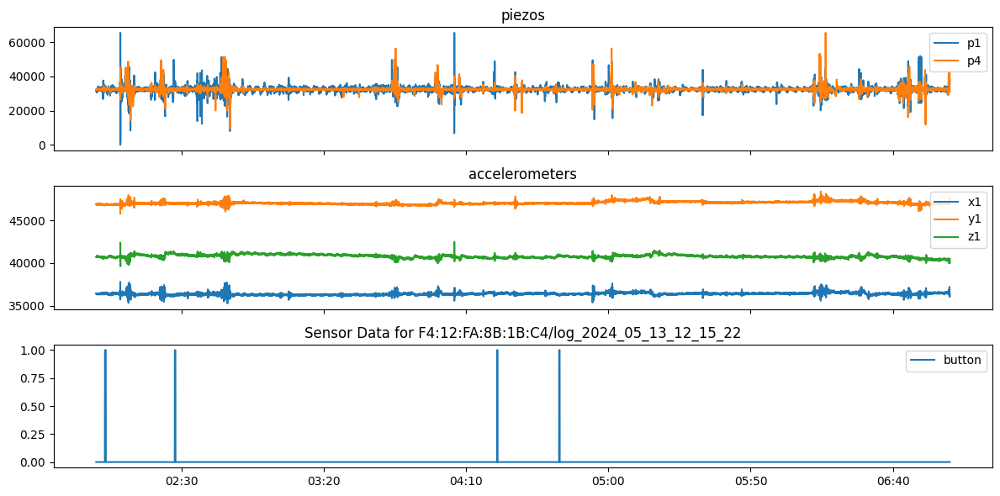



Session ID: F4:12:FA:8B:1B:CC/log_2024_05_02_13_06_56.dat


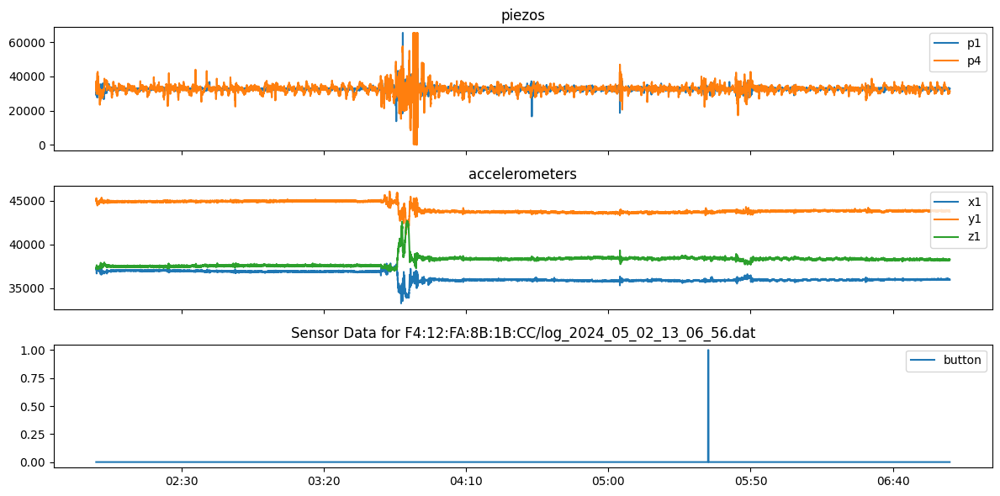

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 2&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-7 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_2.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_2.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 7), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48


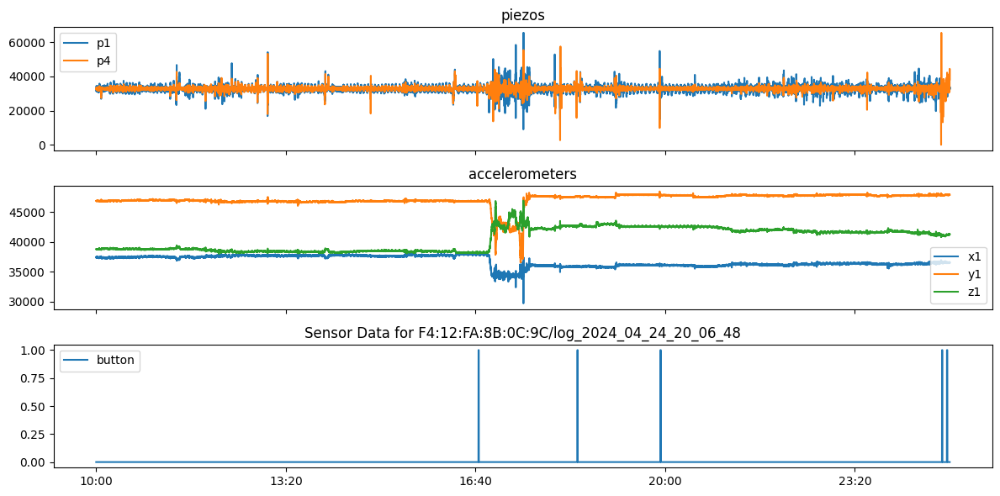



Session ID: F4:12:FA:8B:0D:08/log_2024_05_15_14_04_17


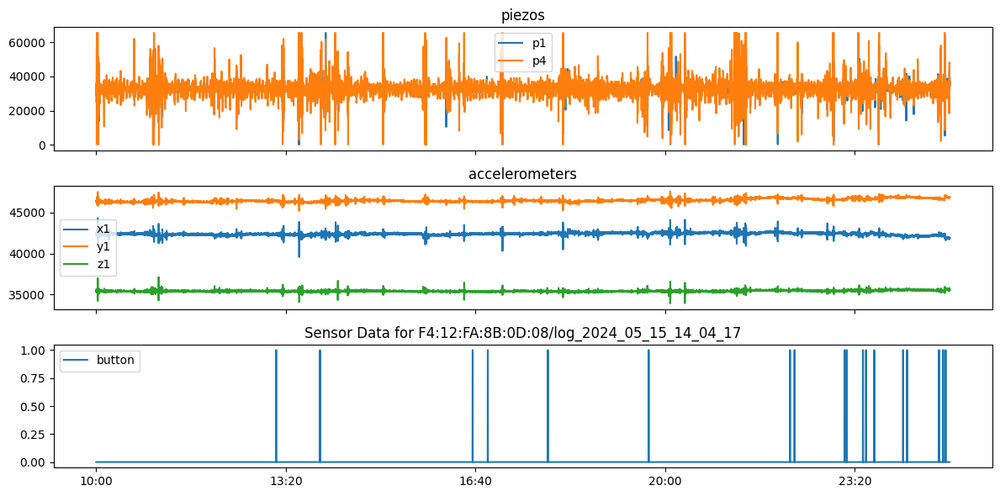



Session ID: F4:12:FA:8B:0D:08/log_2024_05_29_12_54_11.dat


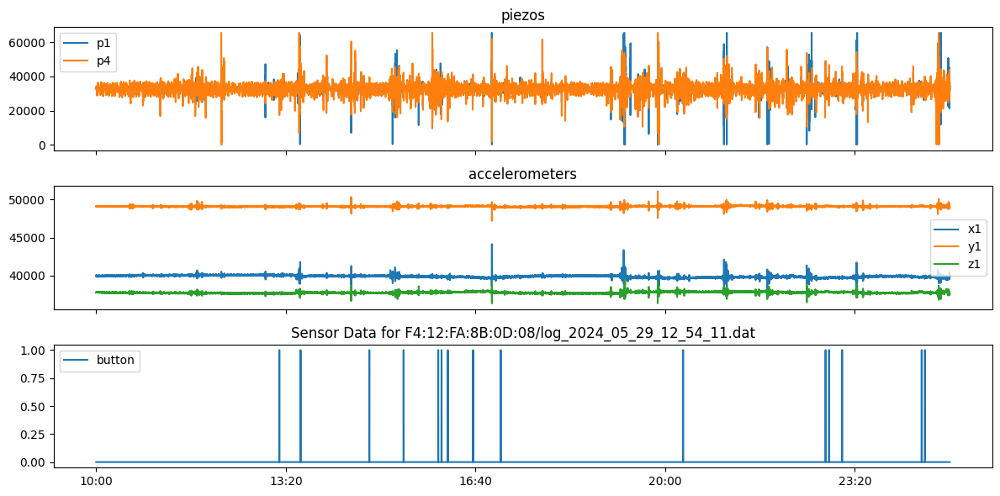



Session ID: F4:12:FA:8B:1A:18/log_2024_06_05_10_34_09


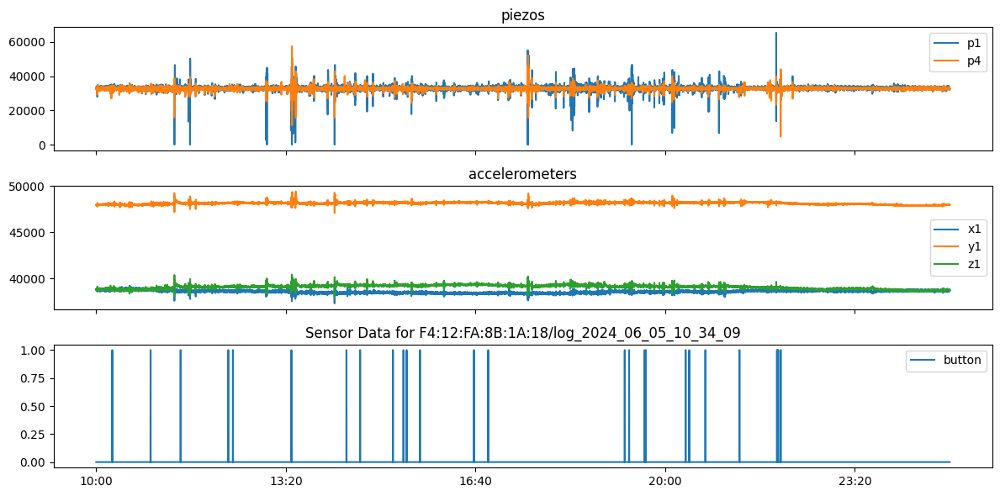



Session ID: F4:12:FA:8B:1A:18/log_2024_06_18_11_36_44.dat


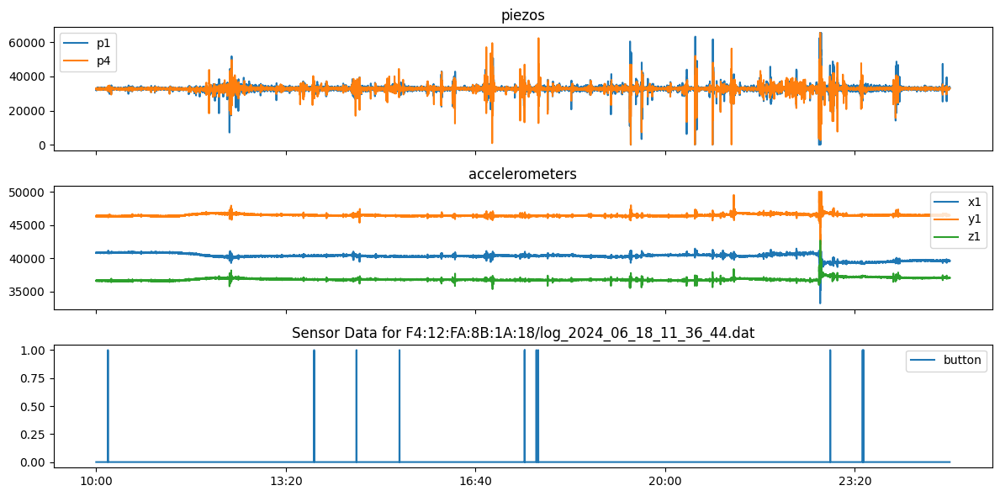



Session ID: F4:12:FA:8B:1B:C0/log_2024_04_25_12_48_51


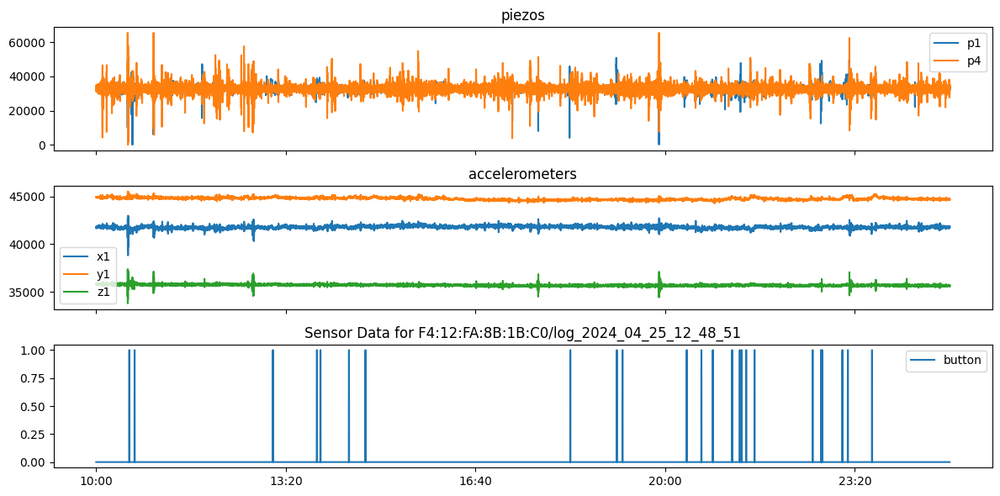



Session ID: F4:12:FA:8B:1B:C0/log_2024_05_09_13_31_59.dat


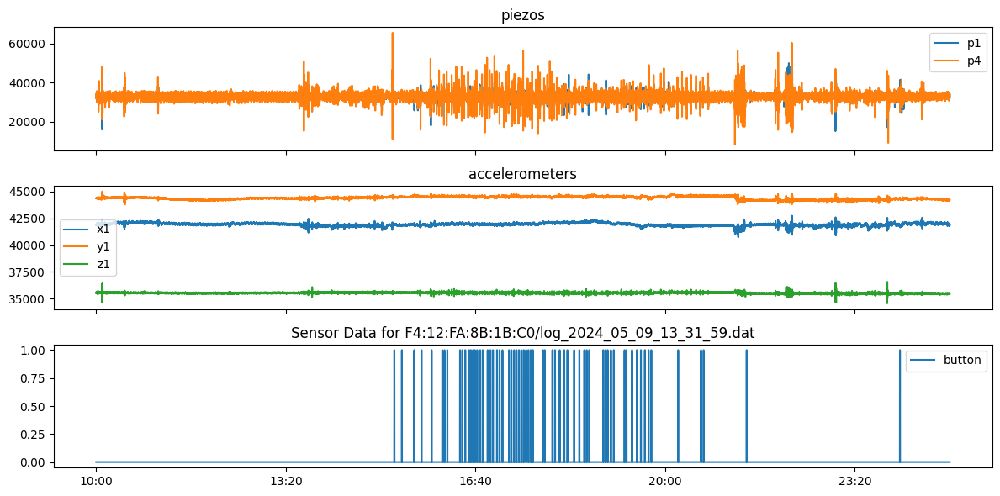



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_03_10_15_43


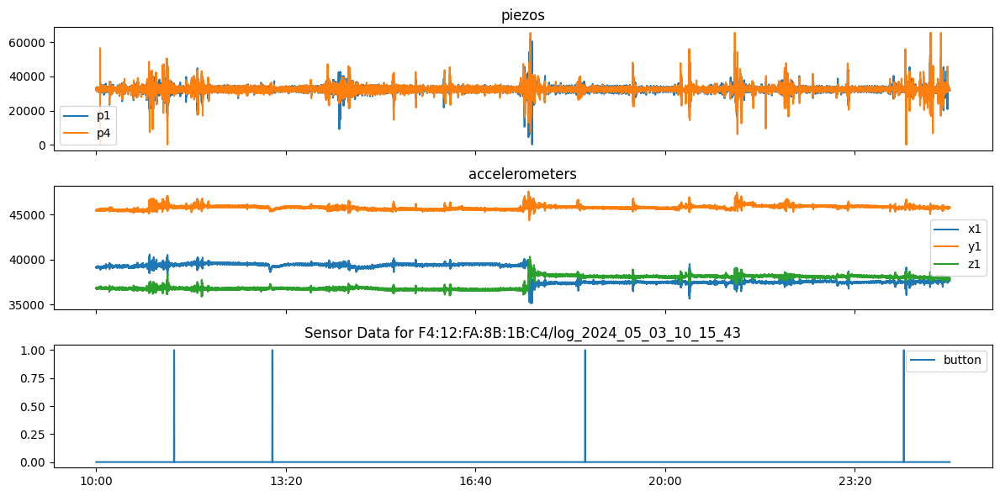



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_13_12_15_22


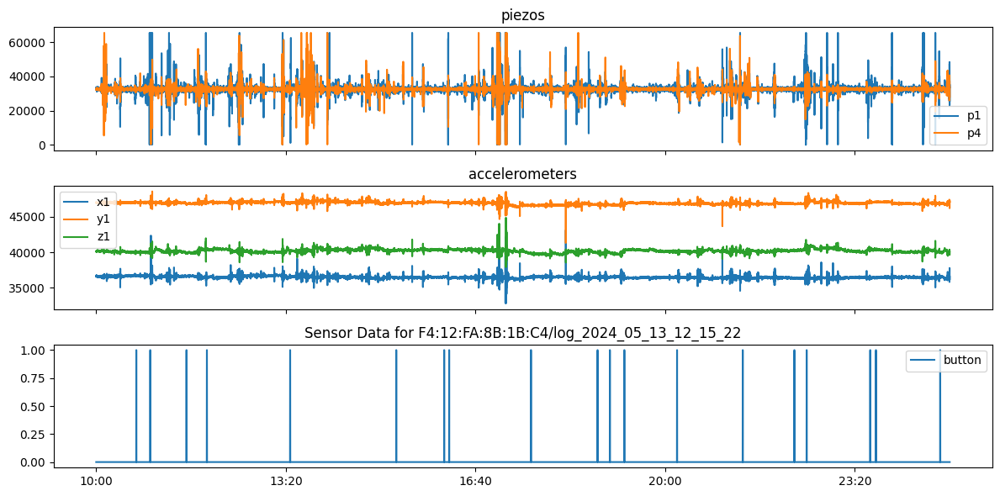



Session ID: F4:12:FA:8B:1B:CC/log_2024_05_02_13_06_56.dat


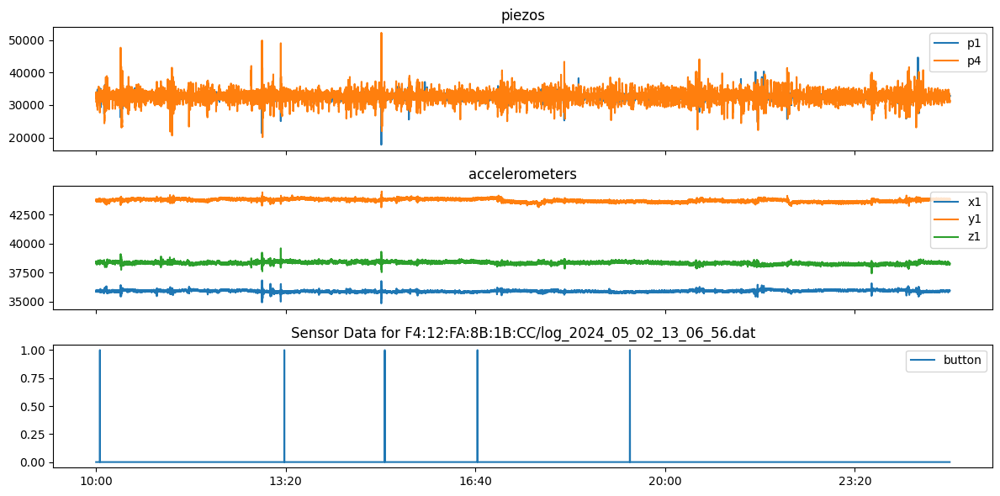

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 2&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 10-25 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_2.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_2.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(10, 25), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:0C:9C/log_2024_04_24_20_06_48


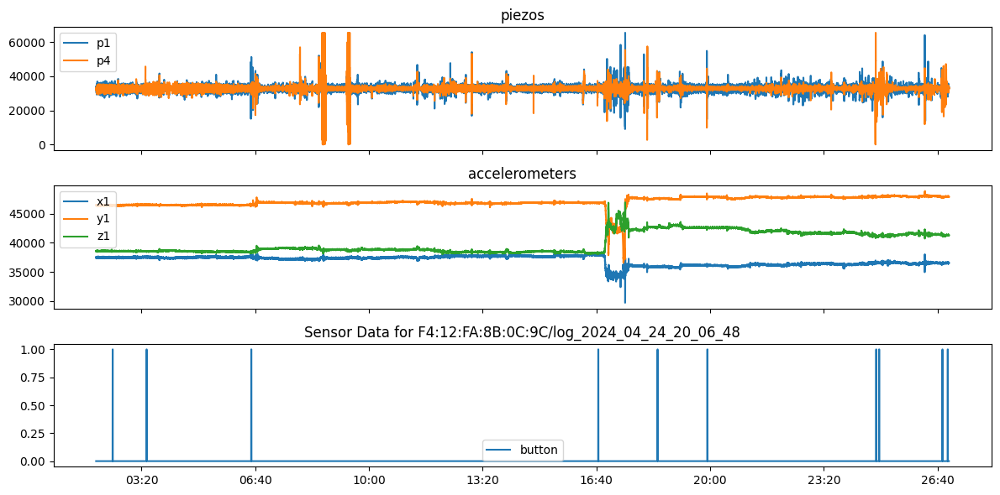



Session ID: F4:12:FA:8B:0D:08/log_2024_05_15_14_04_17


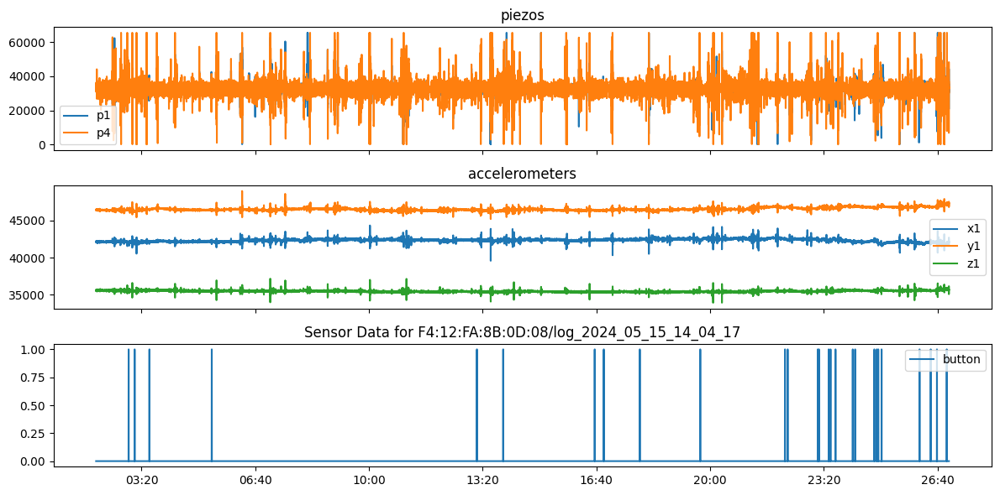



Session ID: F4:12:FA:8B:0D:08/log_2024_05_29_12_54_11.dat


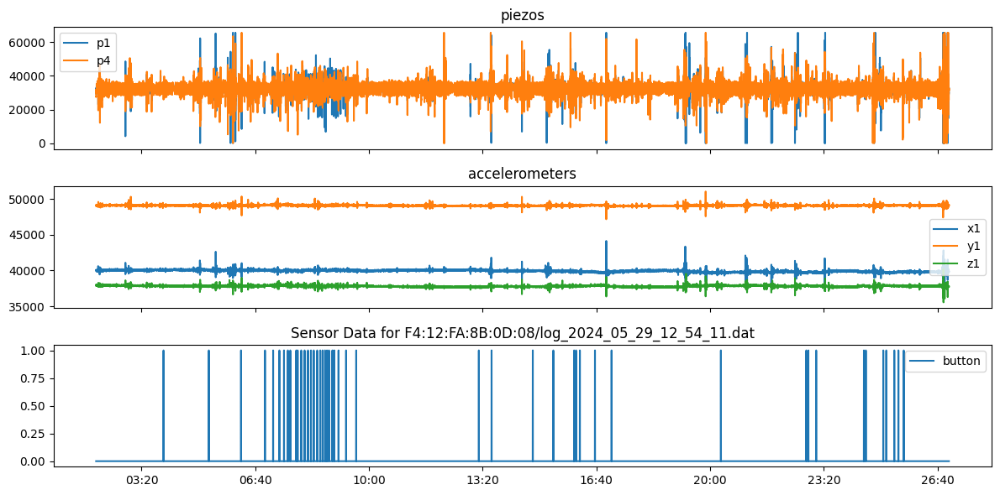



Session ID: F4:12:FA:8B:1A:18/log_2024_06_05_10_34_09


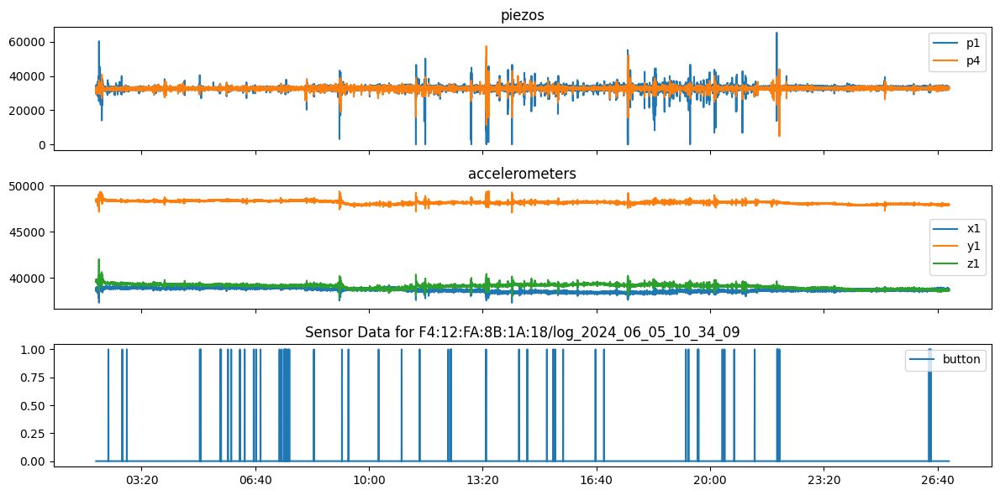



Session ID: F4:12:FA:8B:1A:18/log_2024_06_18_11_36_44.dat


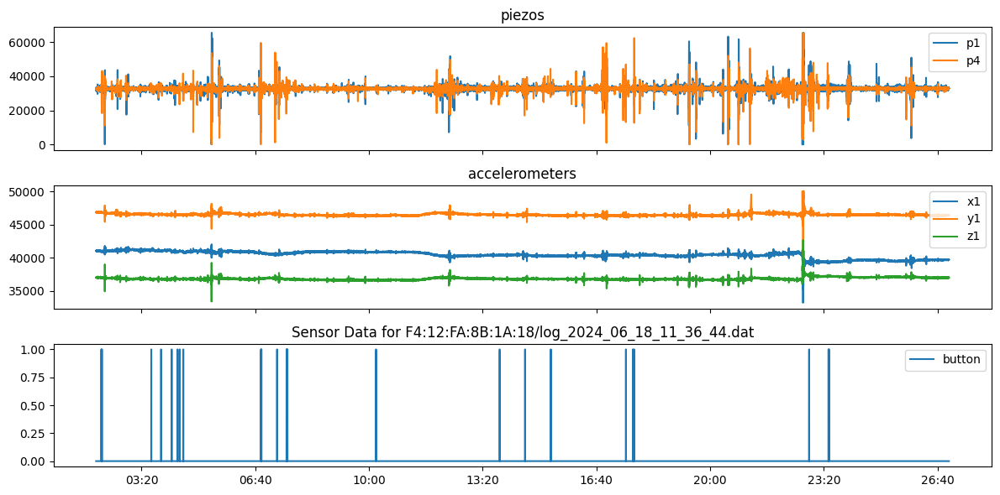



Session ID: F4:12:FA:8B:1B:C0/log_2024_04_25_12_48_51


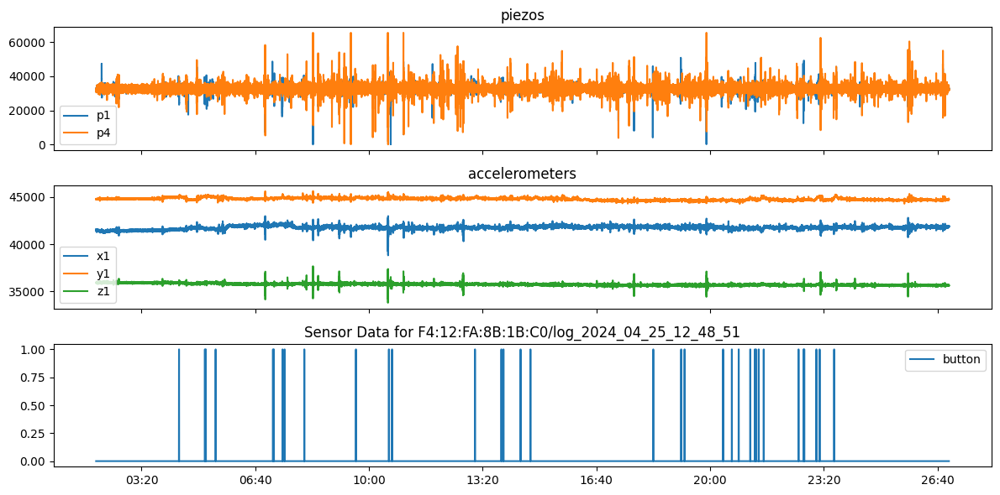



Session ID: F4:12:FA:8B:1B:C0/log_2024_05_09_13_31_59.dat


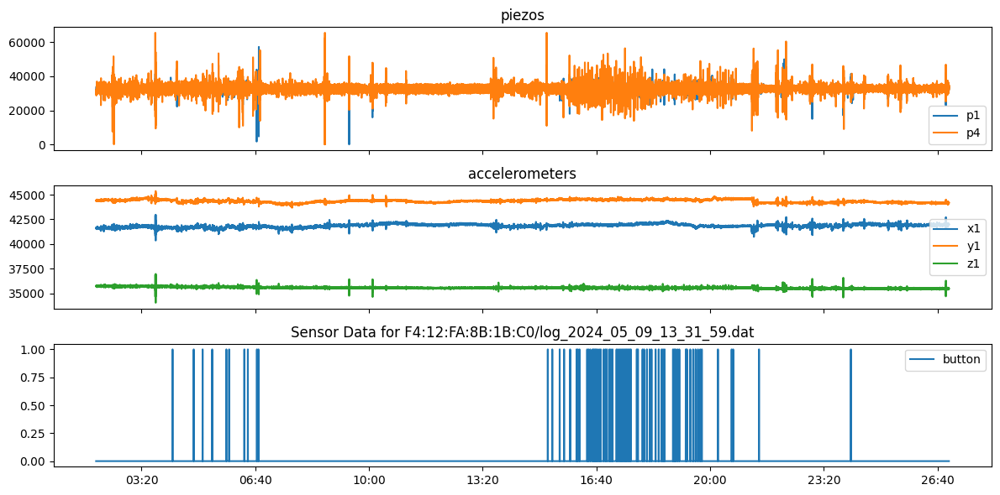



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_03_10_15_43


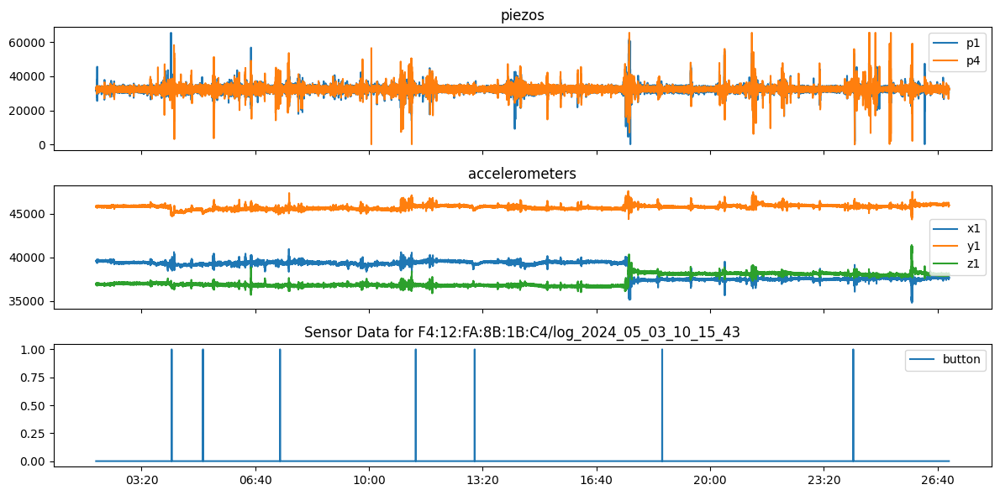



Session ID: F4:12:FA:8B:1B:C4/log_2024_05_13_12_15_22


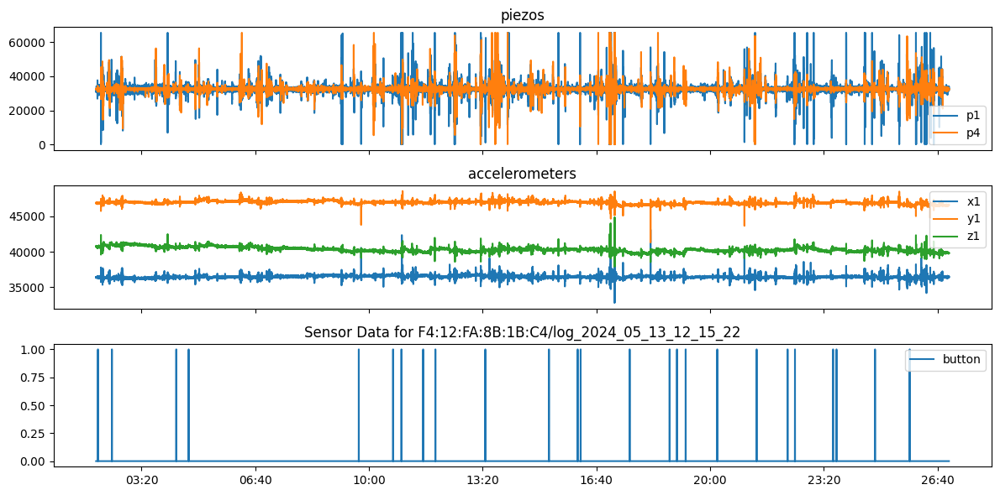



Session ID: F4:12:FA:8B:1B:CC/log_2024_05_02_13_06_56.dat


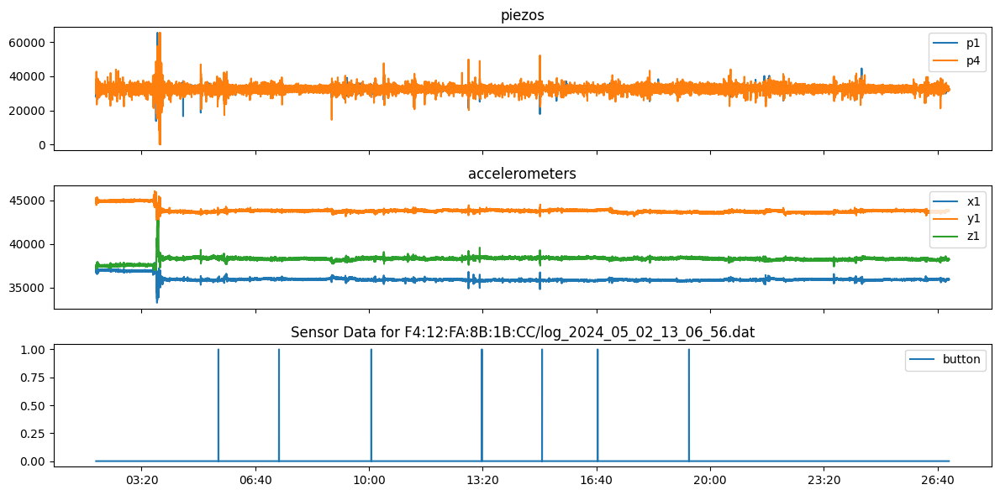

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 2&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-27 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_2.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_2.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 27), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45


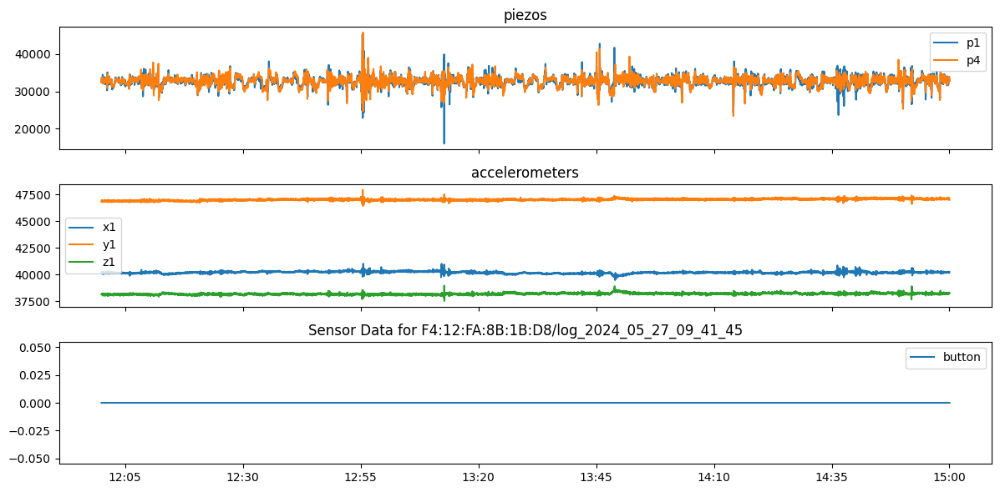



Session ID: F4:12:FA:8B:1B:D8/log_2024_06_10_10_42_29.dat


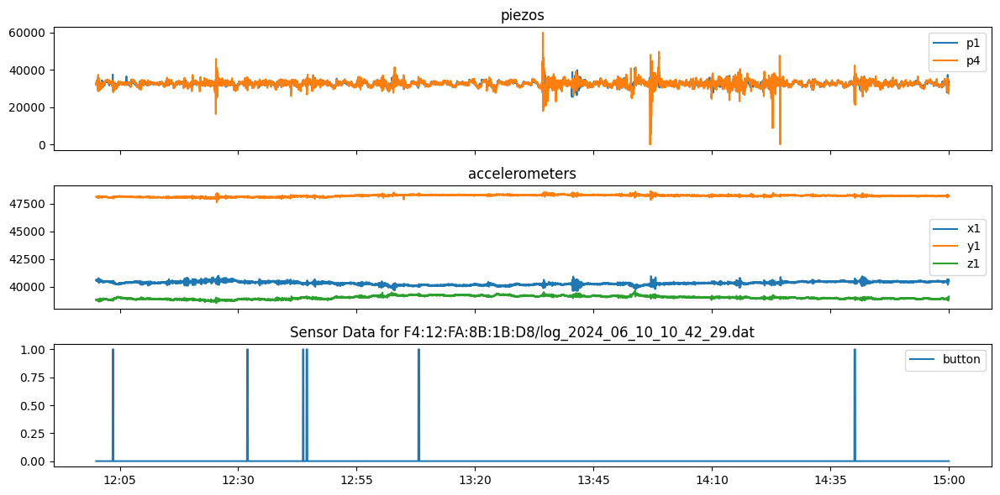



Session ID: F4:12:FA:8B:1B:E0/log_2024_05_29_12_03_42.dat


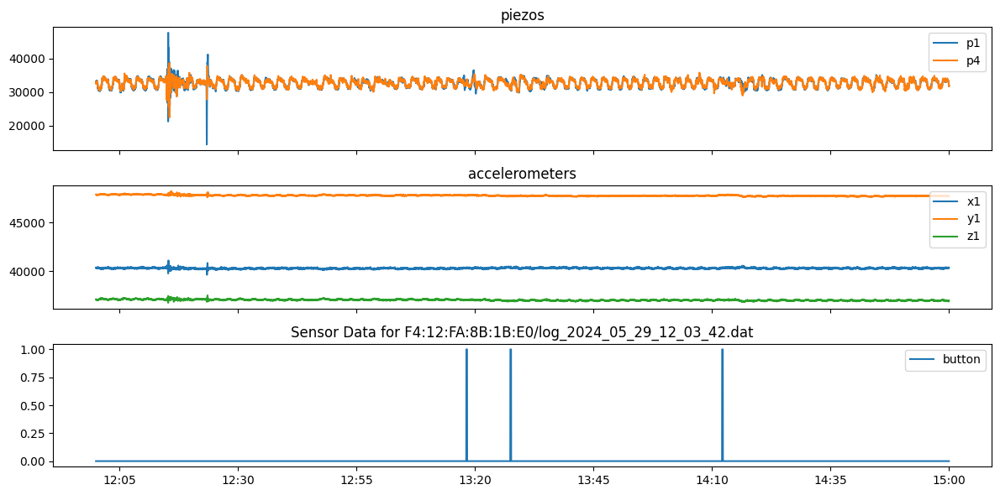



Session ID: F4:12:FA:8B:1B:E0/log_2024_06_12_11_09_03.dat


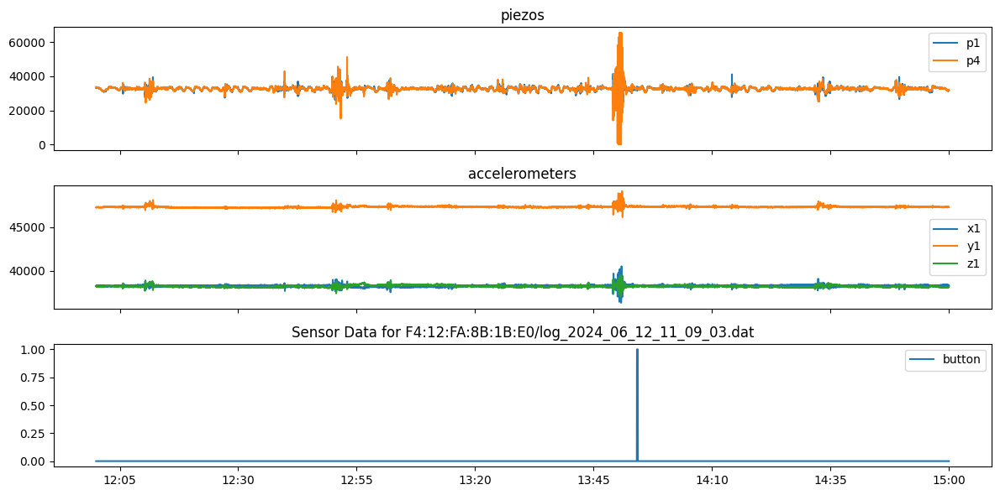



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_01_13_53_04.dat


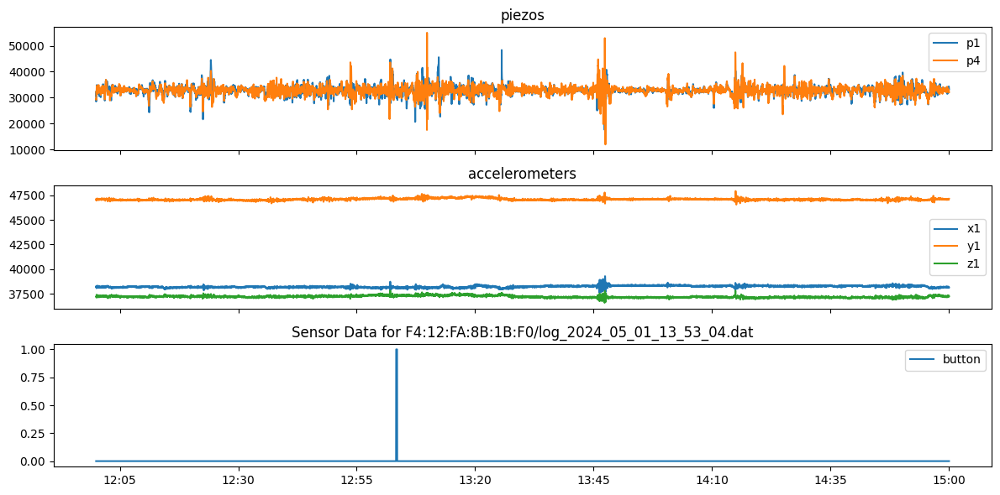



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_15_13_49_46.dat


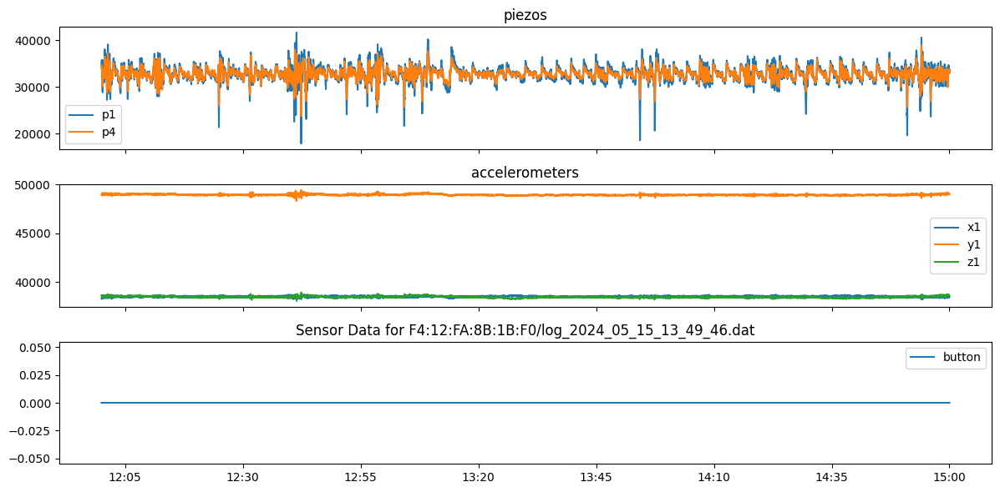



Session ID: F4:12:FA:8B:1C:1C/log_2024_04_29_14_54_03


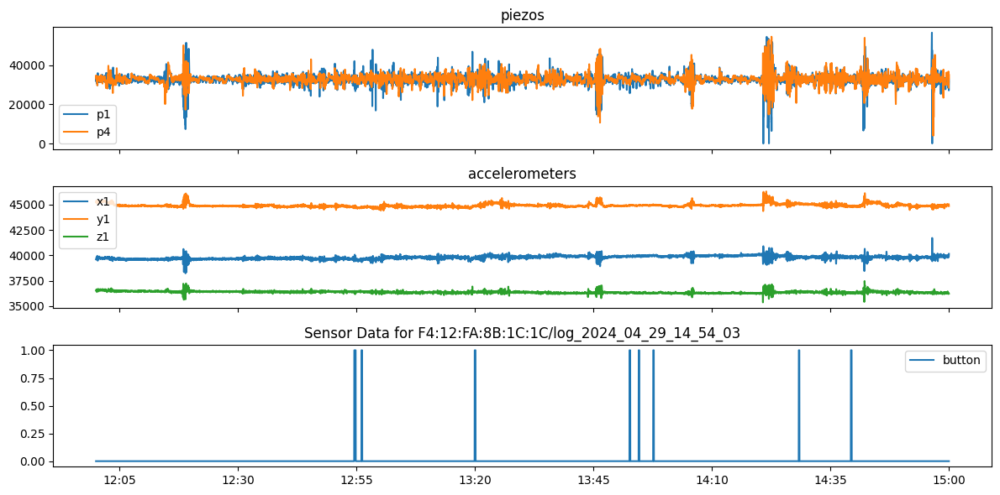



Session ID: F4:12:FA:8B:1C:1C/log_2024_05_13_12_54_21


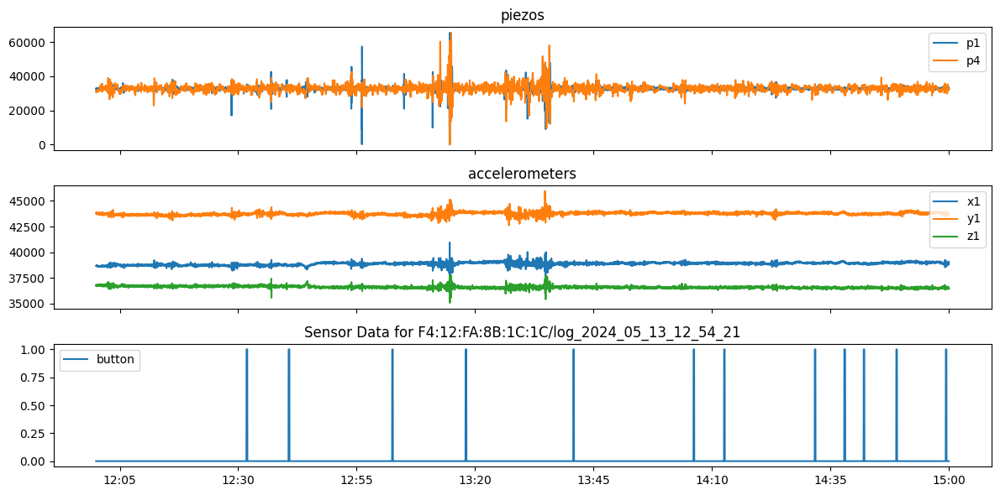



Session ID: F4:12:FA:8D:05:BC/log_2024_05_02_14_43_19.dat


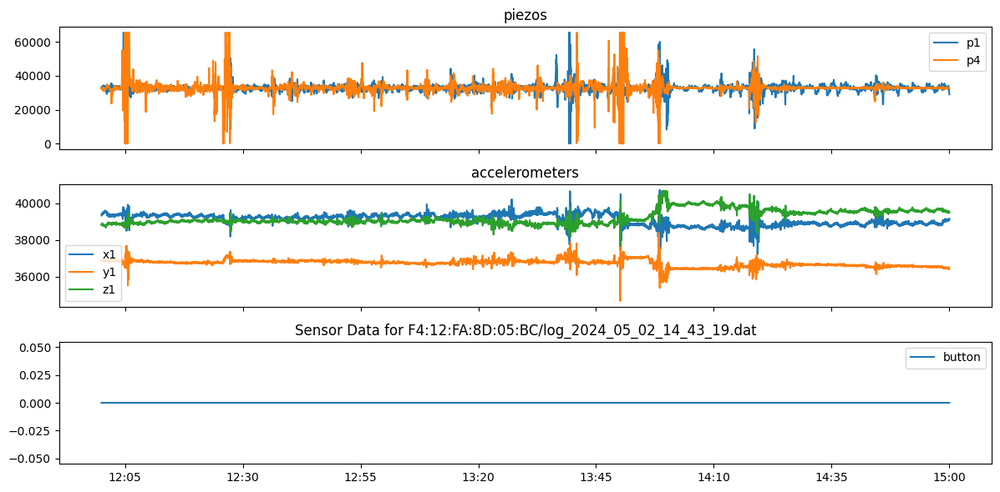



Session ID: F4:12:FA:8D:05:EC/log_2024_04_17_09_22_19.dat


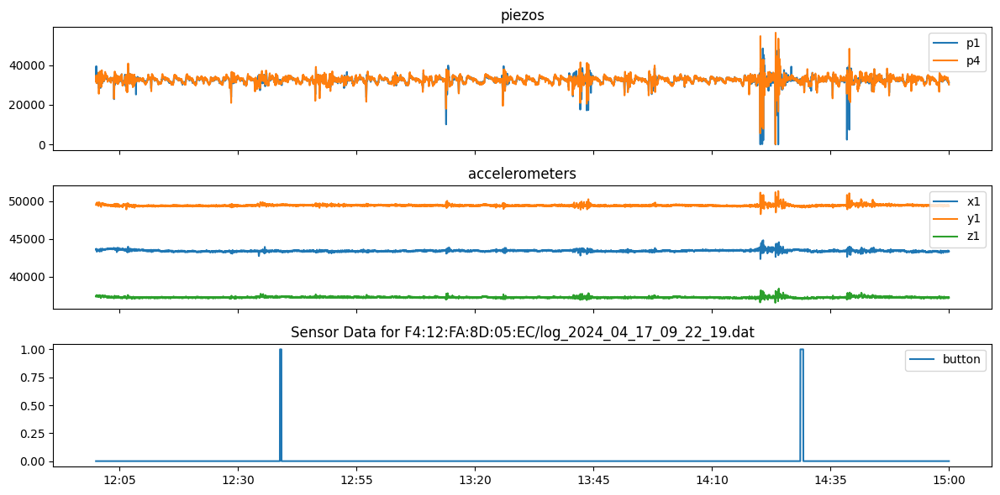

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 3&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 12-15 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_3.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_3.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(12, 15), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45


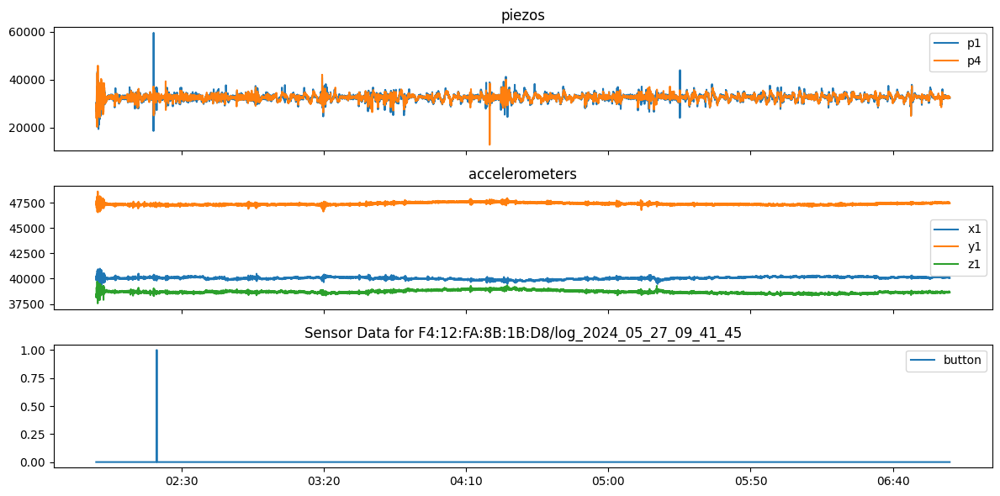



Session ID: F4:12:FA:8B:1B:D8/log_2024_06_10_10_42_29.dat


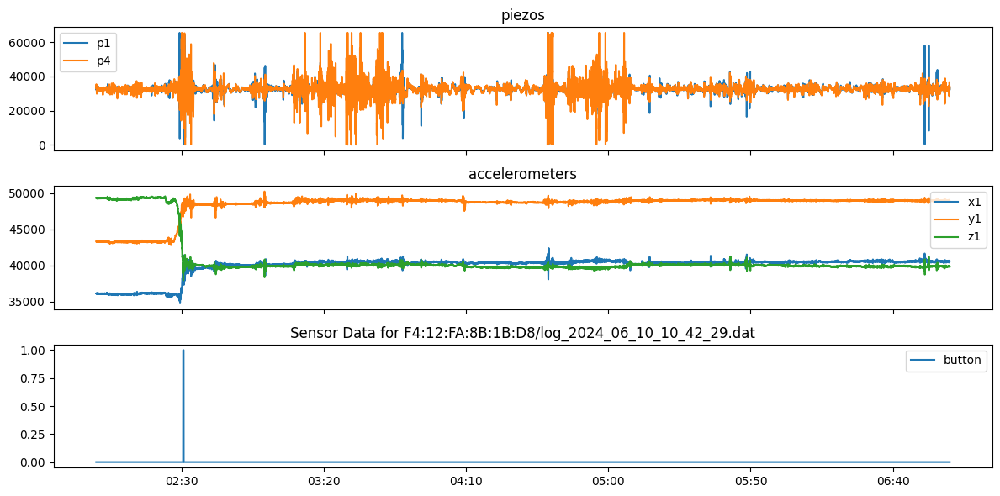



Session ID: F4:12:FA:8B:1B:E0/log_2024_05_29_12_03_42.dat


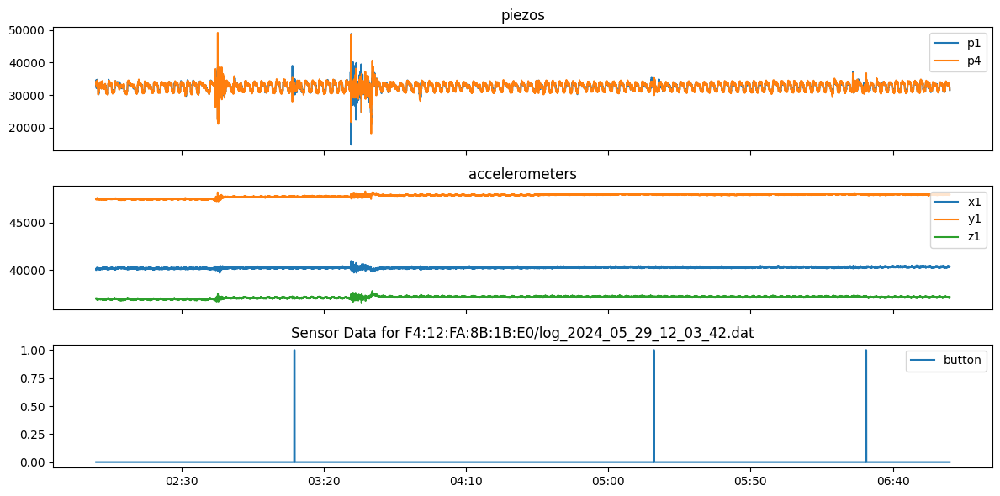



Session ID: F4:12:FA:8B:1B:E0/log_2024_06_12_11_09_03.dat


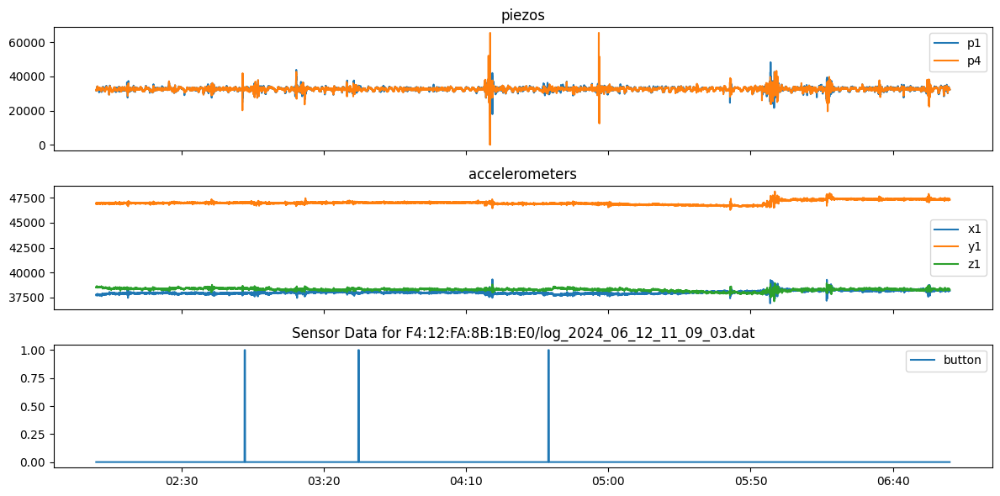



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_01_13_53_04.dat


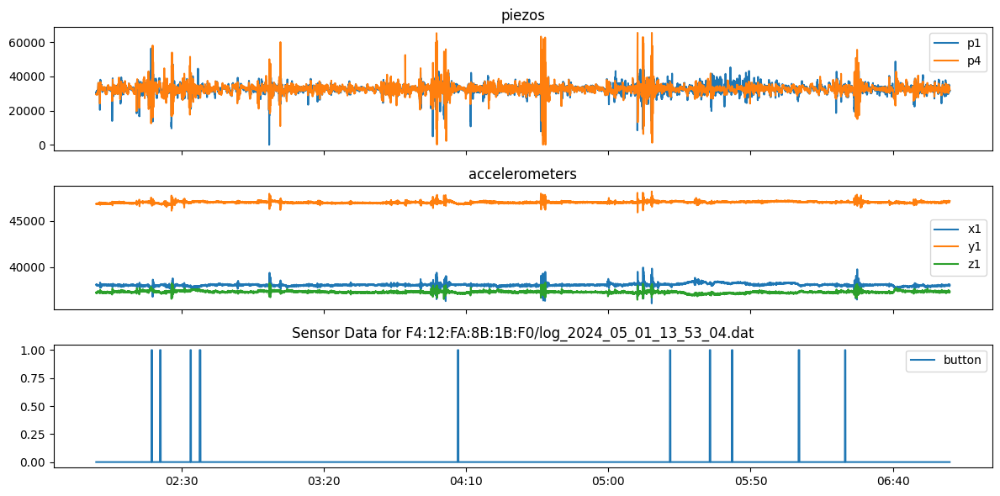



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_15_13_49_46.dat


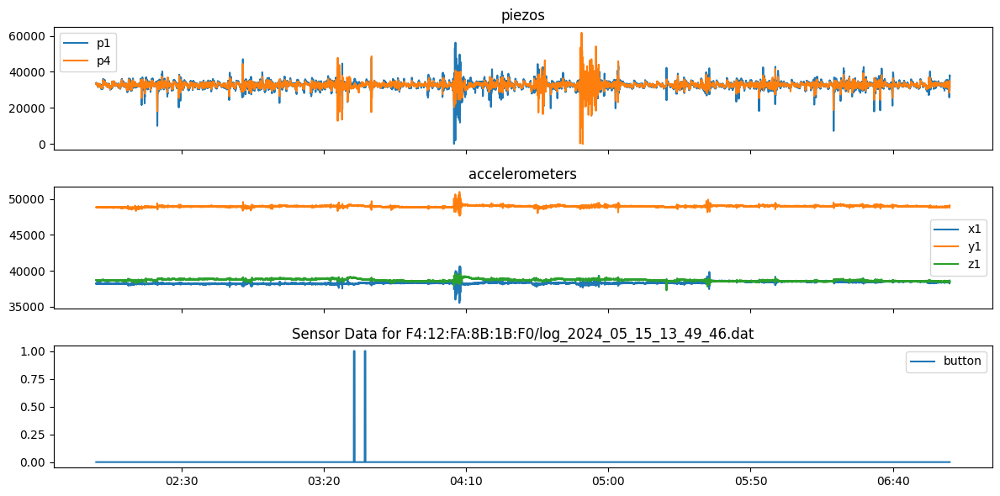



Session ID: F4:12:FA:8B:1C:1C/log_2024_04_29_14_54_03


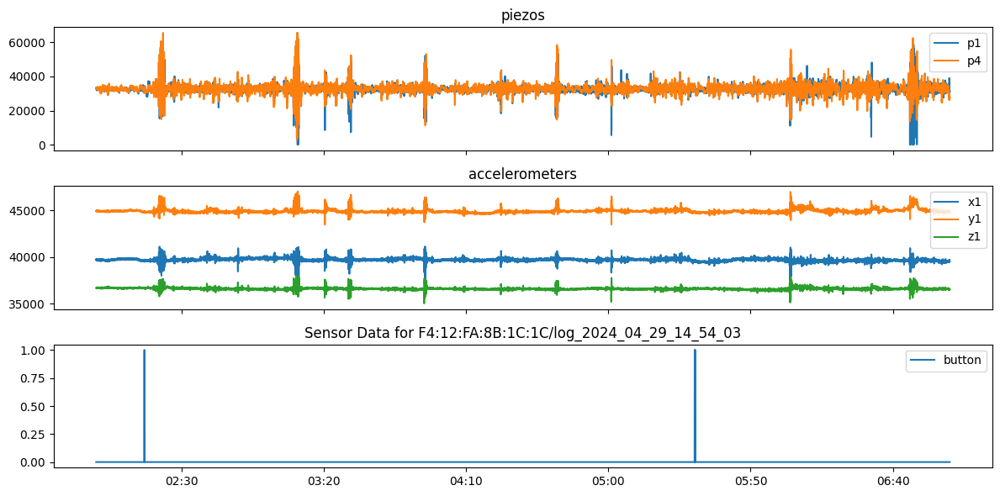



Session ID: F4:12:FA:8B:1C:1C/log_2024_05_13_12_54_21


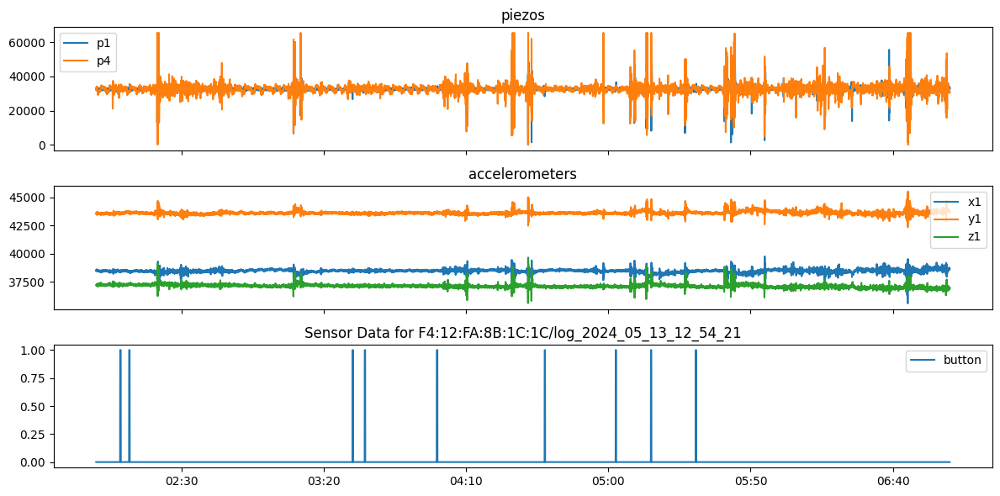



Session ID: F4:12:FA:8D:05:BC/log_2024_05_02_14_43_19.dat


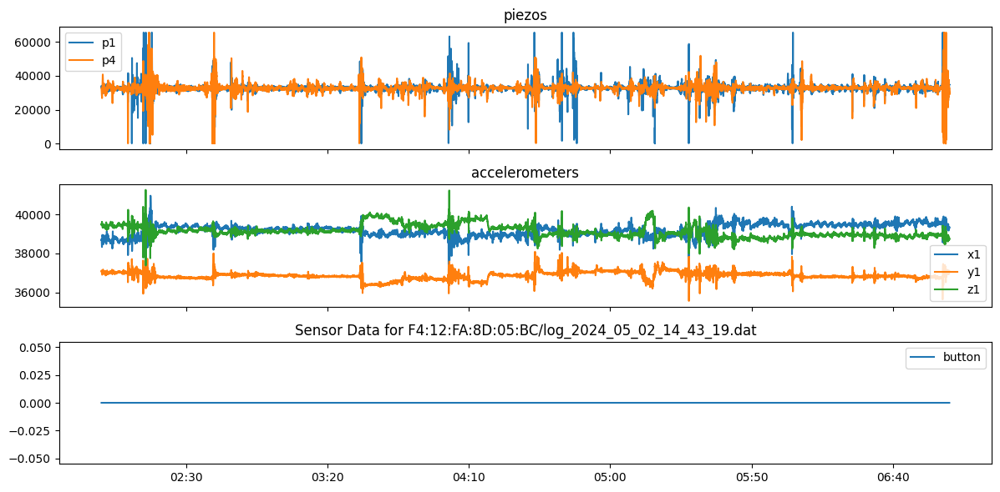



Session ID: F4:12:FA:8D:05:EC/log_2024_04_17_09_22_19.dat


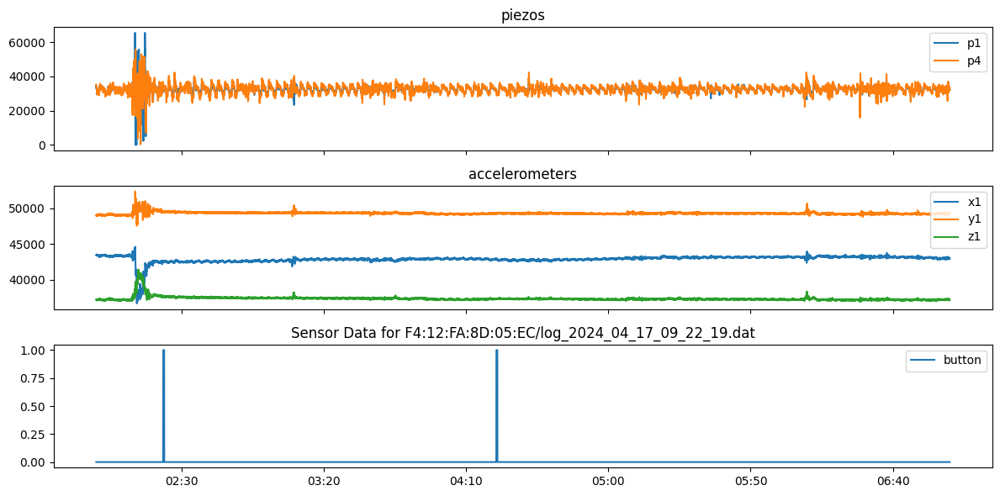

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 3&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-7 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_3.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_3.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 7), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45


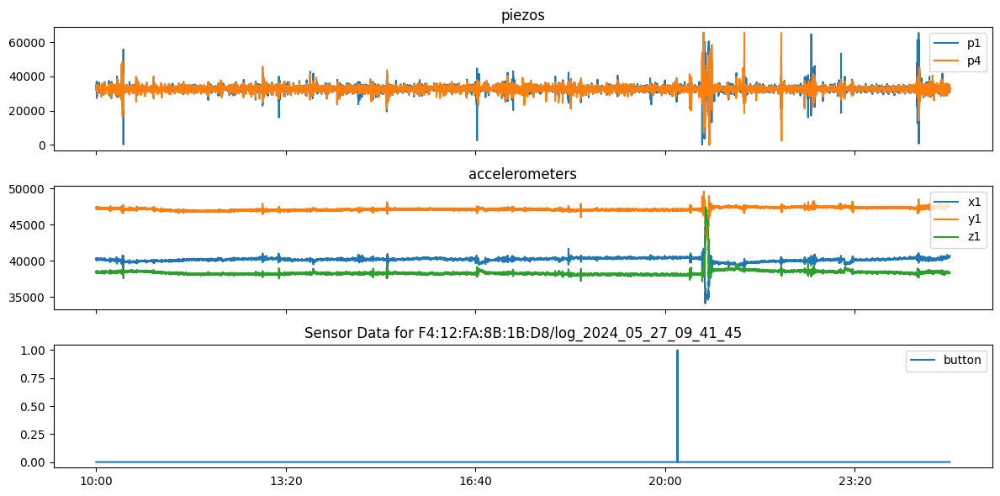



Session ID: F4:12:FA:8B:1B:D8/log_2024_06_10_10_42_29.dat


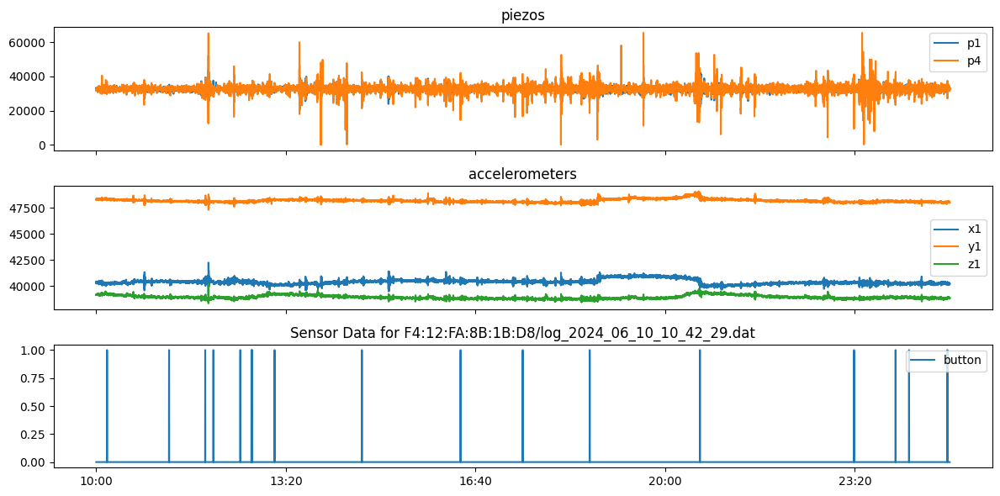



Session ID: F4:12:FA:8B:1B:E0/log_2024_05_29_12_03_42.dat


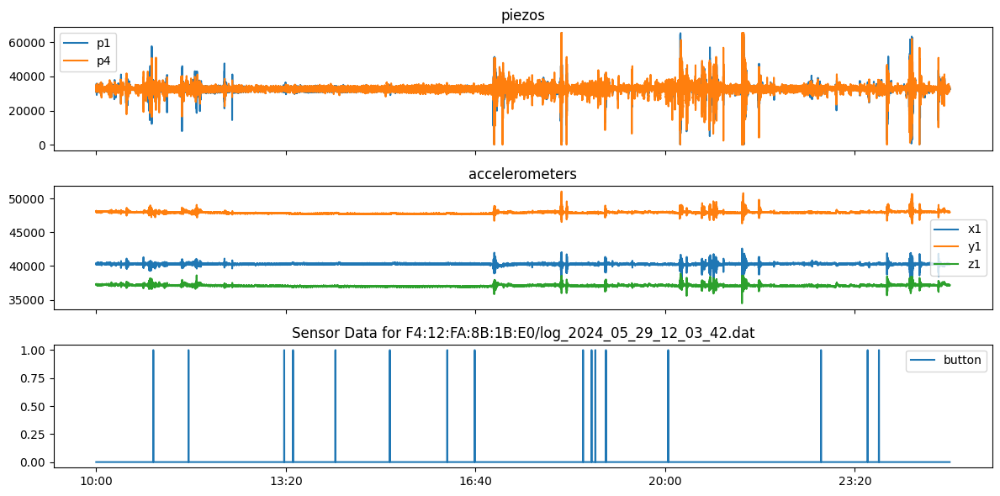



Session ID: F4:12:FA:8B:1B:E0/log_2024_06_12_11_09_03.dat


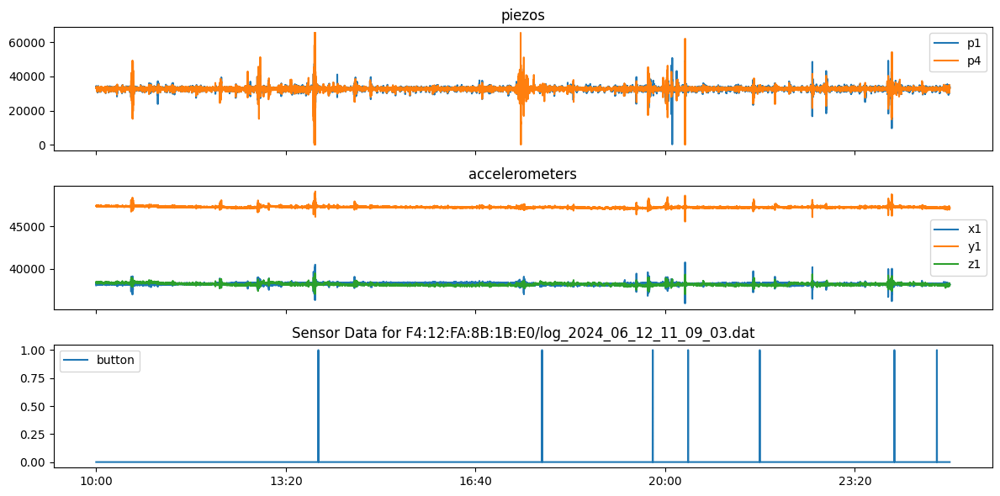



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_01_13_53_04.dat


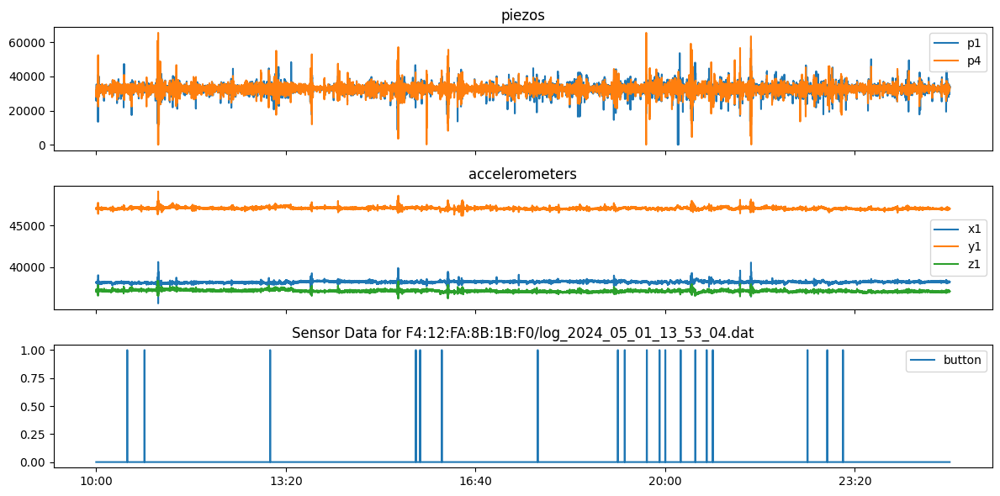



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_15_13_49_46.dat


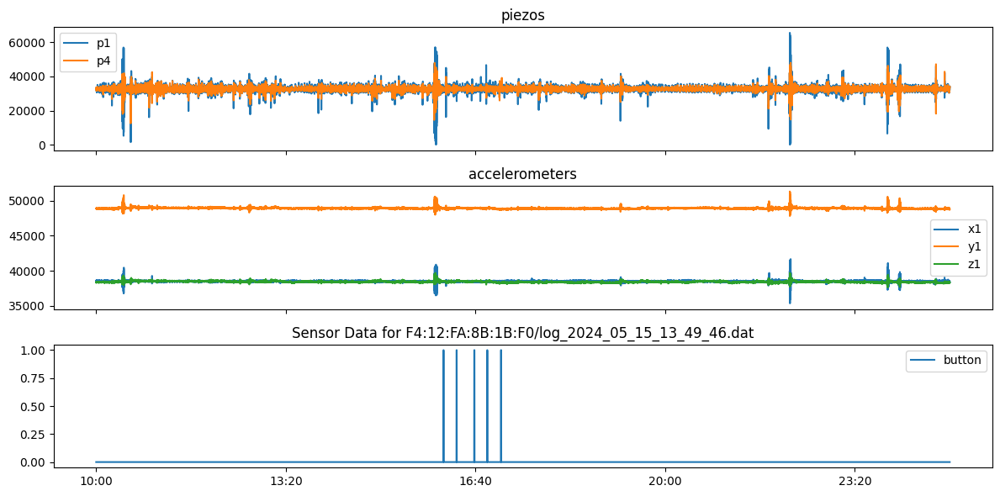



Session ID: F4:12:FA:8B:1C:1C/log_2024_04_29_14_54_03


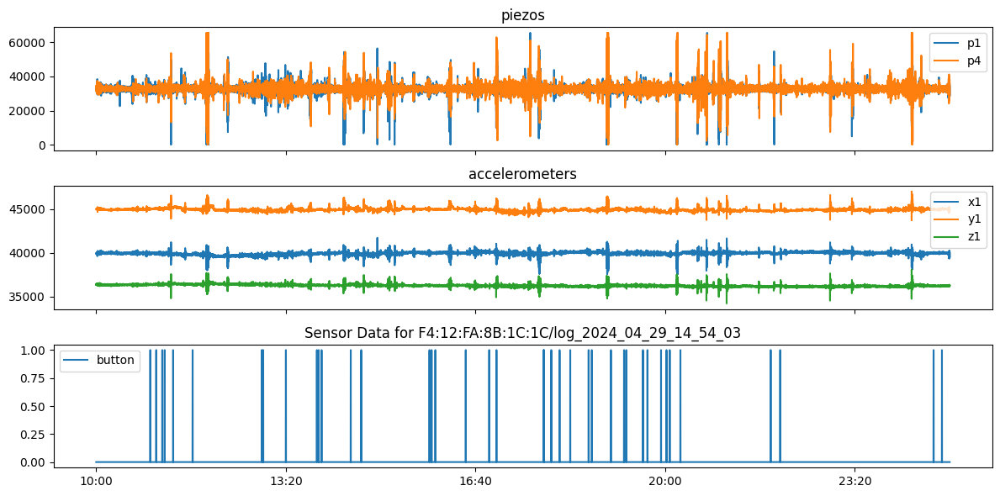



Session ID: F4:12:FA:8B:1C:1C/log_2024_05_13_12_54_21


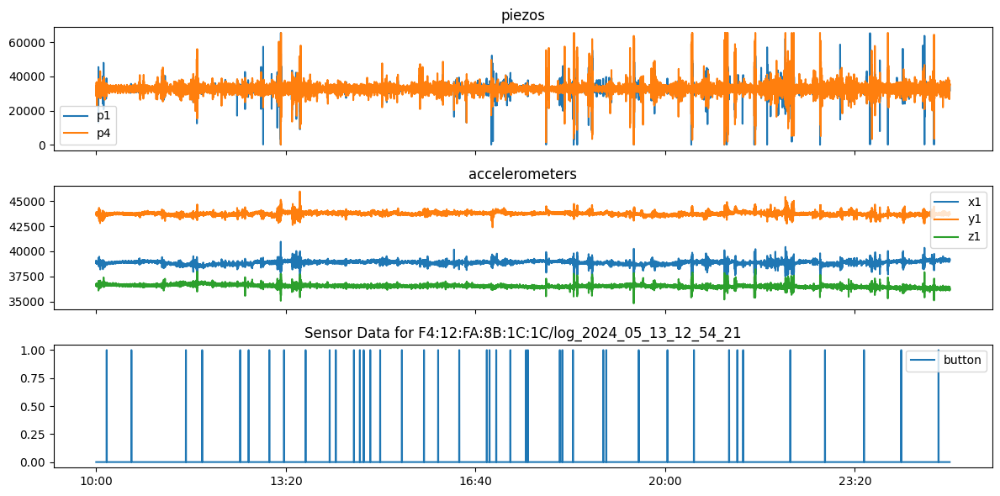



Session ID: F4:12:FA:8D:05:BC/log_2024_05_02_14_43_19.dat


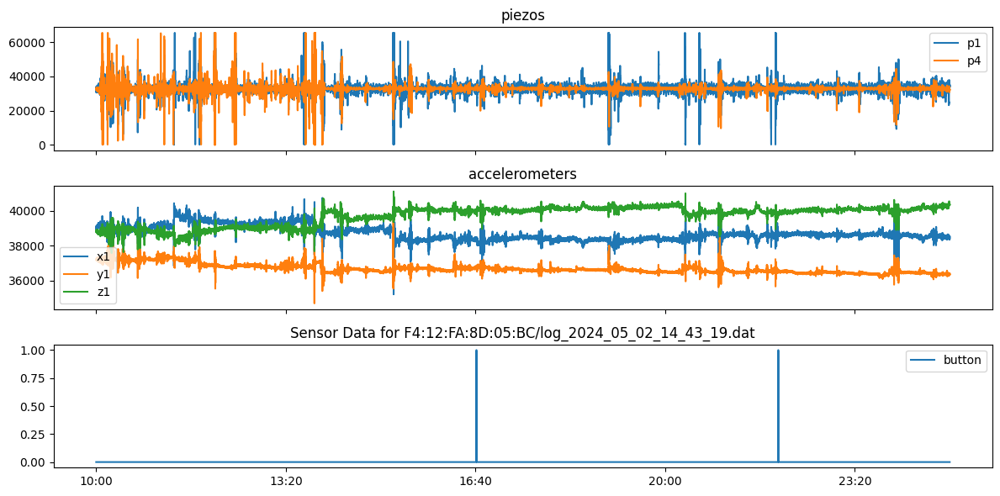



Session ID: F4:12:FA:8D:05:EC/log_2024_04_17_09_22_19.dat


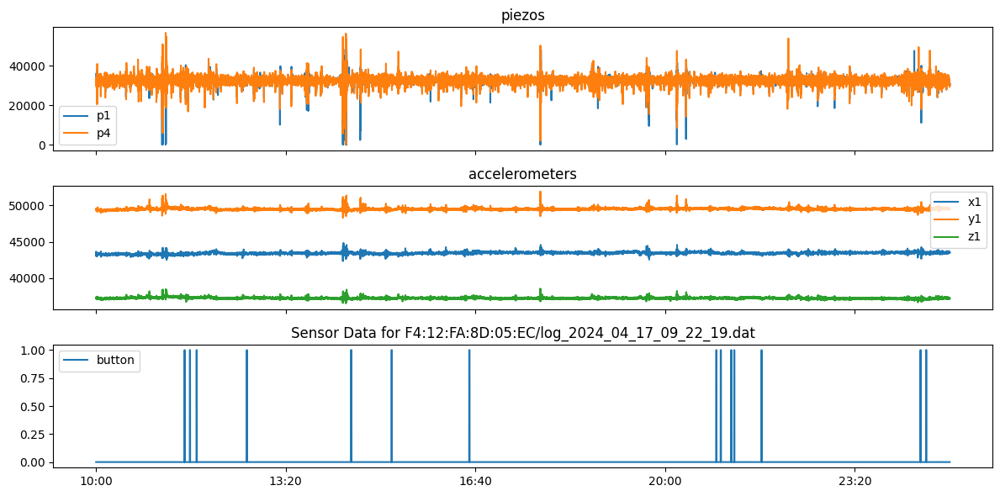

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 3&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 10-25 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_3.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_3.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(10, 25), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8B:1B:D8/log_2024_05_27_09_41_45


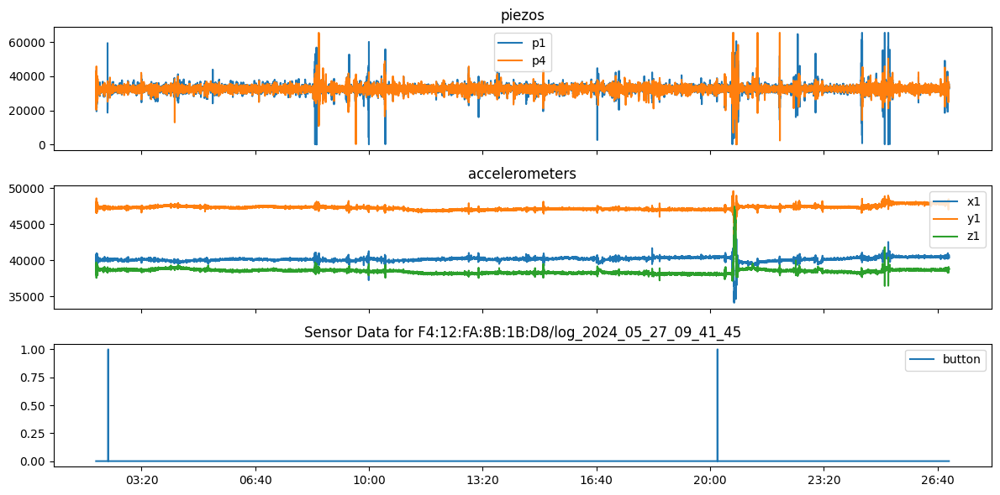



Session ID: F4:12:FA:8B:1B:D8/log_2024_06_10_10_42_29.dat


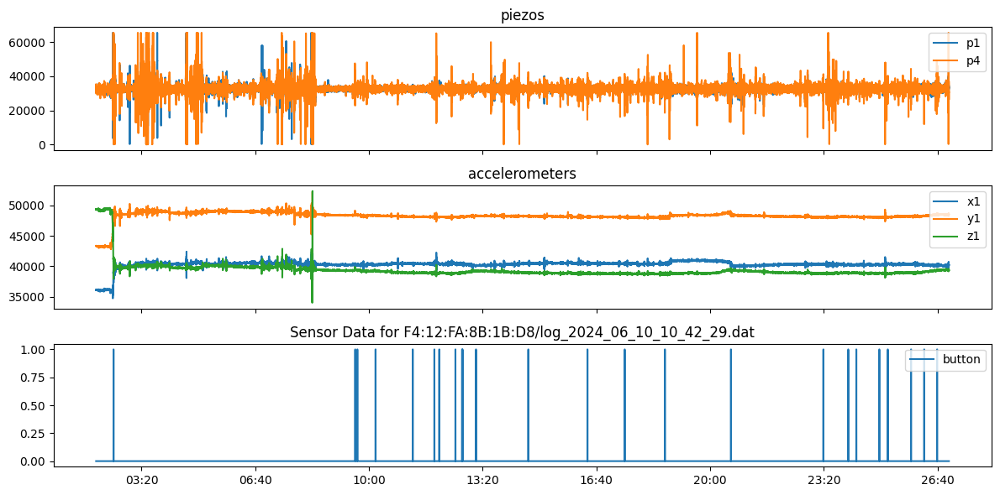



Session ID: F4:12:FA:8B:1B:E0/log_2024_05_29_12_03_42.dat


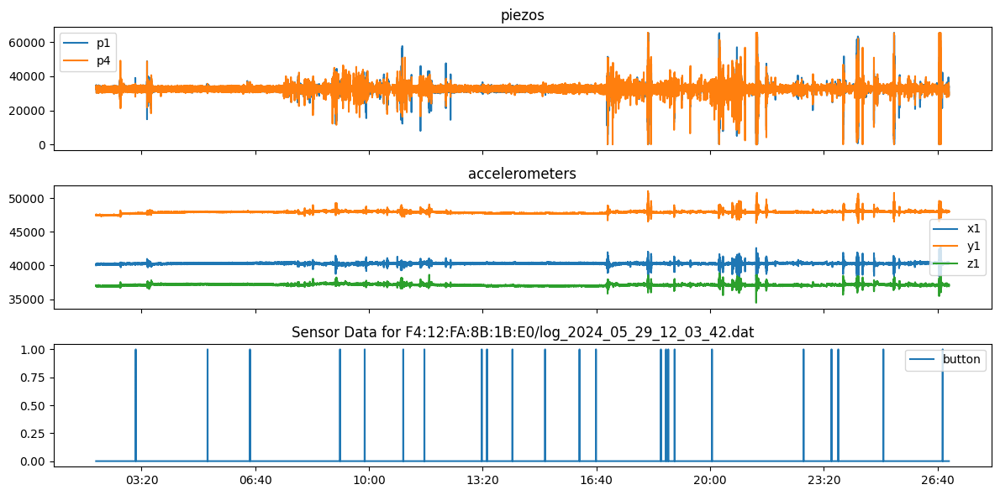



Session ID: F4:12:FA:8B:1B:E0/log_2024_06_12_11_09_03.dat


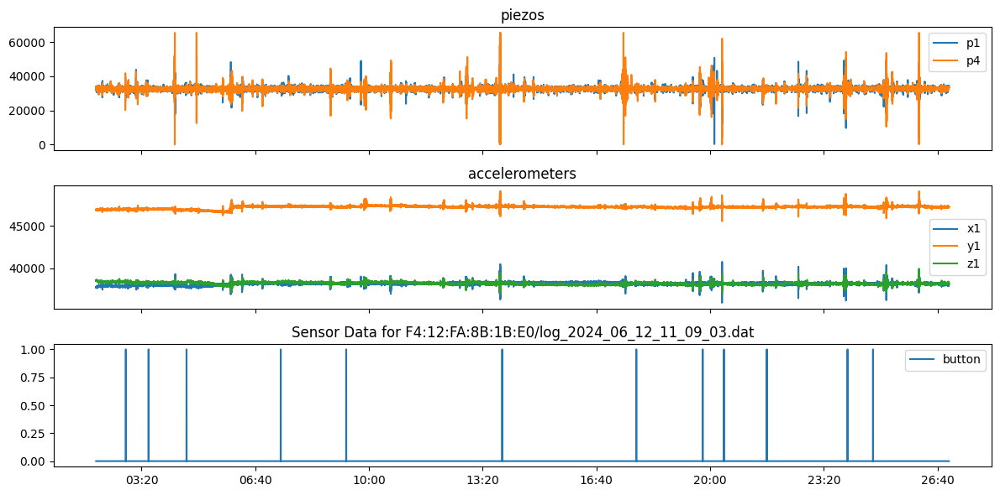



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_01_13_53_04.dat


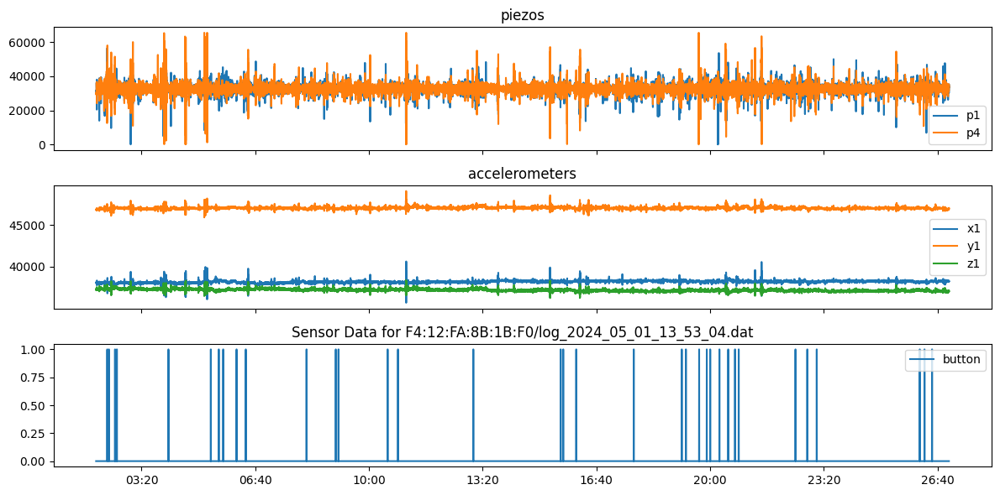



Session ID: F4:12:FA:8B:1B:F0/log_2024_05_15_13_49_46.dat


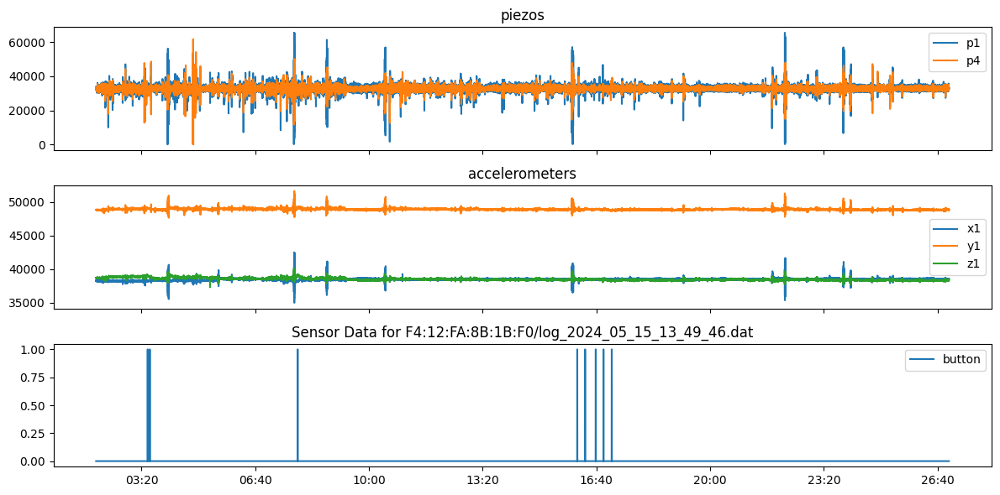



Session ID: F4:12:FA:8B:1C:1C/log_2024_04_29_14_54_03


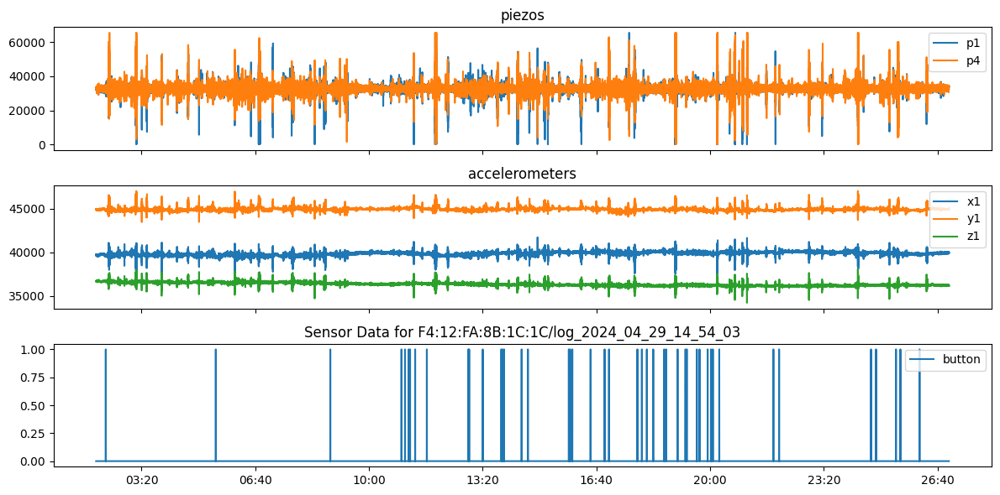



Session ID: F4:12:FA:8B:1C:1C/log_2024_05_13_12_54_21


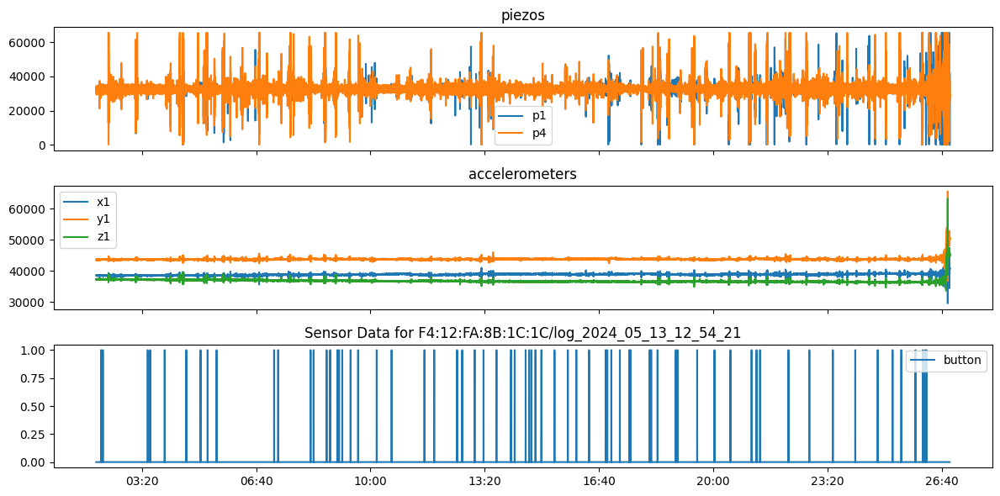



Session ID: F4:12:FA:8D:05:BC/log_2024_05_02_14_43_19.dat


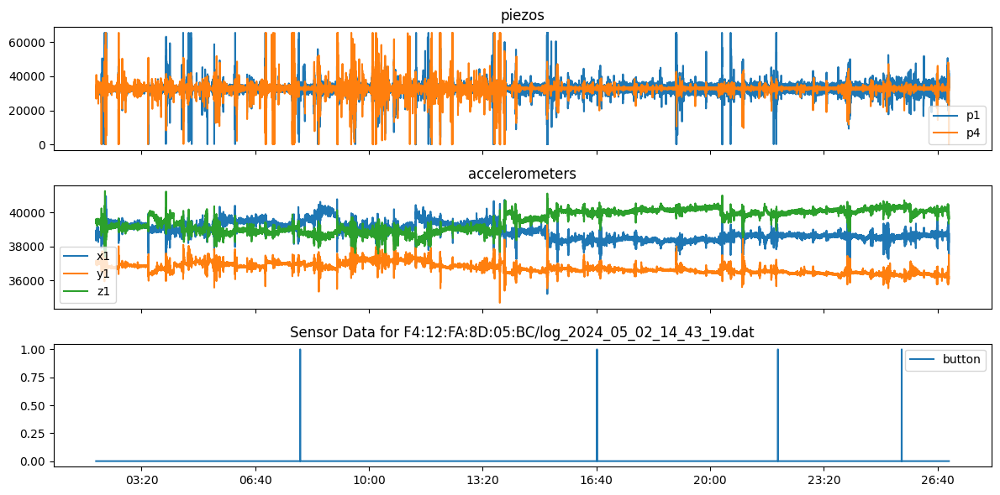



Session ID: F4:12:FA:8D:05:EC/log_2024_04_17_09_22_19.dat


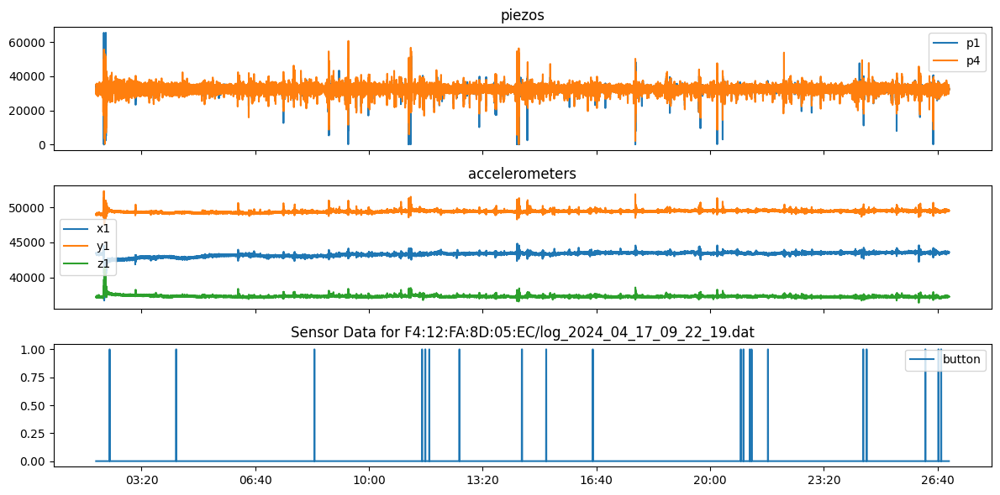

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 3&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-27 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_3.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_3.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 27), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:06:14/log_2024_05_09_14_47_25


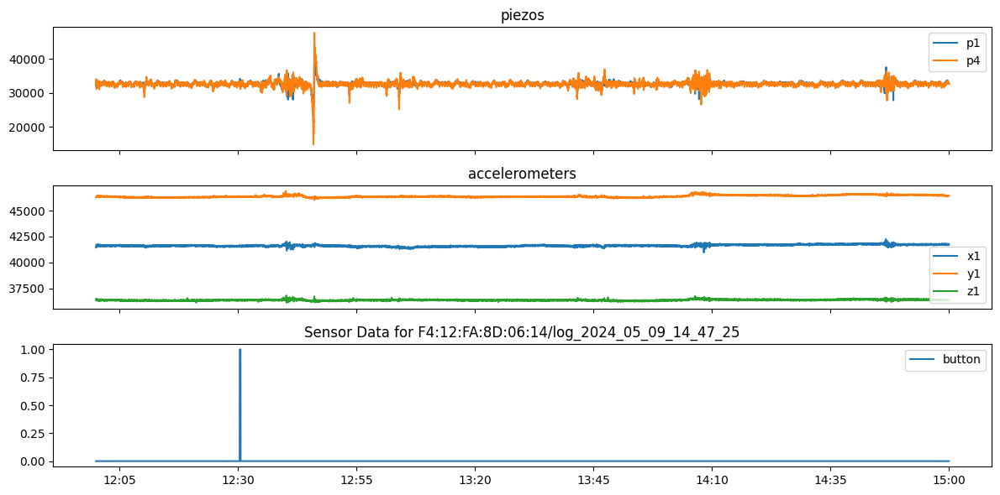



Session ID: F4:12:FA:8D:06:14/log_2024_05_23_14_26_42


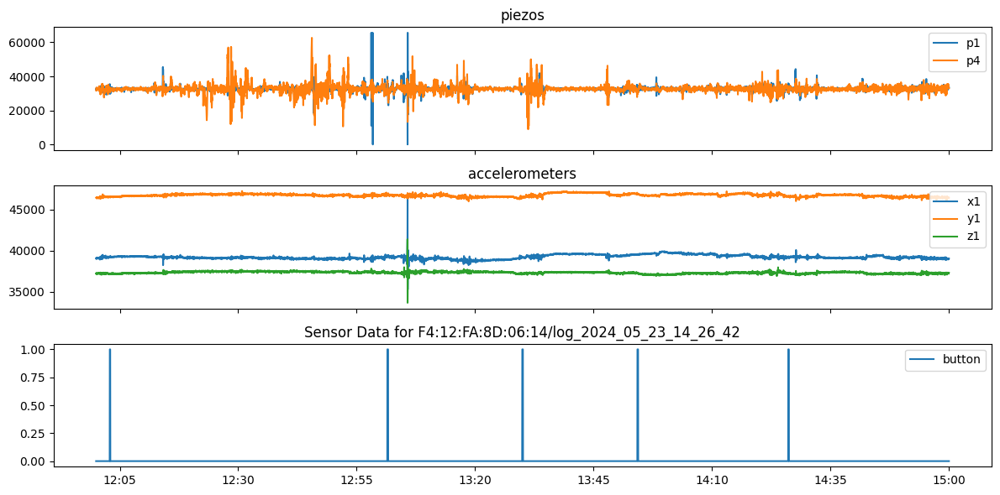



Session ID: F4:12:FA:8D:06:28/log_2024_05_23_11_32_00


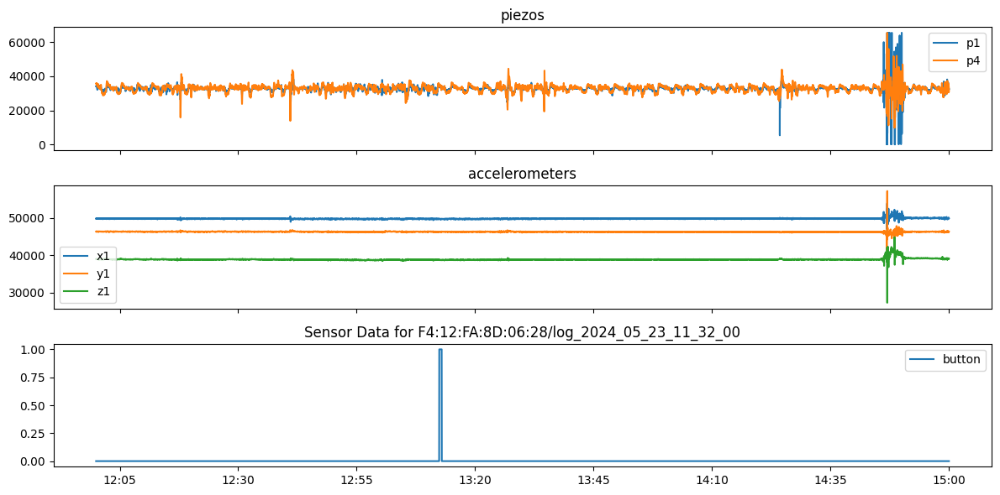



Session ID: F4:12:FA:8D:06:28/log_2024_06_06_09_13_55


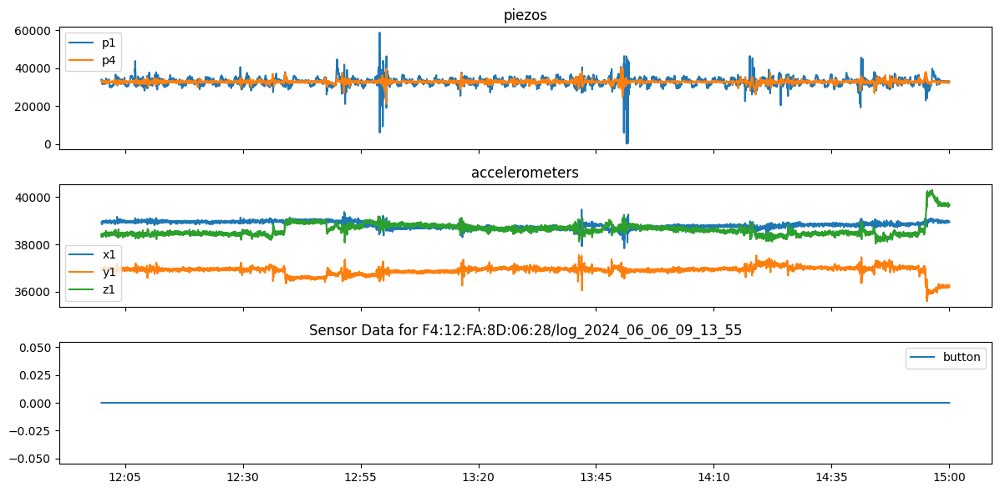



Session ID: F4:12:FA:8D:06:30/log_2024_05_27_11_06_06


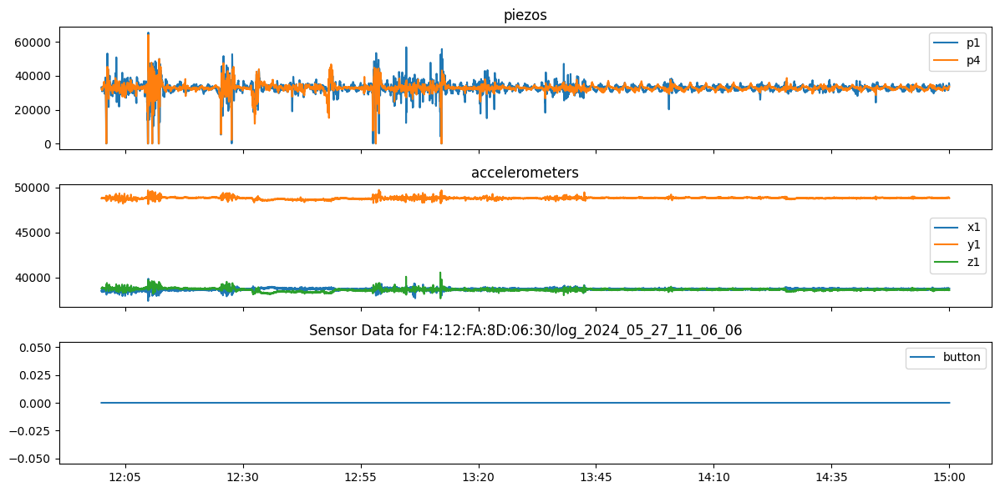



Session ID: F4:12:FA:8D:07:EC/log_2024_05_30_12_51_27


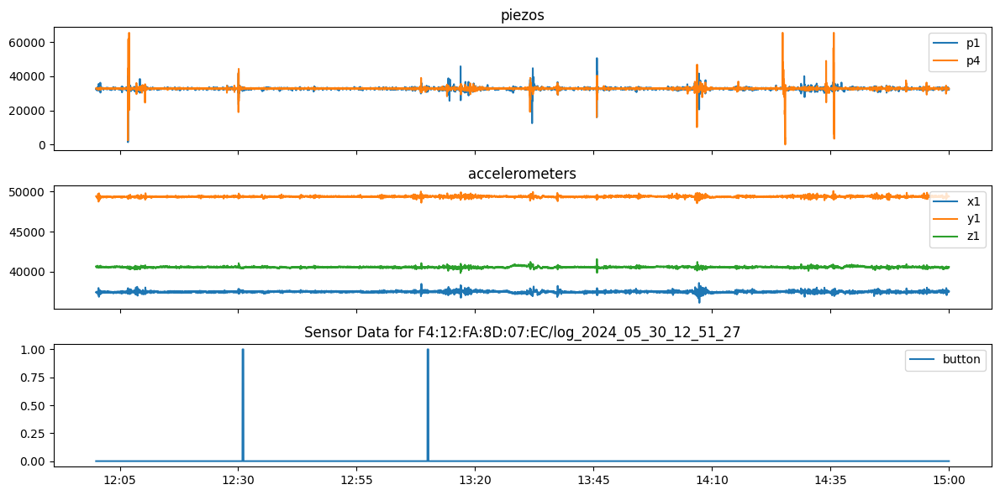



Session ID: F4:12:FA:8D:08:04/log_2024_05_20_10_17_50.dat


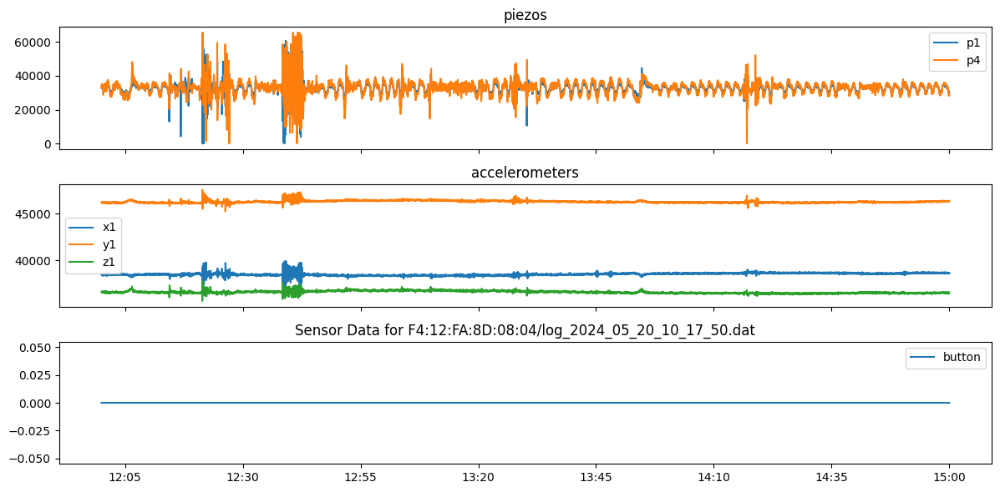



Session ID: F4:12:FA:8D:08:04/log_2024_06_06_13_26_49.dat


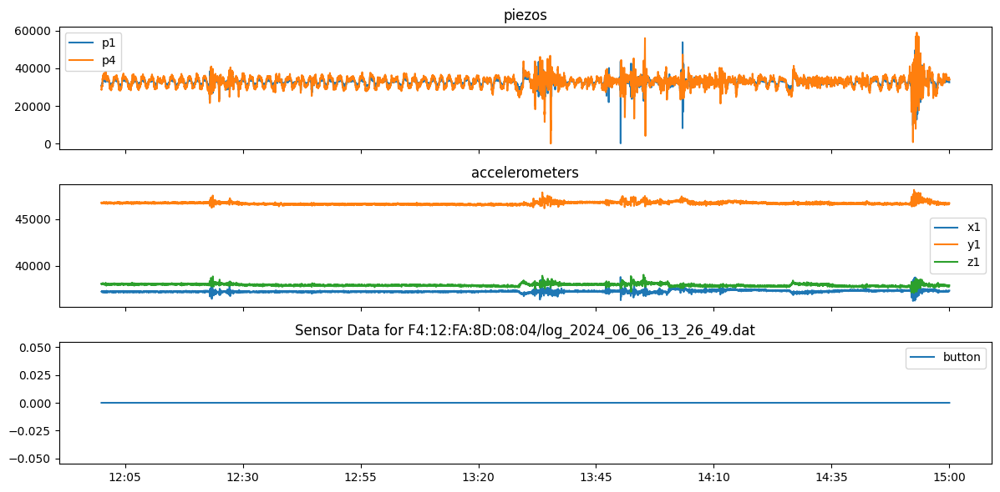



Session ID: F4:12:FA:8D:08:50/log_2024_06_05_12_44_16


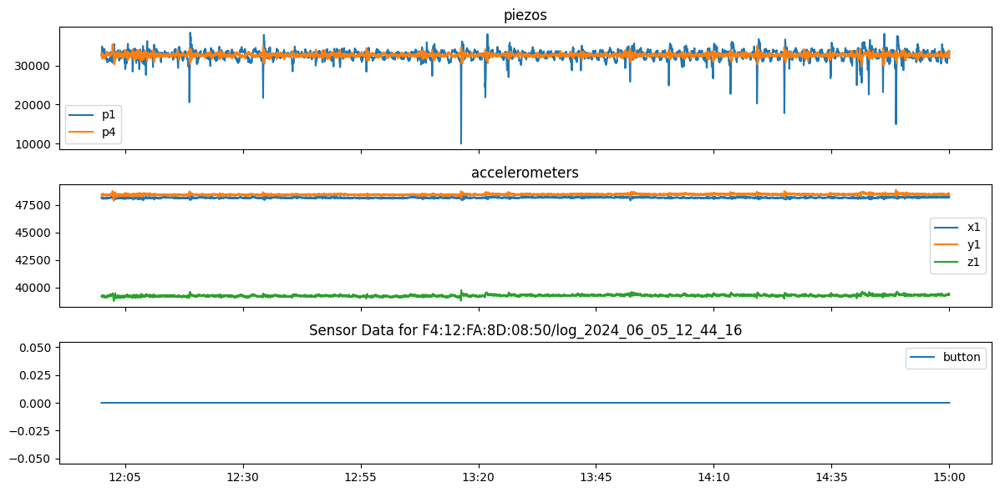



Session ID: F4:12:FA:8D:08:50/log_2024_06_19_11_00_56


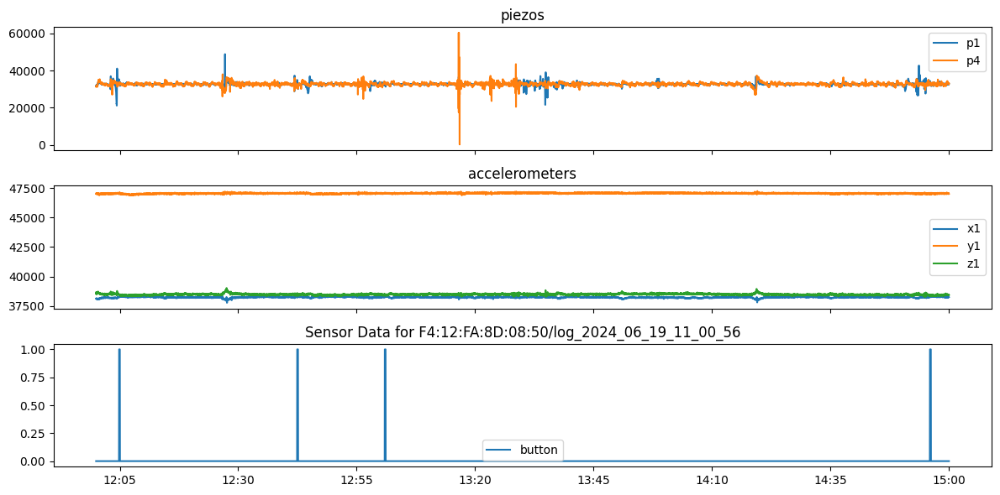

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 4&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 12-15 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_4.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_4.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(12, 15), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50


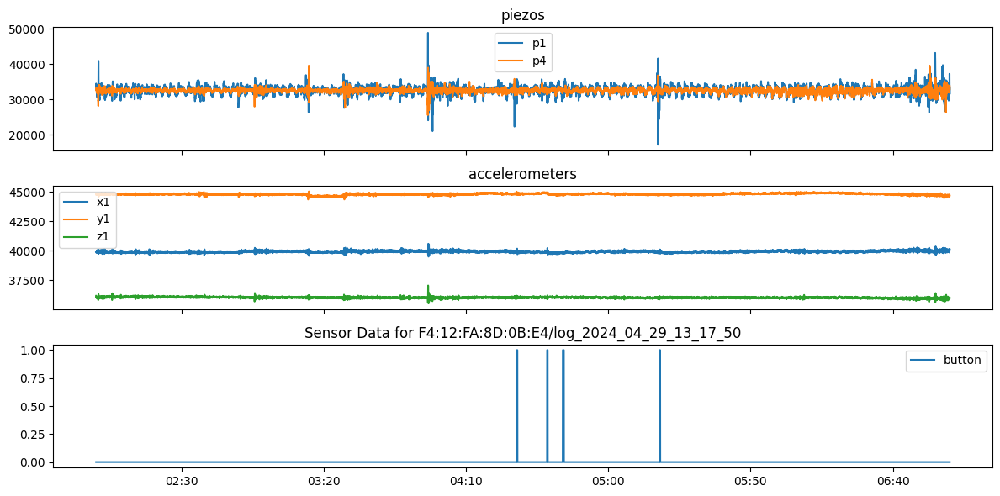



Session ID: F4:12:FA:8D:0B:E4/log_2024_05_13_13_45_27.dat


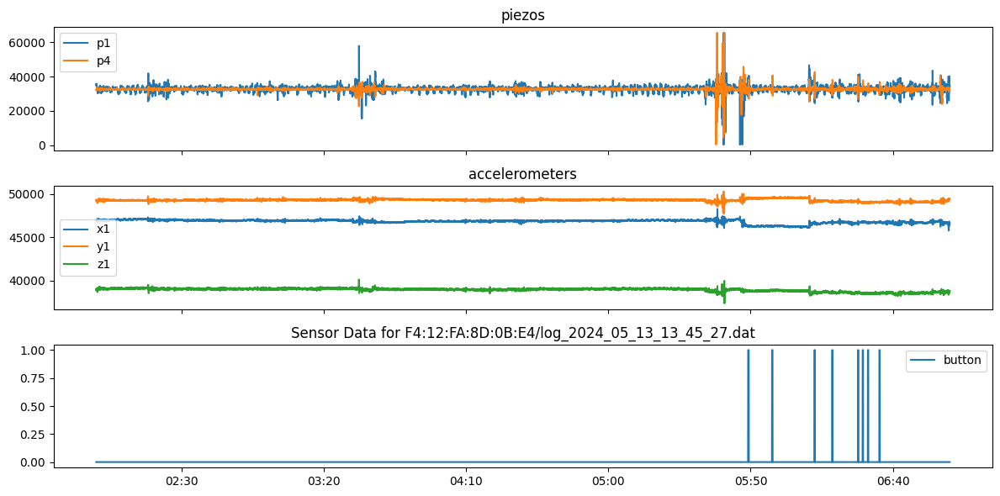



Session ID: F4:12:FA:8D:0C:10/log_2024_05_01_10_44_44


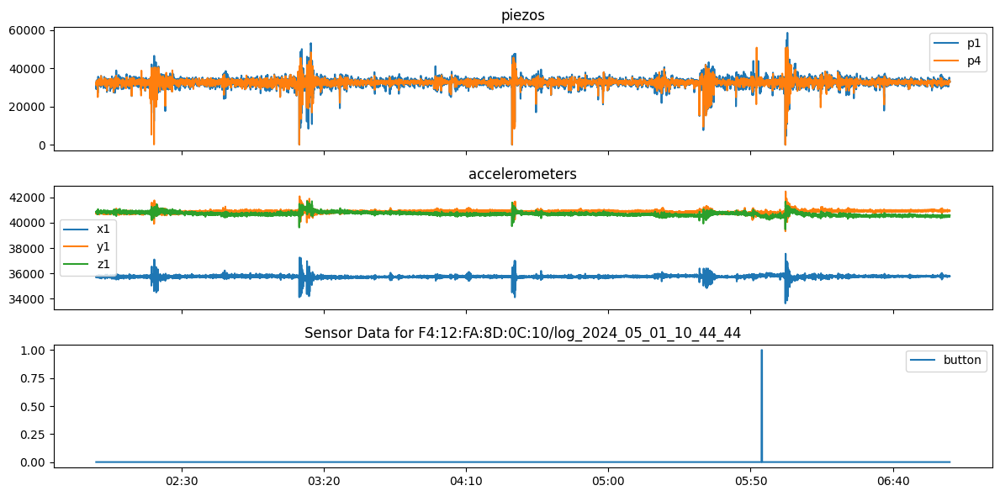



Session ID: F4:12:FA:8D:0C:10/log_2024_05_15_11_45_20


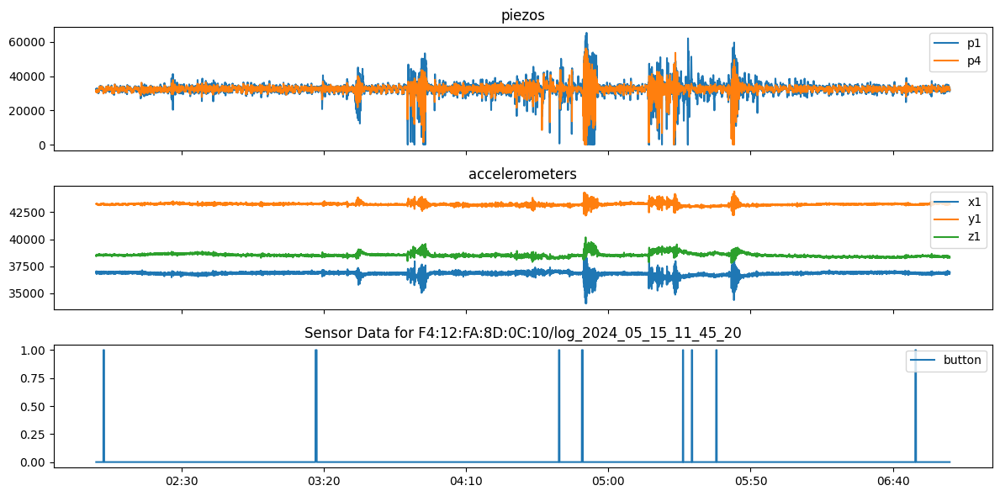



Session ID: F4:12:FA:8D:12:D4/log_2024_04_17_14_18_31.dat


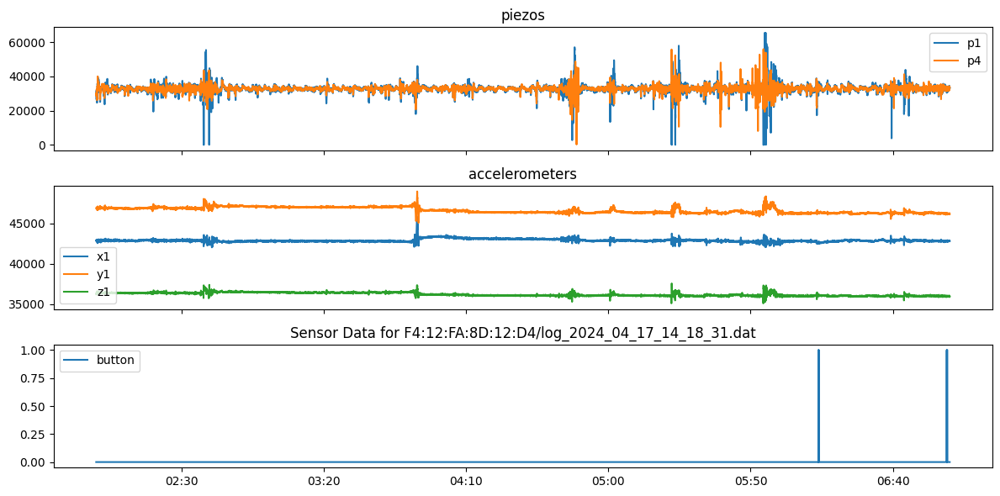



Session ID: F4:12:FA:8D:12:D4/log_2024_05_01_12_08_04.dat


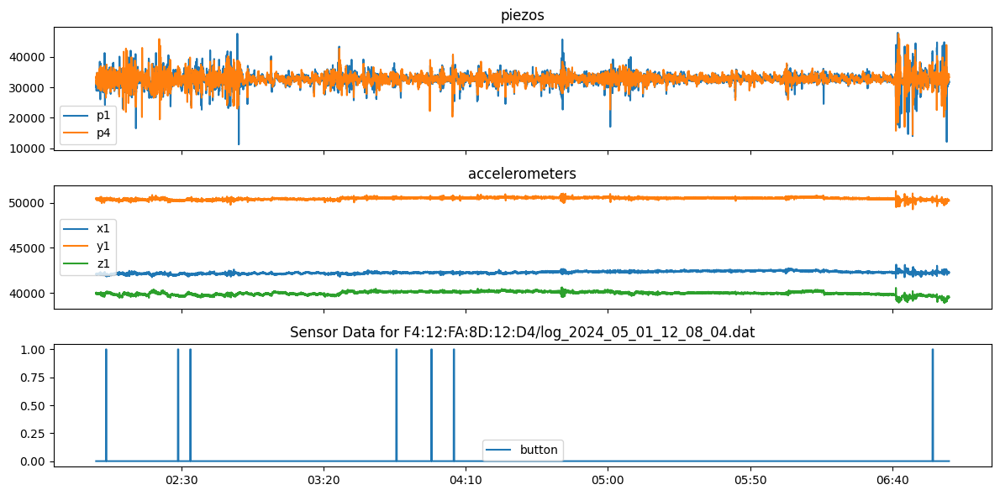

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 5&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 12-15 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_5.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_5.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 7), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:06:14/log_2024_05_09_14_47_25


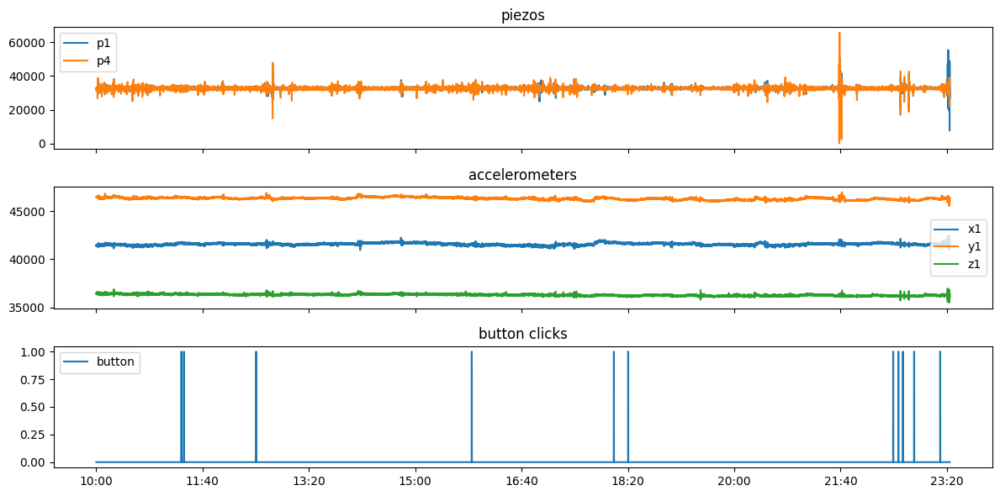



Session ID: F4:12:FA:8D:06:14/log_2024_05_23_14_26_42


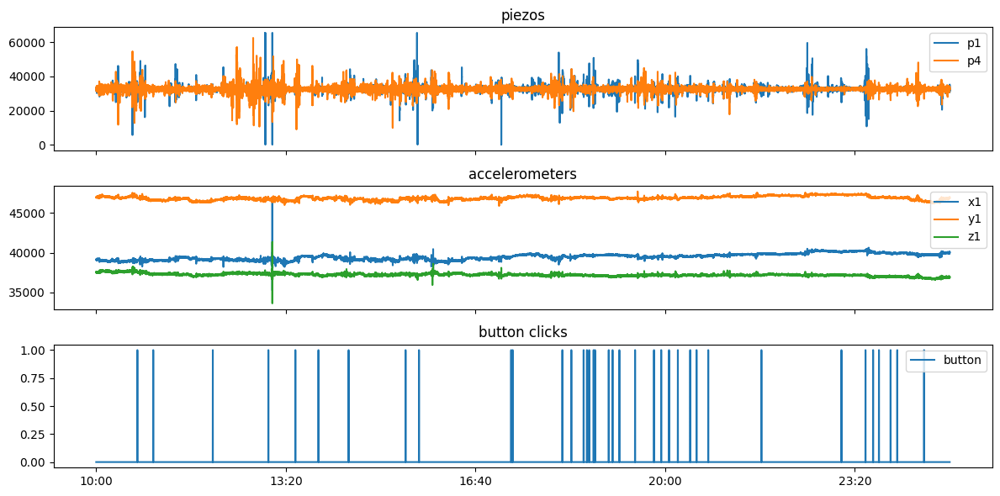



Session ID: F4:12:FA:8D:06:28/log_2024_05_23_11_32_00


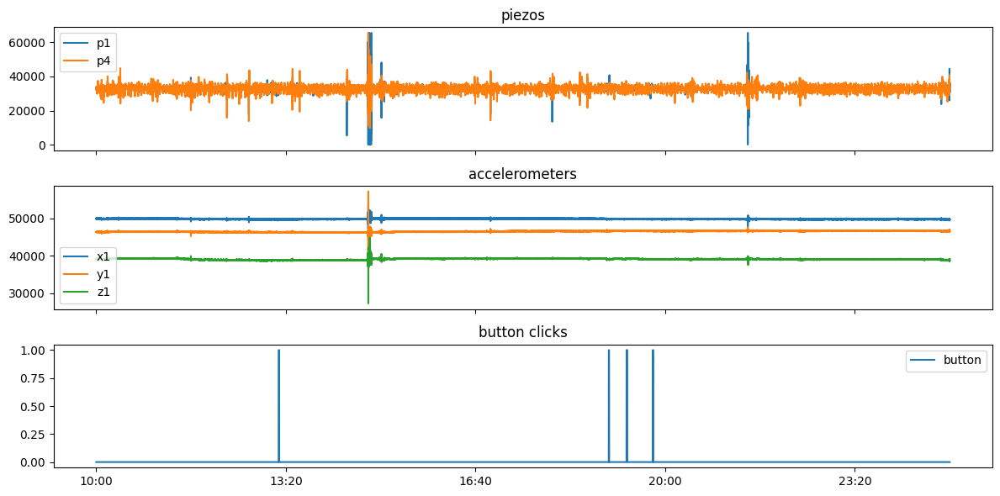



Session ID: F4:12:FA:8D:06:28/log_2024_06_06_09_13_55


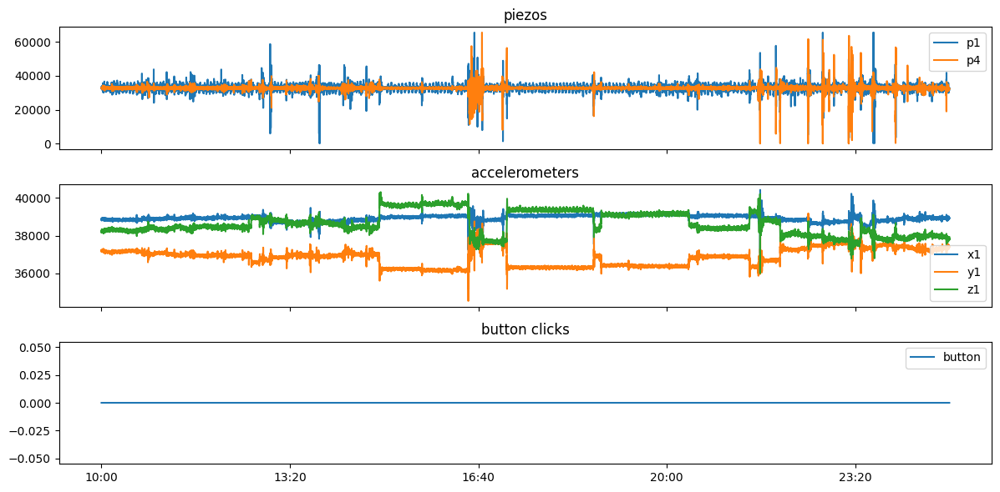



Session ID: F4:12:FA:8D:06:30/log_2024_05_27_11_06_06


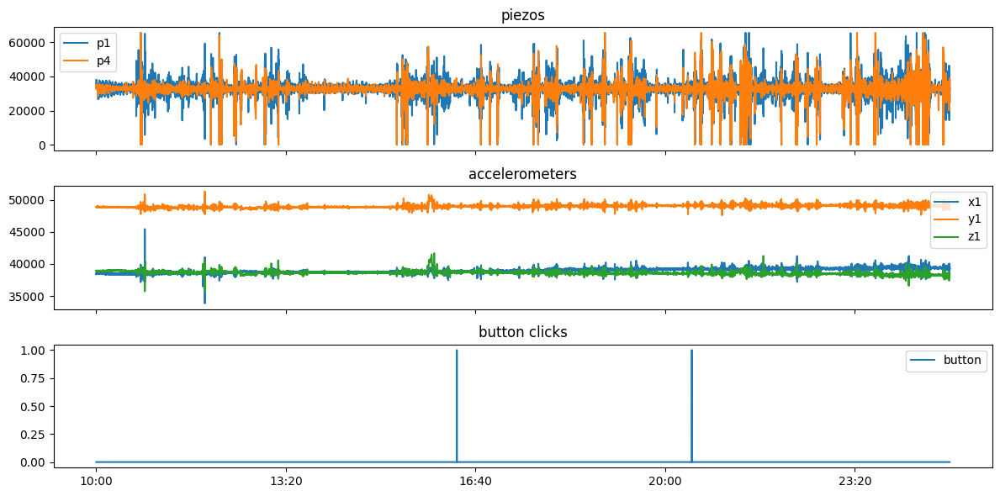



Session ID: F4:12:FA:8D:07:EC/log_2024_05_30_12_51_27


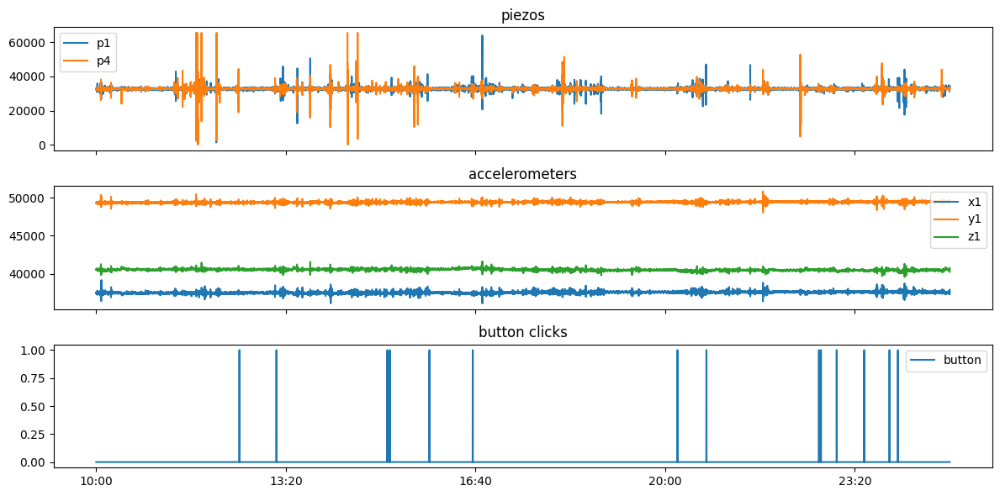



Session ID: F4:12:FA:8D:08:04/log_2024_05_20_10_17_50.dat


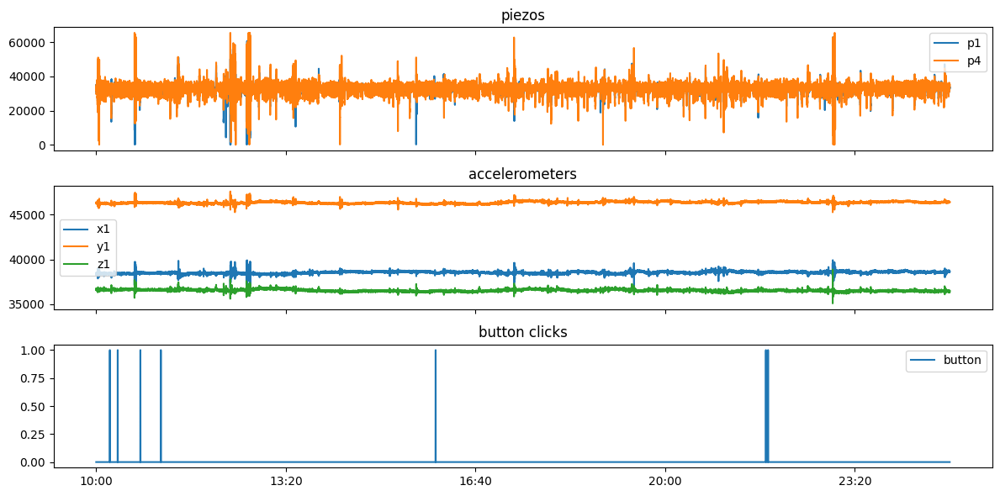



Session ID: F4:12:FA:8D:08:04/log_2024_06_06_13_26_49.dat


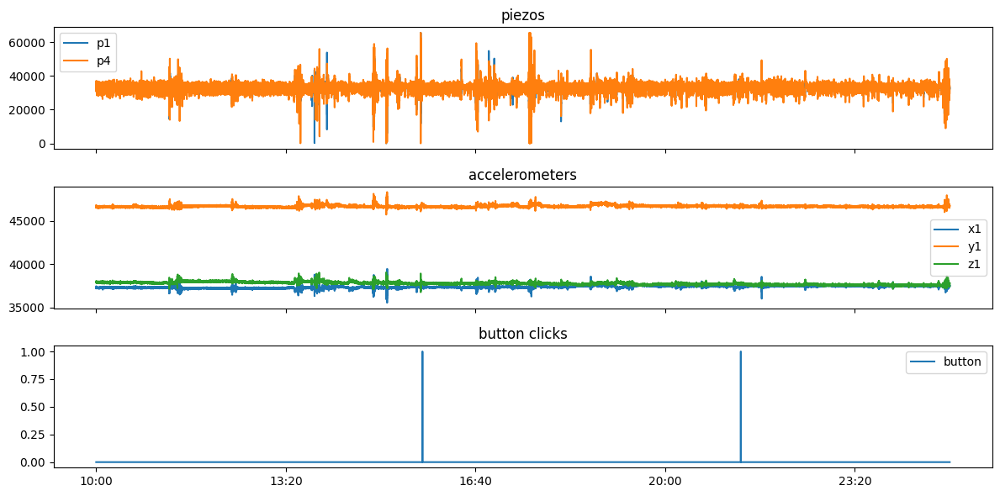



Session ID: F4:12:FA:8D:08:50/log_2024_06_05_12_44_16


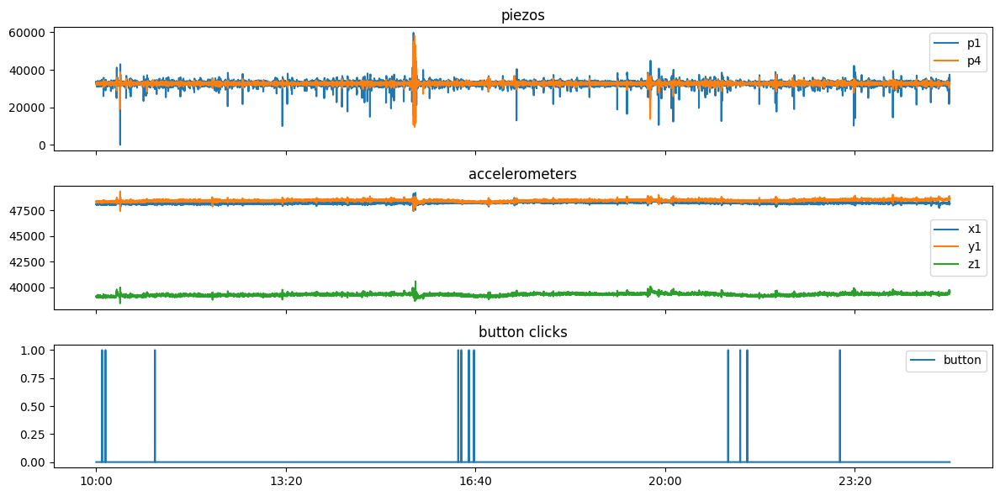



Session ID: F4:12:FA:8D:08:50/log_2024_06_19_11_00_56


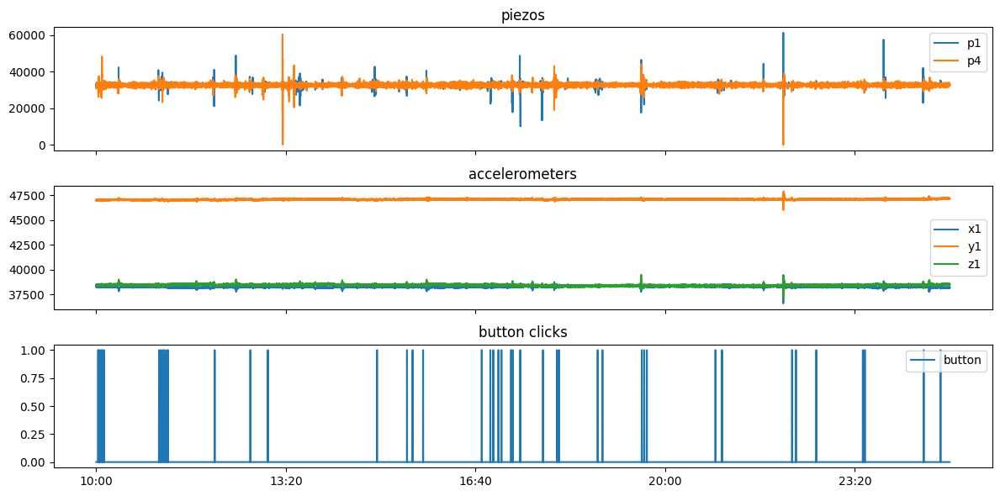

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 4&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 10-25 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_4.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_4.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(10, 25), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:06:14/log_2024_05_09_14_47_25


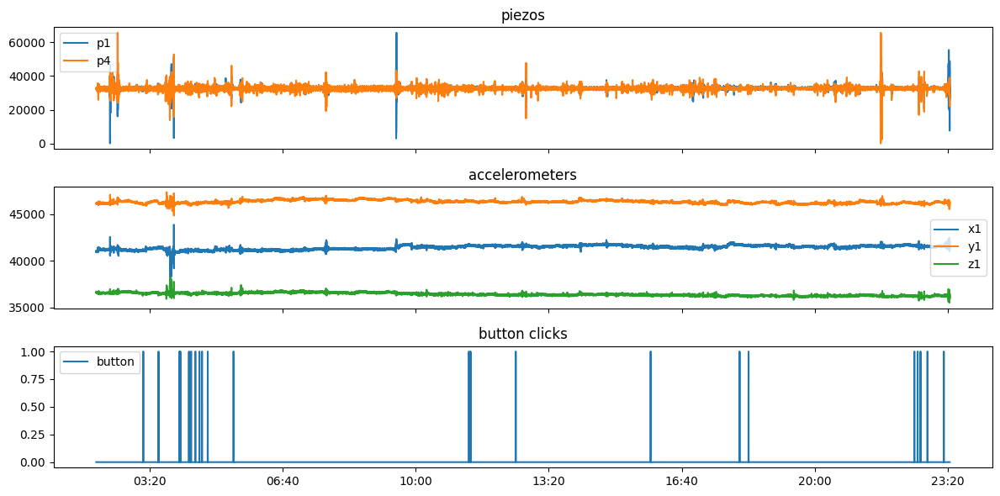



Session ID: F4:12:FA:8D:06:14/log_2024_05_23_14_26_42


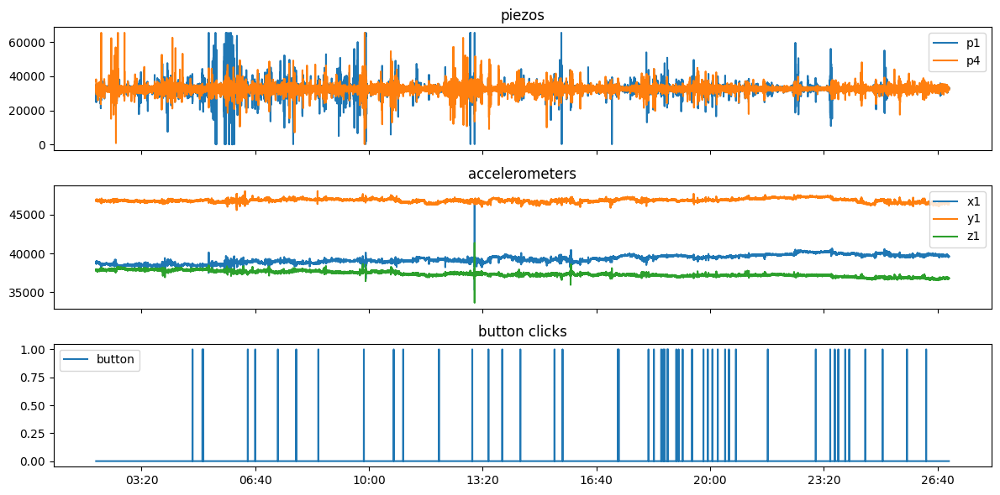



Session ID: F4:12:FA:8D:06:28/log_2024_05_23_11_32_00


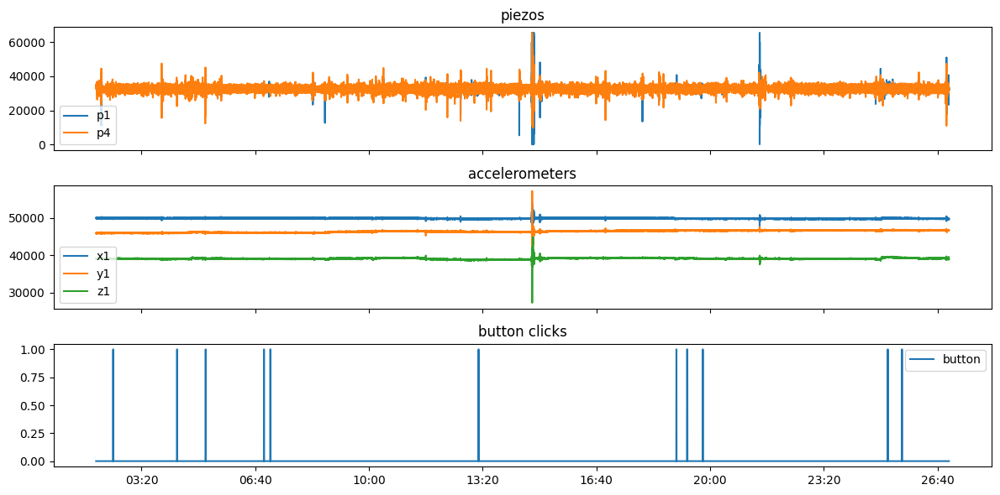



Session ID: F4:12:FA:8D:06:28/log_2024_06_06_09_13_55


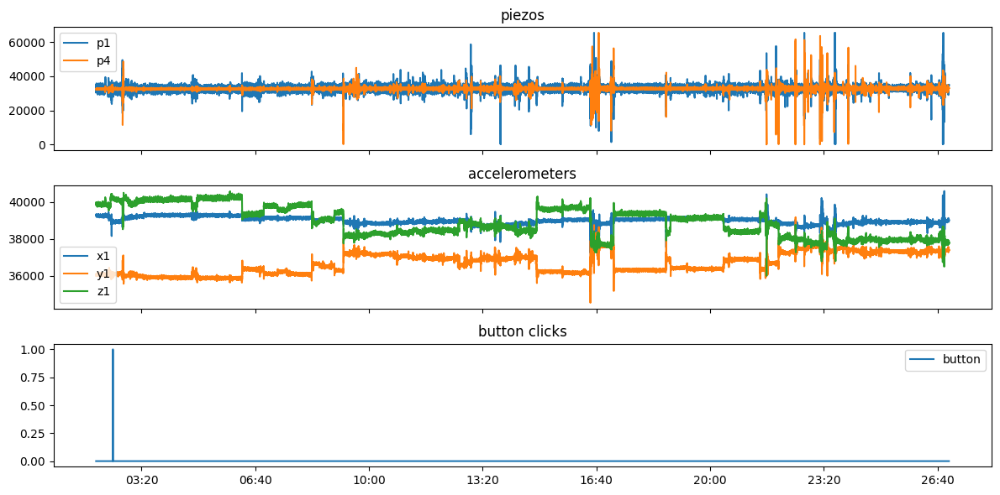



Session ID: F4:12:FA:8D:06:30/log_2024_05_27_11_06_06


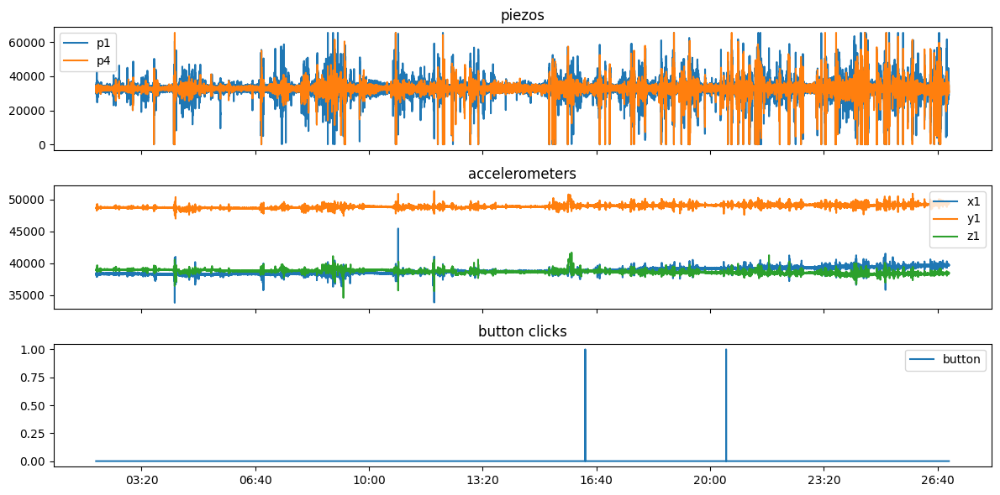



Session ID: F4:12:FA:8D:07:EC/log_2024_05_30_12_51_27


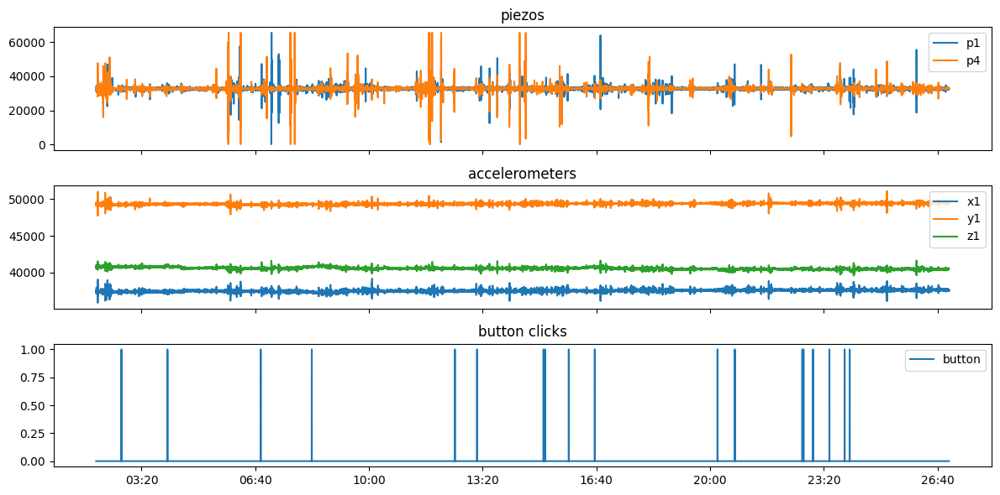



Session ID: F4:12:FA:8D:08:04/log_2024_05_20_10_17_50.dat


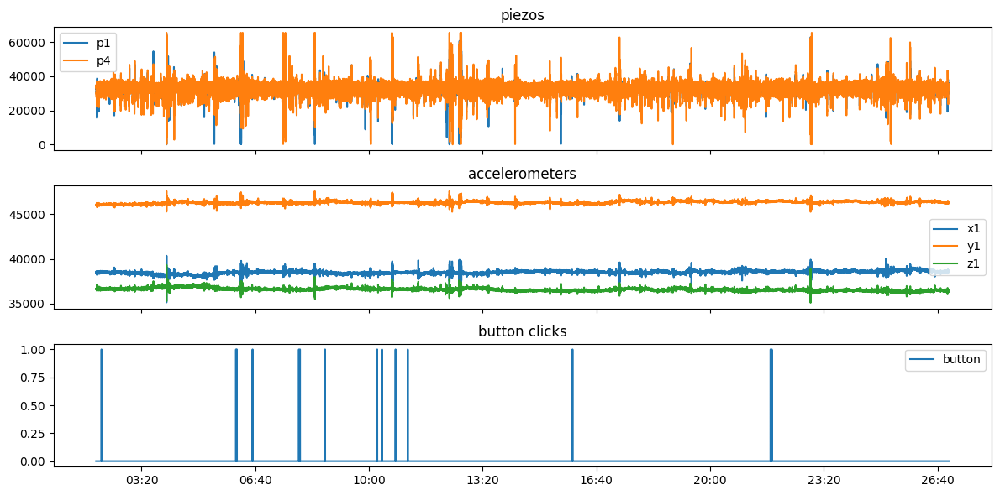



Session ID: F4:12:FA:8D:08:04/log_2024_06_06_13_26_49.dat


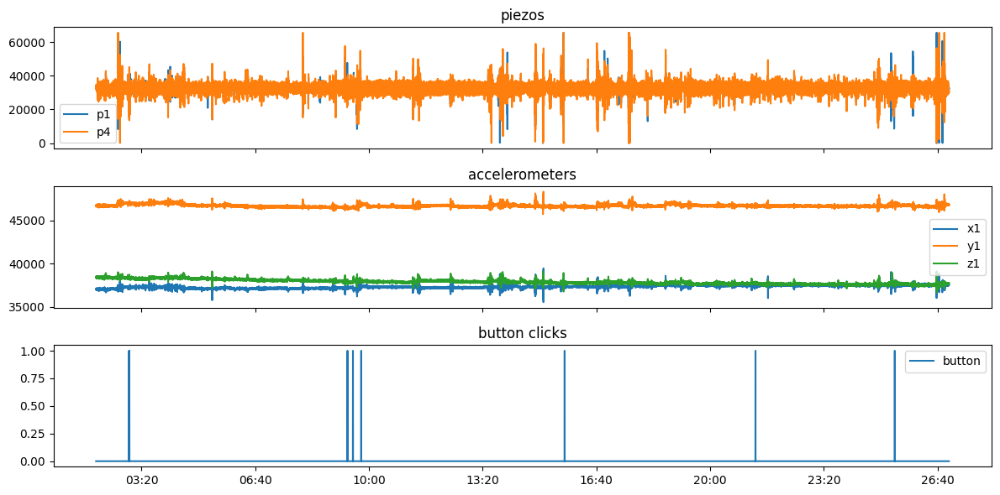



Session ID: F4:12:FA:8D:08:50/log_2024_06_05_12_44_16


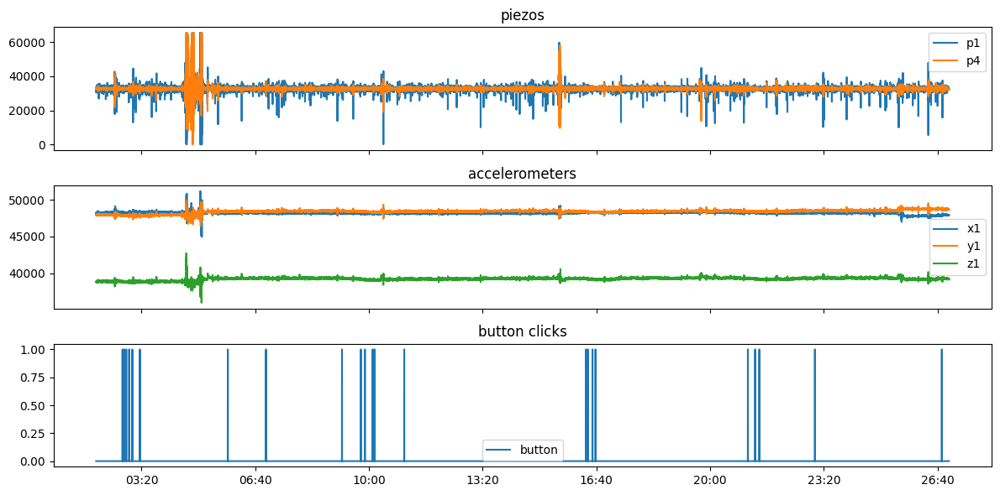



Session ID: F4:12:FA:8D:08:50/log_2024_06_19_11_00_56


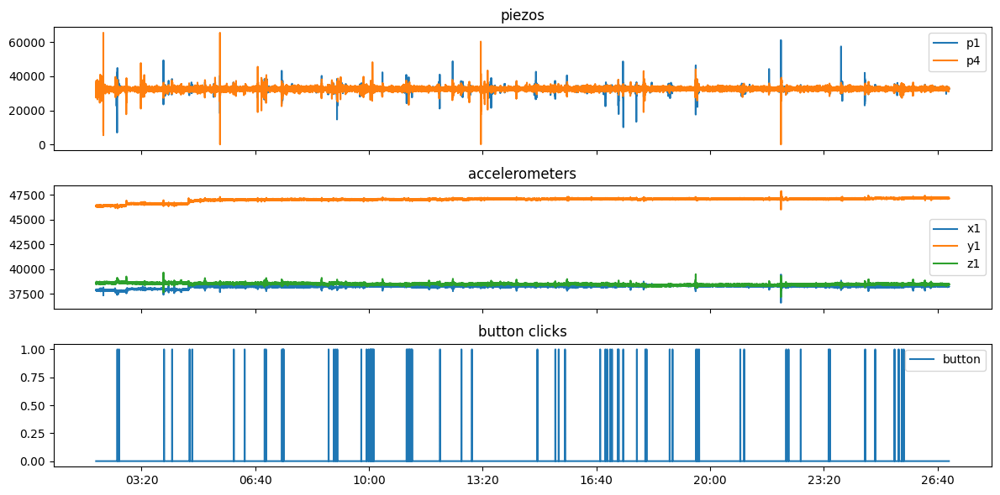

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 4&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-27 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_4.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_4.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 27), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50


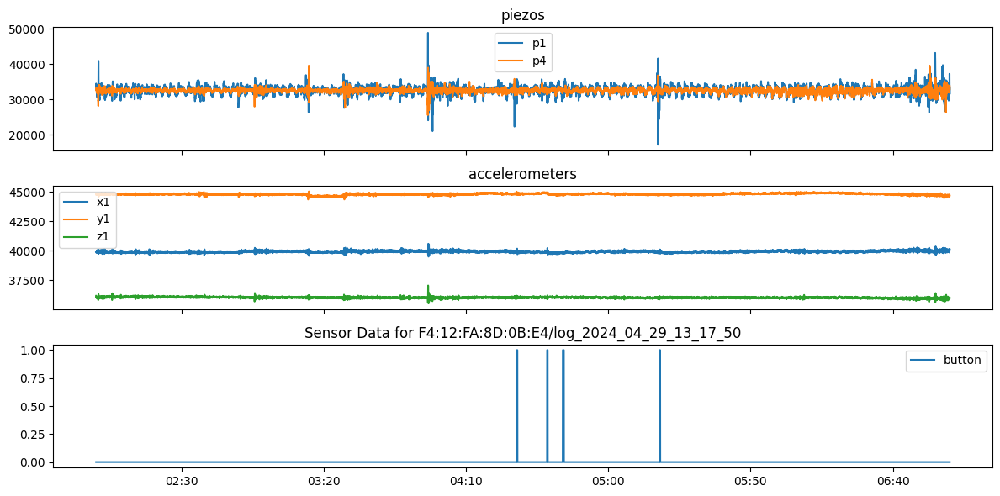



Session ID: F4:12:FA:8D:0B:E4/log_2024_05_13_13_45_27.dat


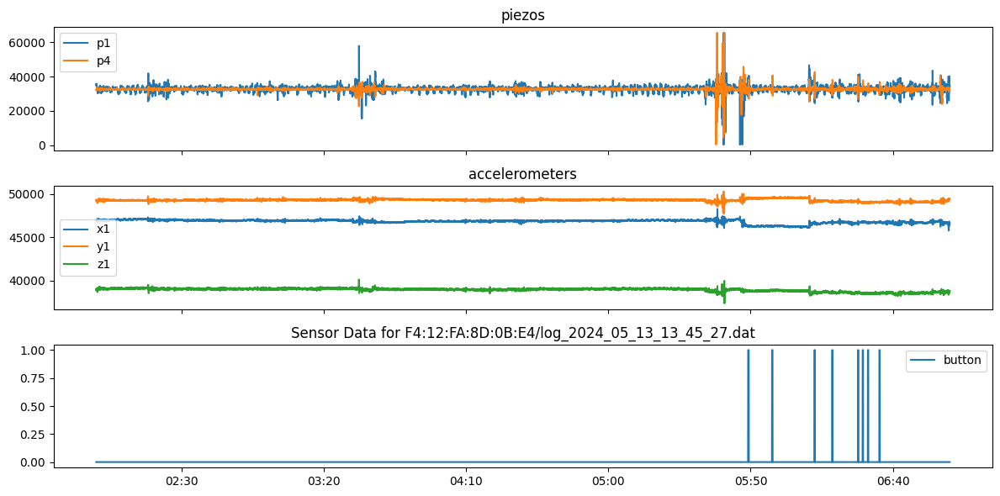



Session ID: F4:12:FA:8D:0C:10/log_2024_05_01_10_44_44


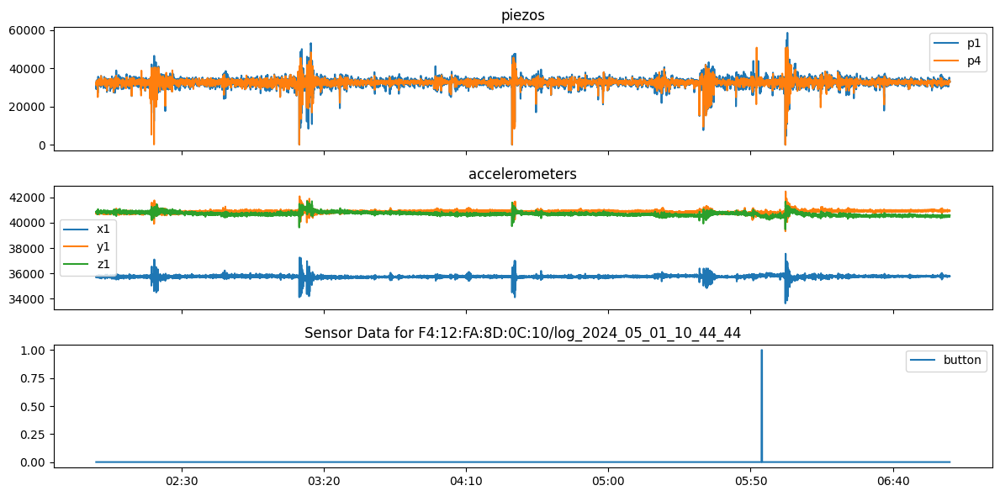



Session ID: F4:12:FA:8D:0C:10/log_2024_05_15_11_45_20


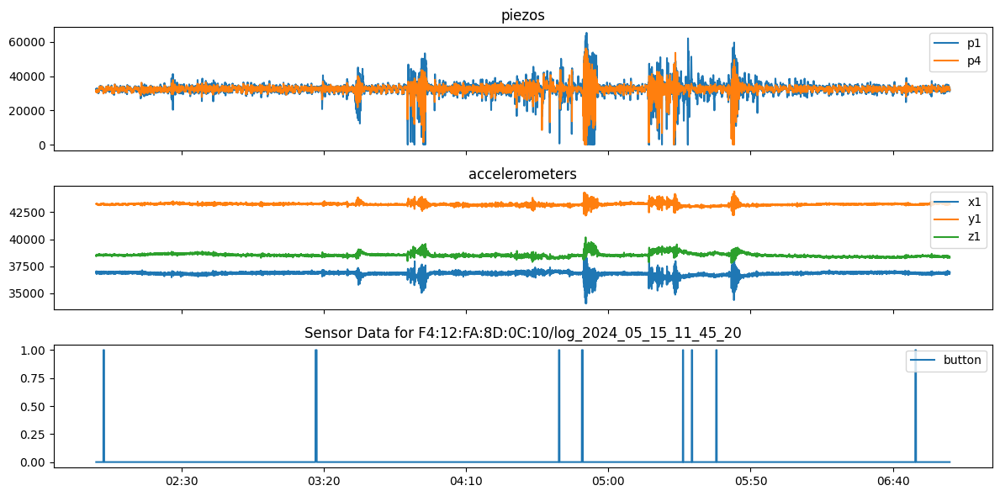



Session ID: F4:12:FA:8D:12:D4/log_2024_04_17_14_18_31.dat


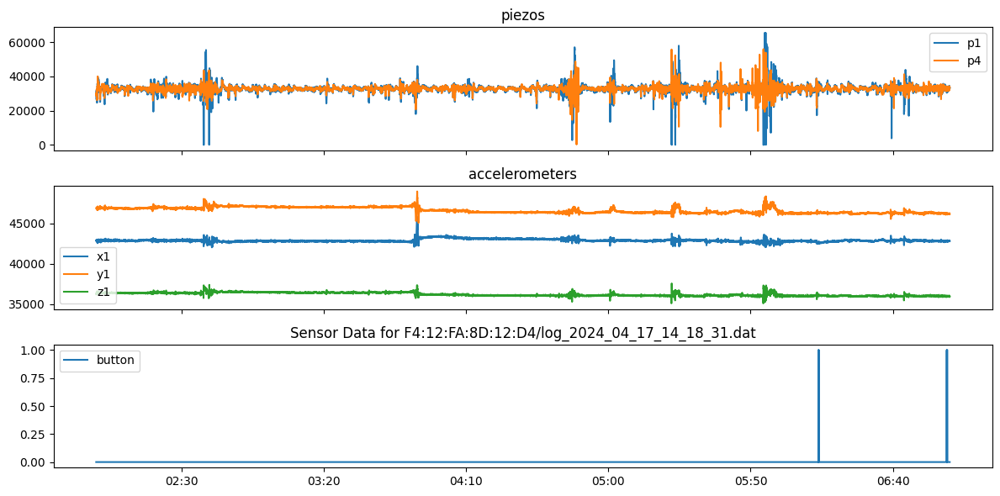



Session ID: F4:12:FA:8D:12:D4/log_2024_05_01_12_08_04.dat


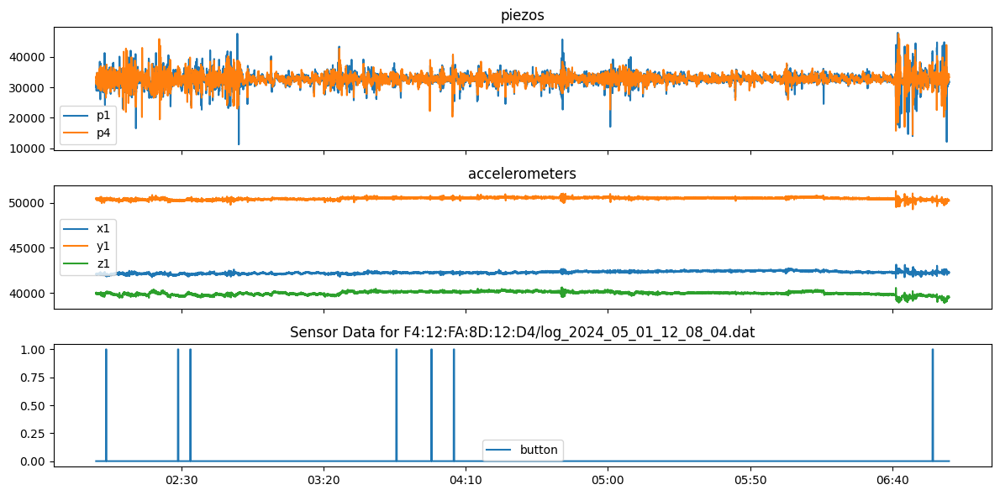

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 4&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-7 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_5.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_5.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 7), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50


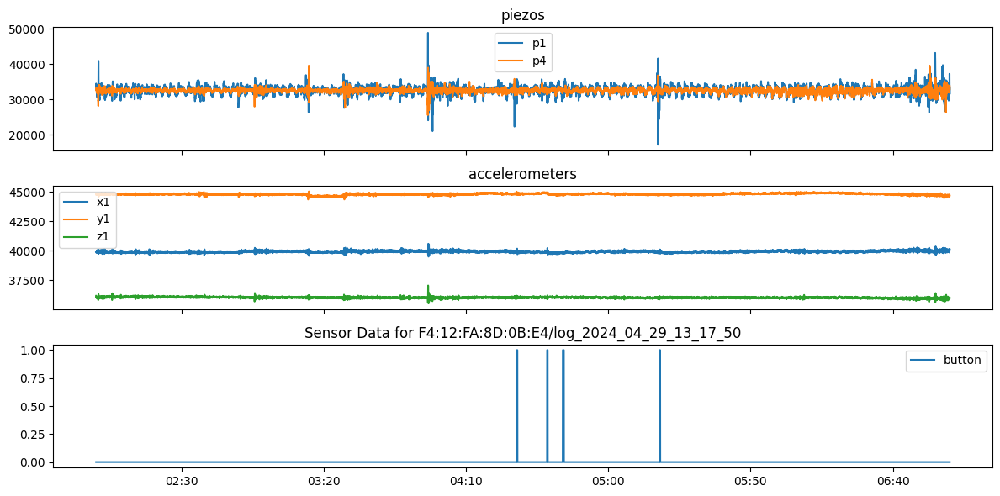



Session ID: F4:12:FA:8D:0B:E4/log_2024_05_13_13_45_27.dat


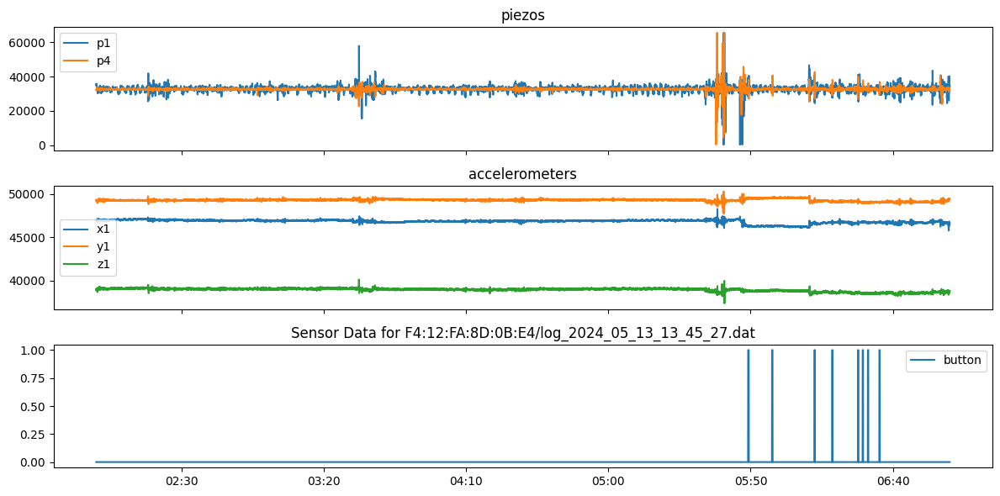



Session ID: F4:12:FA:8D:0C:10/log_2024_05_01_10_44_44


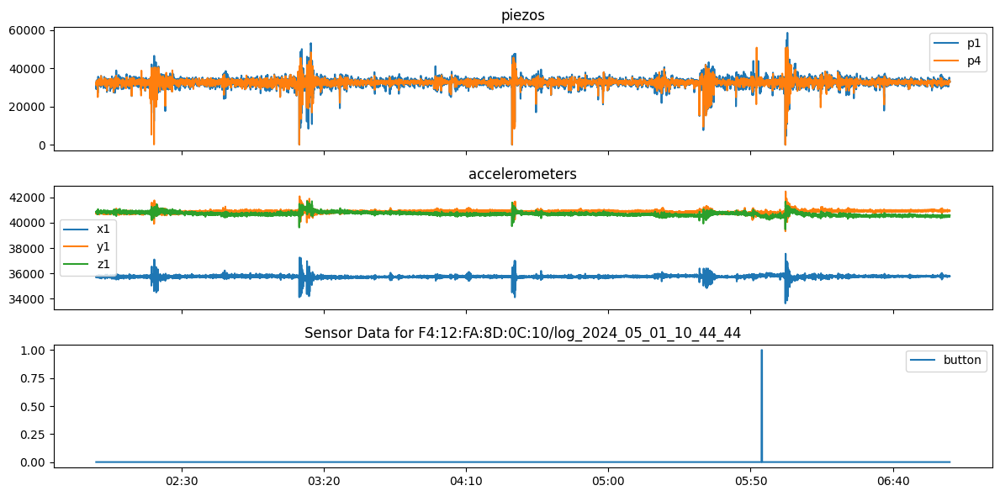



Session ID: F4:12:FA:8D:0C:10/log_2024_05_15_11_45_20


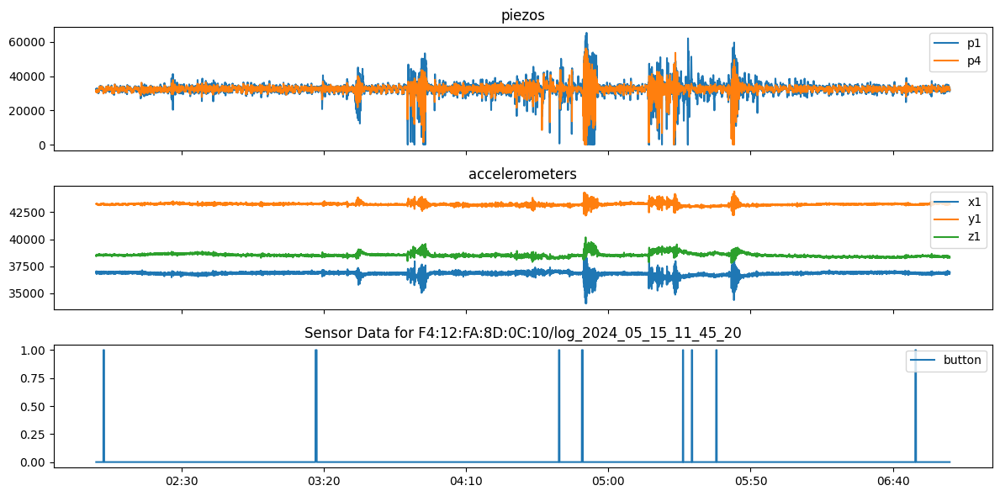



Session ID: F4:12:FA:8D:12:D4/log_2024_04_17_14_18_31.dat


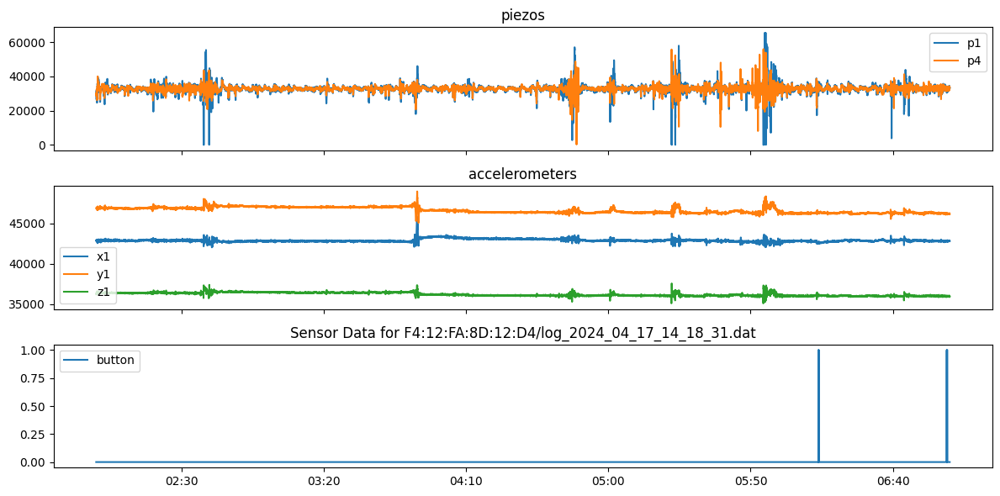



Session ID: F4:12:FA:8D:12:D4/log_2024_05_01_12_08_04.dat


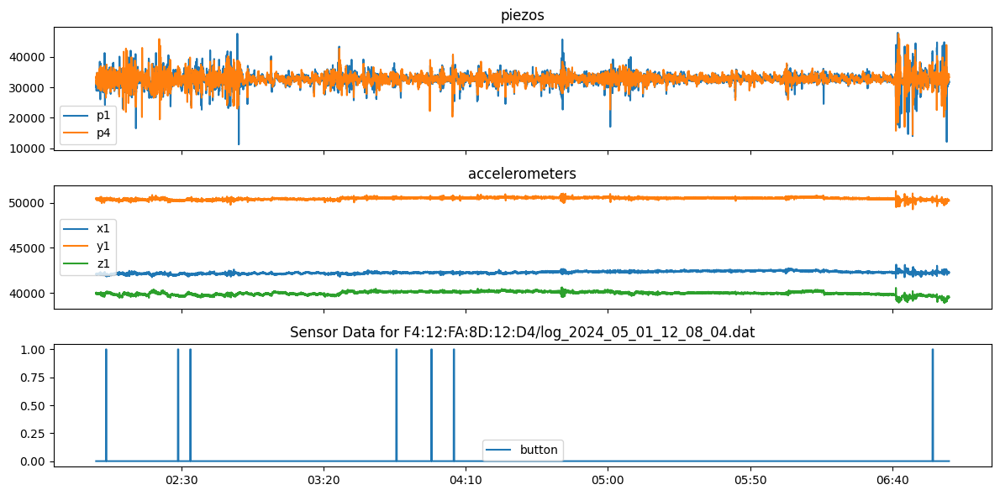

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 5&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-7 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_5.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_5.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 7), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50


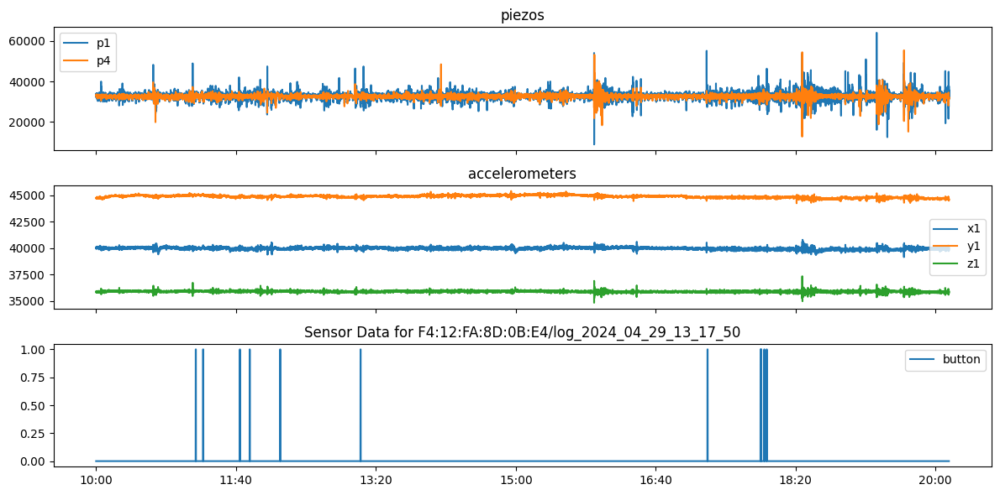



Session ID: F4:12:FA:8D:0B:E4/log_2024_05_13_13_45_27.dat


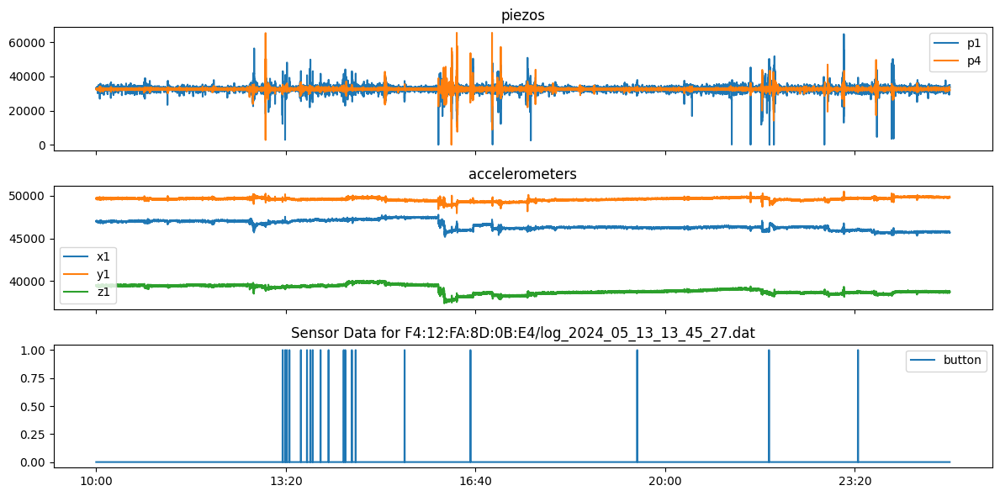



Session ID: F4:12:FA:8D:0C:10/log_2024_05_01_10_44_44


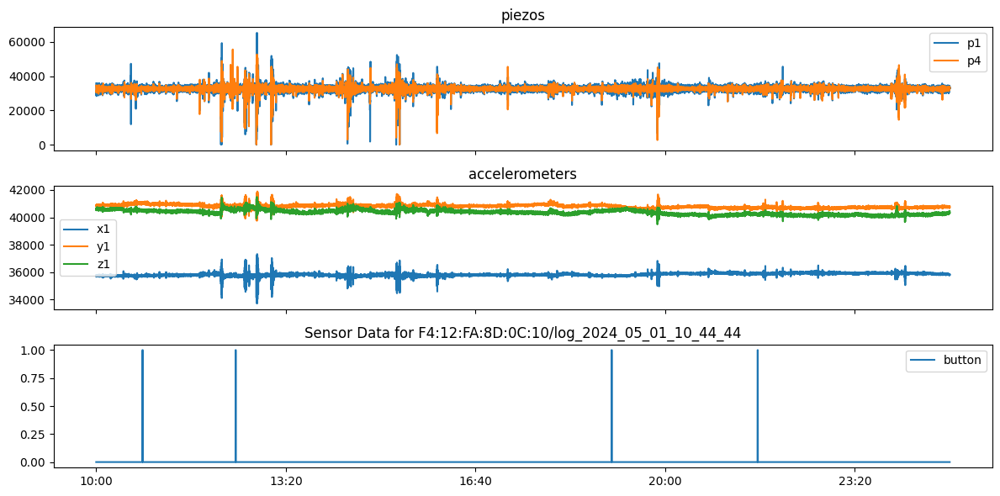



Session ID: F4:12:FA:8D:0C:10/log_2024_05_15_11_45_20


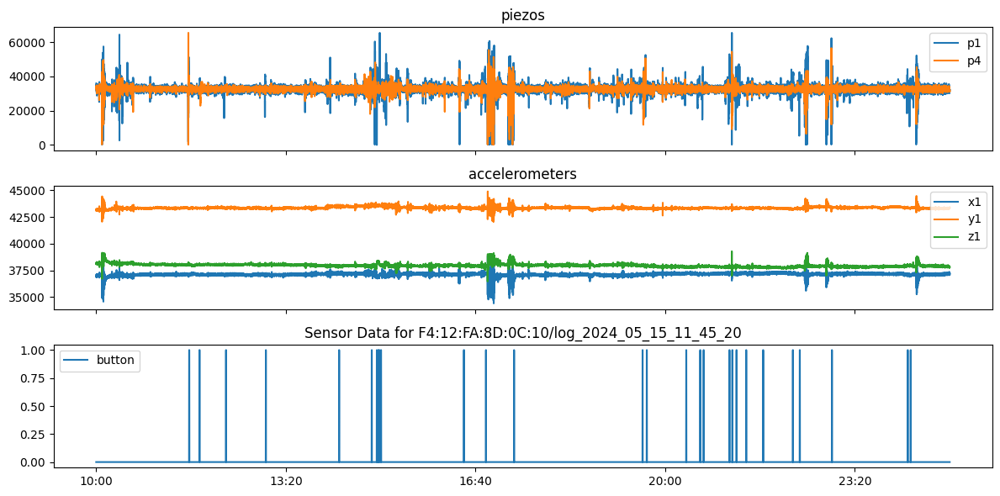



Session ID: F4:12:FA:8D:12:D4/log_2024_04_17_14_18_31.dat


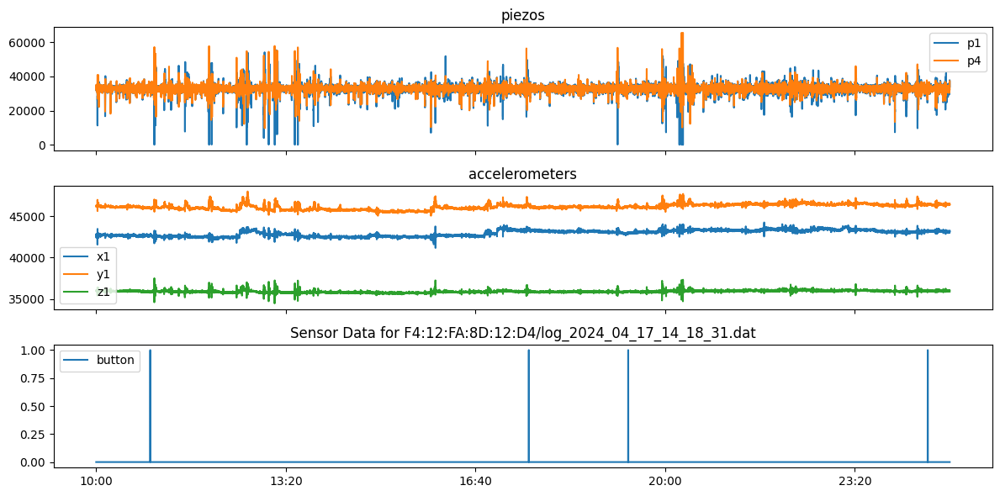



Session ID: F4:12:FA:8D:12:D4/log_2024_05_01_12_08_04.dat


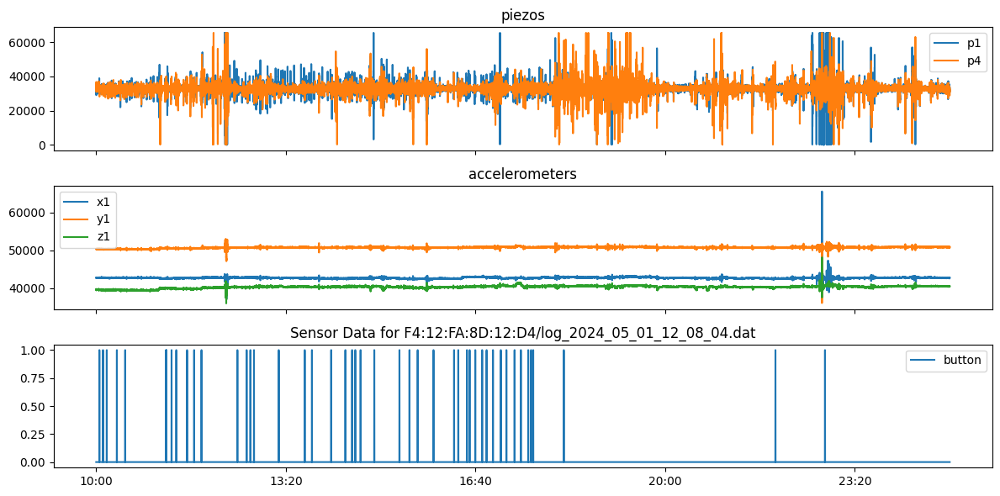

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 5&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 10-25 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_5.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_5.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(10, 25), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot



Session ID: F4:12:FA:8D:0B:E4/log_2024_04_29_13_17_50


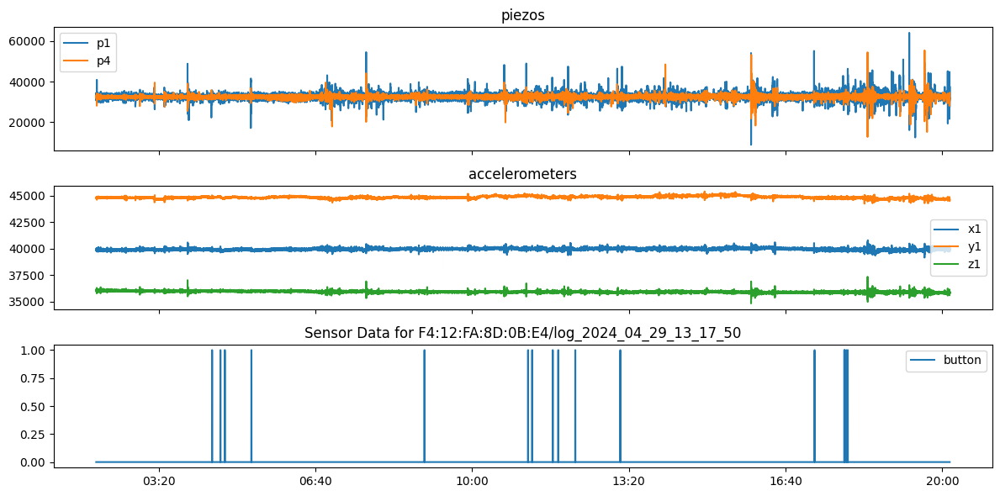



Session ID: F4:12:FA:8D:0B:E4/log_2024_05_13_13_45_27.dat


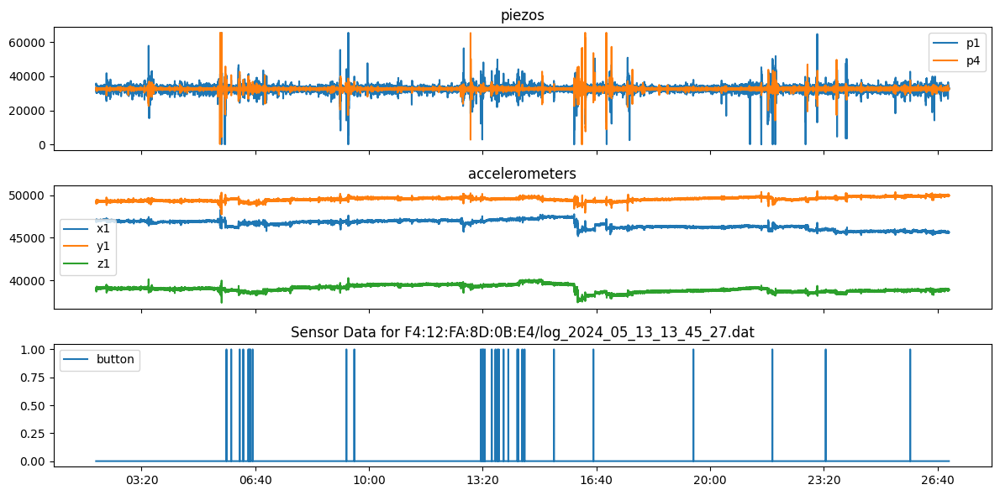



Session ID: F4:12:FA:8D:0C:10/log_2024_05_01_10_44_44


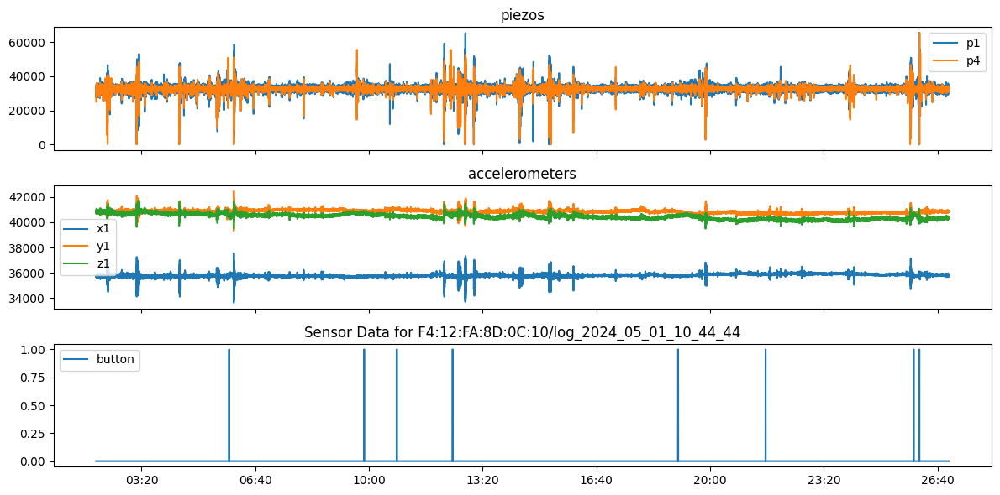



Session ID: F4:12:FA:8D:0C:10/log_2024_05_15_11_45_20


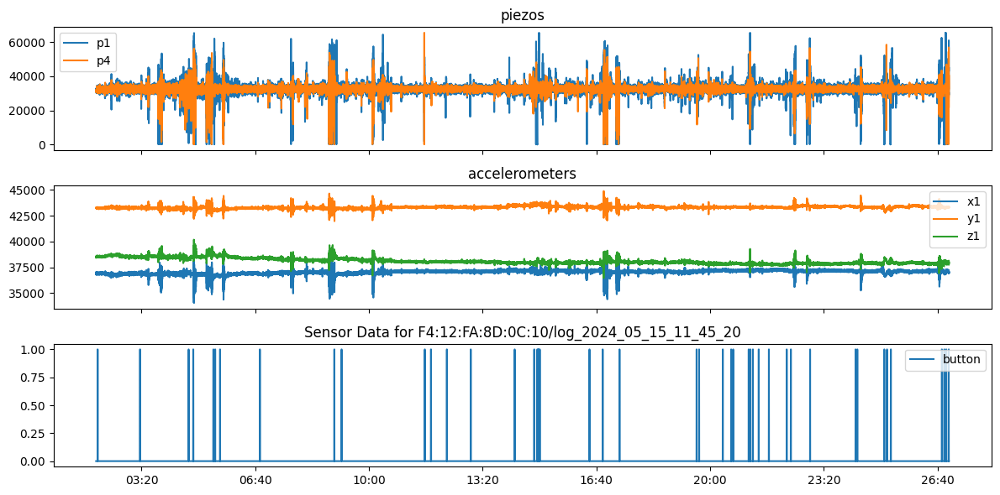



Session ID: F4:12:FA:8D:12:D4/log_2024_04_17_14_18_31.dat


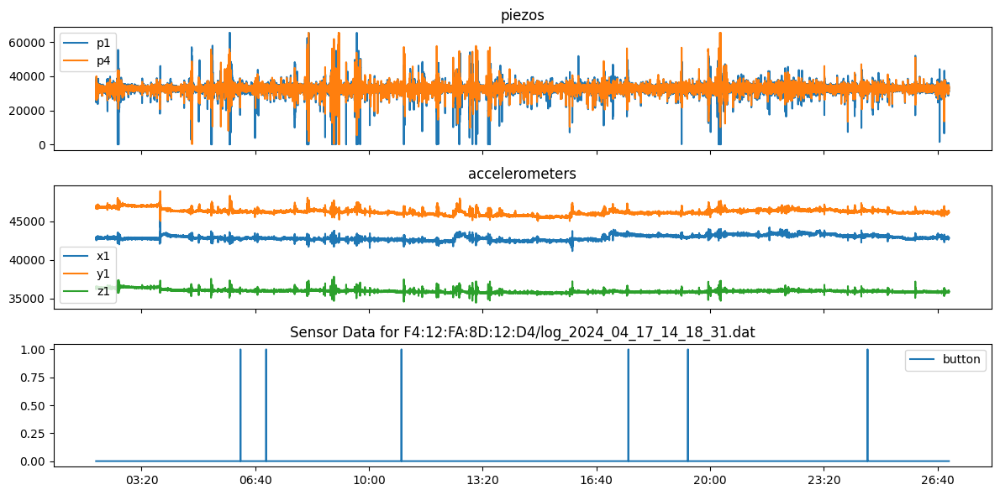



Session ID: F4:12:FA:8D:12:D4/log_2024_05_01_12_08_04.dat


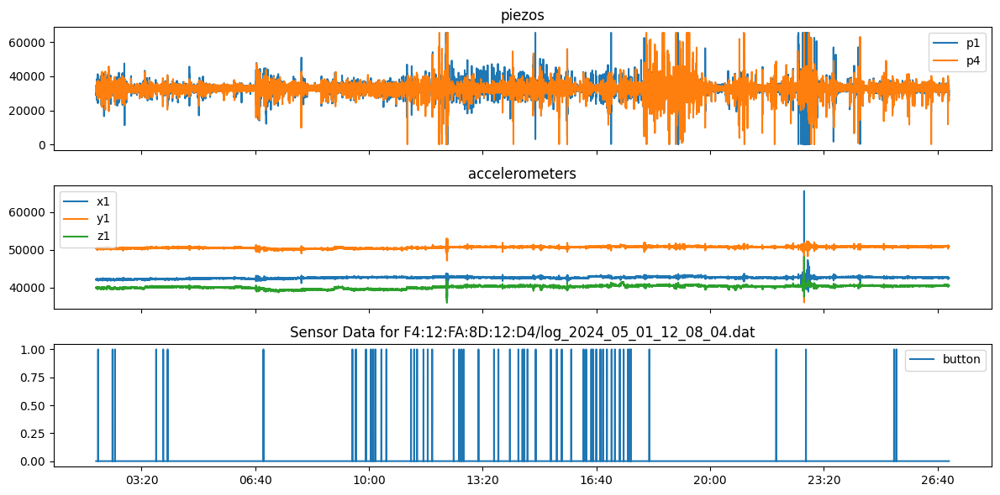

In [ ]:
display(HTML('<font size="5"><b>Analysis of Hospital Sessions</b></font>'))
display(HTML('<font size="4"><b>Batch: 5&nbsp;&nbsp;&nbsp;&nbsp;Period of session: 2-27 minutes</b></font>'))

for s3key in df_hospital_logfiles_batch_5.index.get_level_values('s3key').unique():
    # Extract data for the current s3key
    session_data = df_hospital_logfiles_batch_5.loc[s3key]
    print('\n\n' + '\033[1m' + 'Session ID:' + '\033[0m', s3key)
    # Plot the sensor data using plot_sensor_data function
    fig = plot_sensor_data(session_data, xlim=(2, 27), hop_size=10)
    plt.title(f"button clicks")  # Set title for the plot
    plt.show()  # Display the plot